In [4]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import tensorflow as tf
from sklearn.metrics import f1_score 
from tensorflow.keras import optimizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, MaxPooling2D, Dropout, Conv2D
# Loads the data required for detecting the license plates from cascade classifier.
plate_cascade = cv2.CascadeClassifier('vn.xml')
# add the path to 'india_license_plate.xml' file.
def detect_plate(img, text=''): # the function detects and perfors blurring on the number plate.
    plate_img = img.copy()
    roi = img.copy()
    plate_rect = plate_cascade.detectMultiScale(plate_img, scaleFactor = 1.2, minNeighbors = 7) # detects numberplates and returns the coordinates and dimensions of detected license plate's contours.
    for (x,y,w,h) in plate_rect:
        roi_ = roi[y:y+h, x:x+w, :] # extracting the Region of Interest of license plate for blurring.
        plate = roi[y:y+h, x:x+w, :]
        cv2.rectangle(plate_img, (x+2,y), (x+w-3, y+h-5), (51,181,155), 3) # finally representing the detected contours by drawing rectangles around the edges.
    if text!='':
        plate_img = cv2.putText(plate_img, text, (x-w//2,y-h//2), 
                                cv2.FONT_HERSHEY_COMPLEX_SMALL , 0.5, (51,181,155), 1, cv2.LINE_AA)
        
    return plate_img, plate # returning the processed image.
# Testing the above function
def display(img_, title=''):
    img = cv2.cvtColor(img_, cv2.COLOR_BGR2RGB)
    fig = plt.figure(figsize=(10,6))
    ax = plt.subplot(111)
    ax.imshow(img)
    plt.axis('off')
    plt.title(title)
    plt.show()
# Match contours to license plate or character template
def find_contours(dimensions, img) :

    # Find all contours in the image
    cntrs, _ = cv2.findContours(img.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Retrieve potential dimensions
    lower_width = dimensions[0]
    upper_width = dimensions[1]
    lower_height = dimensions[2]
    upper_height = dimensions[3]
    
    # Check largest 5 or  15 contours for license plate or character respectively
    cntrs = sorted(cntrs, key=cv2.contourArea, reverse=True)[:15]
    
    ii = cv2.imread('contour.jpg')
    
    x_cntr_list = []
    y_cntr_list = []
    target_contours = []
    img_res = []
    for cntr in cntrs :
        # detects contour in binary image and returns the coordinates of rectangle enclosing it
        intX, intY, intWidth, intHeight = cv2.boundingRect(cntr)
        
        # checking the dimensions of the contour to filter out the characters by contour's size
        if intWidth > lower_width and intWidth < upper_width and intHeight > lower_height and intHeight < upper_height :
            x_cntr_list.append(intX) #stores the x coordinate of the character's contour, to used later for indexing the contours
            y_cntr_list.append(intY) #stores the y coordinate of the character's contour, to used later for indexing the contours
            char_copy = np.zeros((44,24))
            # extracting each character using the enclosing rectangle's coordinates.
            char = img[intY:intY+intHeight, intX:intX+intWidth]
            char = cv2.resize(char, (20, 40))
            
            cv2.rectangle(ii, (intX,intY), (intWidth+intX, intY+intHeight), (50,21,200), 2)
            plt.imshow(ii, cmap='gray')

            # Make result formatted for classification: invert colors
            char = cv2.subtract(255, char)

            # Resize the image to 24x44 with black border
            char_copy[2:42, 2:22] = char
            char_copy[0:2, :] = 0
            char_copy[:, 0:2] = 0
            char_copy[42:44, :] = 0
            char_copy[:, 22:24] = 0

            img_res.append(char_copy) # List that stores the character's binary image (unsorted)
            
    # Return characters on ascending order with respect to the x-coordinate (most-left character first)
            
    plt.show()

    
    
    # arbitrary function that stores sorted list of character indeces
    indices_y = sorted(range(len(y_cntr_list)), key=lambda k: y_cntr_list[k])
#     print(indices_y)
#     print(y_cntr_list)
    
    x_cntr_list_sort = []
    #sort lại theo y
    for idx in indices_y:
        x_cntr_list_sort.append(x_cntr_list[idx])
        
    x_cntr_list_sort_1 = x_cntr_list_sort[0:4] #toạ độ của x ở line 1
    x_cntr_list_sort_2 = x_cntr_list_sort[4:] #toạ độ của x ở line 2
        
    #sắp xếp theo y
    img_res_copy = []
    for idx in indices_y:
        img_res_copy.append(img_res[idx])# stores character images according to their index
        
        
    img_res_copy_1 = img_res_copy[0:4] #char ở line 1
    img_res_copy_2 = img_res_copy[4:] #char ở line 2
    
    indices_x_1 = sorted(range(len(x_cntr_list_sort_1)), key=lambda k: x_cntr_list_sort_1[k])
    line1 = []
    for idx in indices_x_1:
        line1.append(img_res_copy_1[idx])# stores character images according to their index
        
        
    indices_x_2 = sorted(range(len(x_cntr_list_sort_2)), key=lambda k: x_cntr_list_sort_2[k])
    line2 = []
    for idx in indices_x_2:
        line2.append(img_res_copy_2[idx])# stores character images according to their index    
        
    line_all = []
    for i in range(len(line1)):
        line_all.append(line1[i])
    for i in range(len(line2)):
        line_all.append(line2[i])
        
    
    #img_res = np.array(img_res_copy)
    return line_all
# Find characters in the resulting images
def segment_characters(image) :

    # Preprocess cropped license plate image
    img_lp = cv2.resize(image, (333, 134))
    img_gray_lp = cv2.cvtColor(img_lp, cv2.COLOR_BGR2GRAY)
    _, img_binary_lp = cv2.threshold(img_gray_lp, 200, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    img_binary_lp = cv2.erode(img_binary_lp, (3,3))
    img_binary_lp = cv2.dilate(img_binary_lp, (3,3))

    LP_WIDTH = img_binary_lp.shape[0]
    LP_HEIGHT = img_binary_lp.shape[1]

    # Make borders white
    img_binary_lp[0:3,:] = 255
    img_binary_lp[:,0:3] = 255
    #img_binary_lp[72:75,:] = 255
    img_binary_lp[:,330:333] = 255

    # Estimations of character contours sizes of cropped license plates
    dimensions = [LP_WIDTH/6,
                       LP_WIDTH/2,
                       LP_HEIGHT/10,
                       2*LP_HEIGHT/3]
    plt.imshow(img_binary_lp, cmap='gray')
    plt.show()
    cv2.imwrite('contour.jpg',img_binary_lp)

    char_list = find_contours(dimensions, img_binary_lp)

    return char_list

import tensorflow.keras.backend as K
train_datagen = ImageDataGenerator(rescale=1./255, width_shift_range=0.1, height_shift_range=0.1)
path = 'data'
train_generator = train_datagen.flow_from_directory(
        path+'/train',  # this is the target directory
        target_size=(28,28),  # all images will be resized to 28x28
        batch_size=1,
        class_mode='sparse')

validation_generator = train_datagen.flow_from_directory(
        path+'/val',  # this is the target directory
        target_size=(28,28),  # all images will be resized to 28x28 batch_size=1,
        class_mode='sparse')

# Metrics for checking the model performance while training
def f1score(y, y_pred):
    return f1_score(y, tf.math.argmax(y_pred, axis=1), average='micro') 

def custom_f1score(y, y_pred):
    return tf.py_function(f1score, (y, y_pred), tf.double)


K.clear_session()
model = Sequential()
model.add(Conv2D(16, (22,22), input_shape=(28, 28, 3), activation='relu', padding='same'))
model.add(Conv2D(32, (16,16), input_shape=(28, 28, 3), activation='relu', padding='same'))
model.add(Conv2D(64, (8,8), input_shape=(28, 28, 3), activation='relu', padding='same'))
model.add(Conv2D(64, (4,4), input_shape=(28, 28, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(Dropout(0.4))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(36, activation='softmax'))

model.compile(loss='sparse_categorical_crossentropy', optimizer=optimizers.Adam(learning_rate=0.0001), metrics=[custom_f1score])

class stop_training_callback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        if(logs.get('val_custom_f1score') > 0.99):
            self.model.stop_training = True
            
batch_size = 1
callbacks = [stop_training_callback()]
model.fit(
      train_generator,
      steps_per_epoch = train_generator.samples // batch_size,
      validation_data = validation_generator, 
      epochs = 10, verbose=1, callbacks=callbacks)

# Predicting the output
def fix_dimension(img): 
    new_img = np.zeros((28,28,3))
    for i in range(3):
        new_img[:,:,i] = img
    return new_img
  

Found 864 images belonging to 36 classes.
Found 216 images belonging to 36 classes.
Epoch 1/10
864/864 [==============================] - 47s 54ms/step - loss: 3.1959 - custom_f1score: 0.1285 - val_loss: 1.9959 - val_custom_f1score: 0.5104
Epoch 2/10
864/864 [==============================] - 44s 51ms/step - loss: 1.3590 - custom_f1score: 0.6053 - val_loss: 0.8205 - val_custom_f1score: 0.7708
Epoch 3/10
864/864 [==============================] - 46s 54ms/step - loss: 0.6617 - custom_f1score: 0.7882 - val_loss: 0.5210 - val_custom_f1score: 0.8274
Epoch 4/10
864/864 [==============================] - 48s 56ms/step - loss: 0.4202 - custom_f1score: 0.8542 - val_loss: 0.3171 - val_custom_f1score: 0.8988
Epoch 5/10
864/864 [==============================] - 46s 54ms/step - loss: 0.3223 - custom_f1score: 0.8924 - val_loss: 0.1526 - val_custom_f1score: 0.9435
Epoch 6/10
864/864 [==============================] - 41s 47ms/step - loss: 0.2812 - custom_f1score: 0.9086 - val_loss: 0.2096 - val_cus

In [5]:
def show_results(char):
    dic = {}
    characters = '0123456789ABCDEFGHIJKLMNOPQRSTUVWXYZ'
    for i,c in enumerate(characters):
        dic[i] = c

    output = []
    for i,ch in enumerate(char): #iterating over the characters
        img_ = cv2.resize(ch, (28,28), interpolation=cv2.INTER_AREA)
        img = fix_dimension(img_)
        img = img.reshape(1,28,28,3) #preparing image for the model
        y_ = model.predict(img)[0] #predicting the class
        y_ = np.argmax(y_, axis=0)
        character = dic[y_] #
        output.append(character) #storing the result in a list
        
    plate_number = ''.join(output)
    
    return plate_number

In [6]:
def Plate_Number_Detect(image_file):
    img = cv2.imread(image_file)
    try:
        output_img, plate = detect_plate(img)
    except:
        return 'Error'
    try:
        char = segment_characters(plate)
    except:
        return 'Error'
    try:
        results = show_results(char)
    except:
        return 'Error'
    return results

In [7]:
import os
#danh sách các ảnh biến số xe nằm trong thư mục plate
image_lists = os.listdir('./plate')
#danh sách labels của các biển số xe
label_lists = os.listdir('./text')
label_lists

['license_plate_0.txt',
 'license_plate_1.txt',
 'license_plate_10.txt',
 'license_plate_100.txt',
 'license_plate_101.txt',
 'license_plate_102.txt',
 'license_plate_103.txt',
 'license_plate_104.txt',
 'license_plate_105.txt',
 'license_plate_106.txt',
 'license_plate_107.txt',
 'license_plate_108.txt',
 'license_plate_109.txt',
 'license_plate_11.txt',
 'license_plate_110.txt',
 'license_plate_111.txt',
 'license_plate_112.txt',
 'license_plate_113.txt',
 'license_plate_114.txt',
 'license_plate_115.txt',
 'license_plate_116.txt',
 'license_plate_117.txt',
 'license_plate_118.txt',
 'license_plate_119.txt',
 'license_plate_12.txt',
 'license_plate_120.txt',
 'license_plate_121.txt',
 'license_plate_122.txt',
 'license_plate_123.txt',
 'license_plate_124.txt',
 'license_plate_125.txt',
 'license_plate_126.txt',
 'license_plate_127.txt',
 'license_plate_128.txt',
 'license_plate_129.txt',
 'license_plate_13.txt',
 'license_plate_130.txt',
 'license_plate_131.txt',
 'license_plate_132.

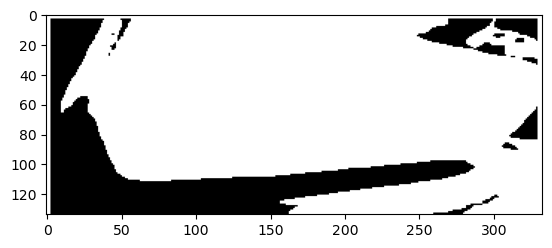

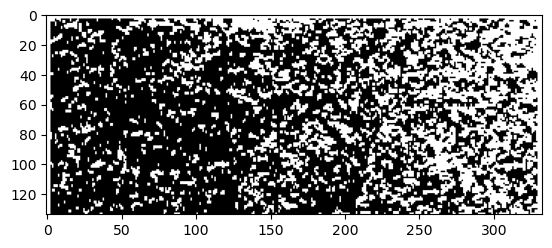

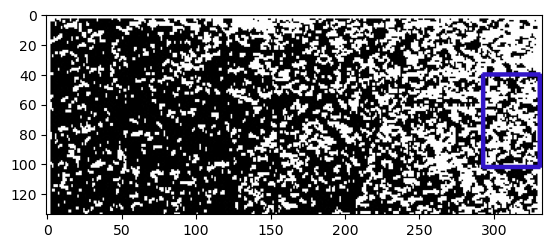

1/1 [==============================] - 0s 98ms/step


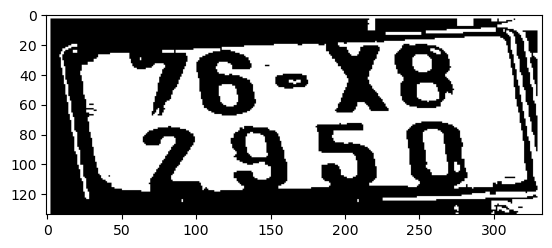

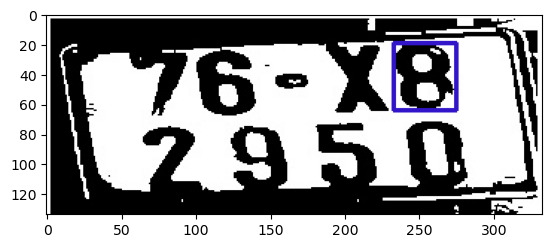

1/1 [==============================] - 0s 18ms/step


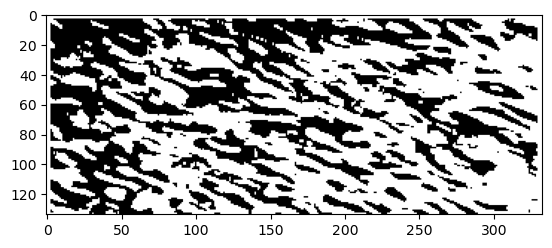

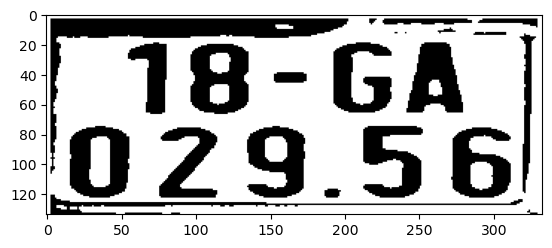

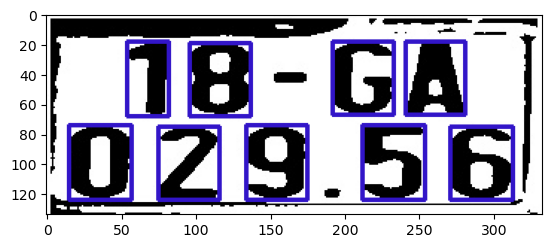

1/1 [==============================] - 0s 19ms/step


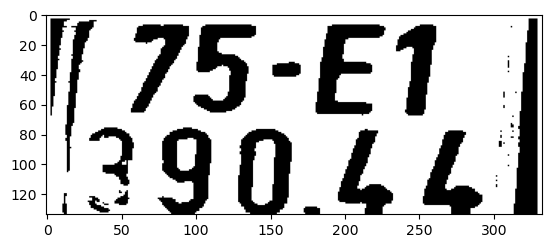

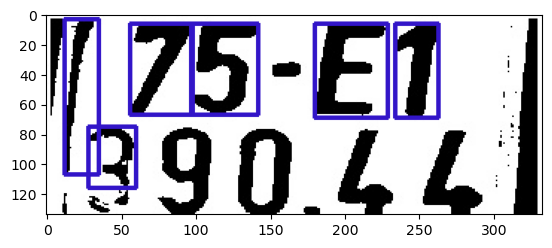

1/1 [==============================] - 0s 31ms/step


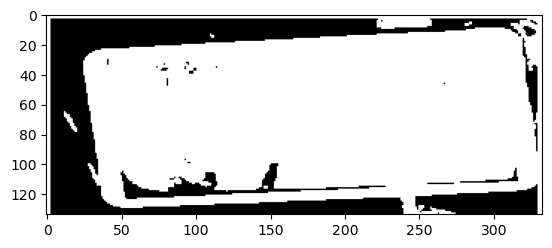

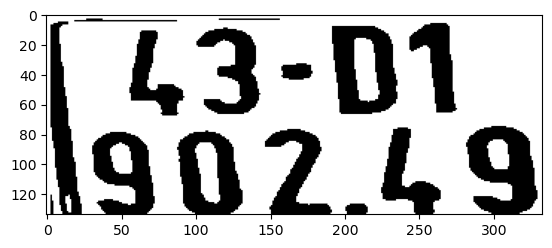

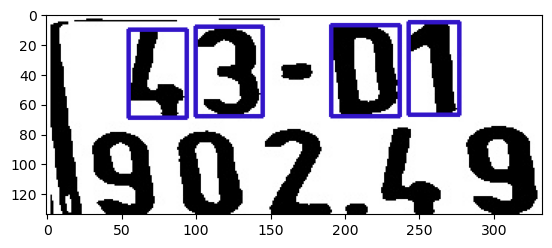

1/1 [==============================] - 0s 23ms/step


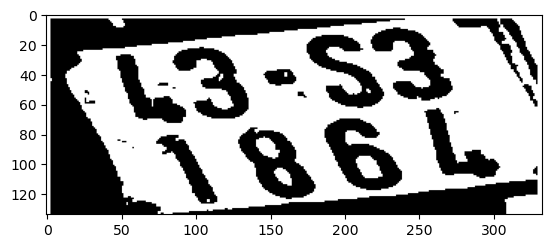

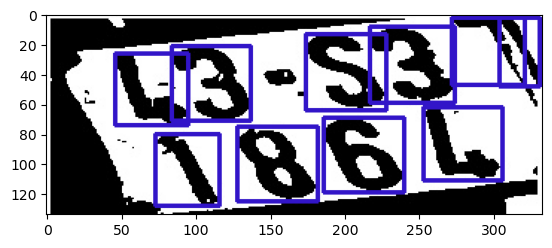

1/1 [==============================] - 0s 20ms/step


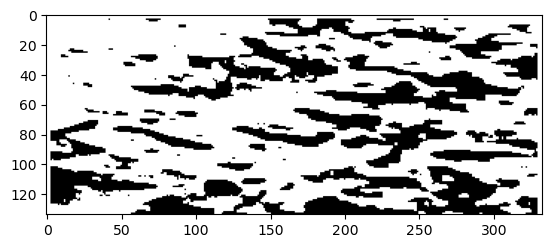

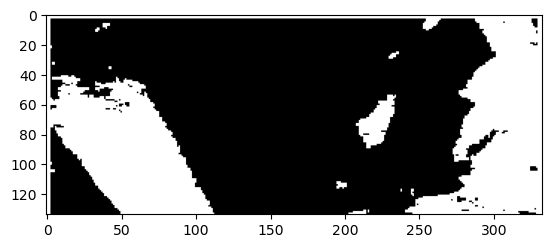

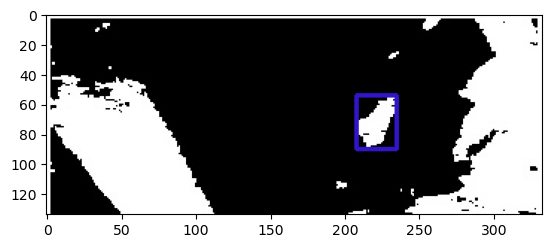

1/1 [==============================] - 0s 14ms/step


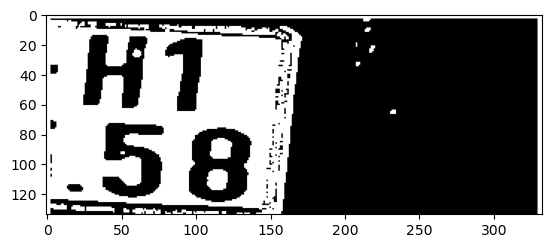

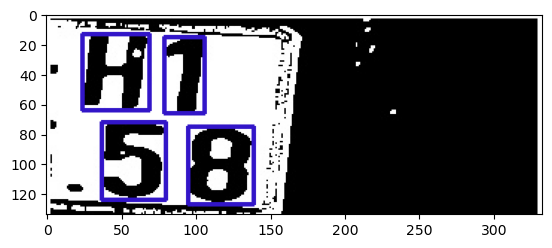

1/1 [==============================] - 0s 20ms/step


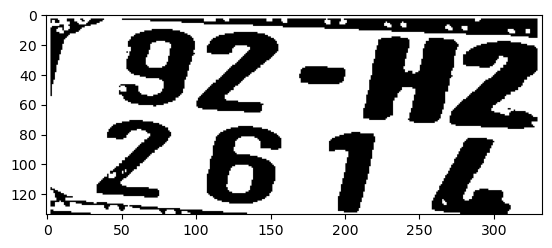

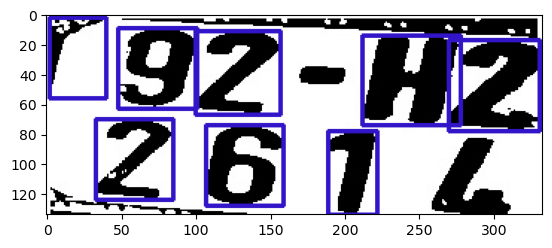

1/1 [==============================] - 0s 18ms/step


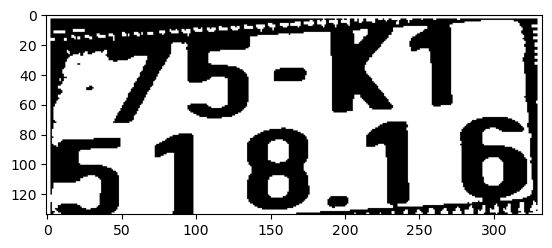

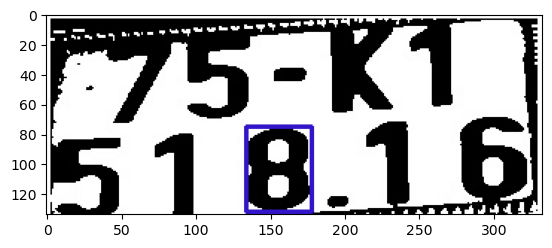

1/1 [==============================] - 0s 33ms/step


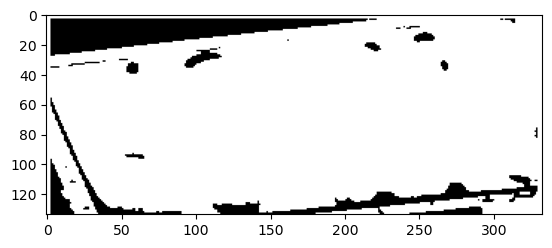

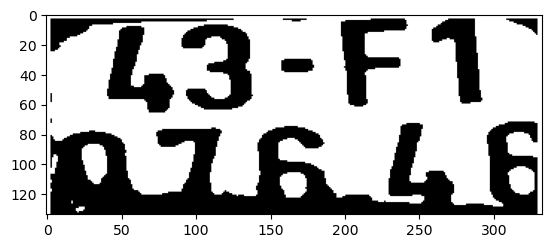

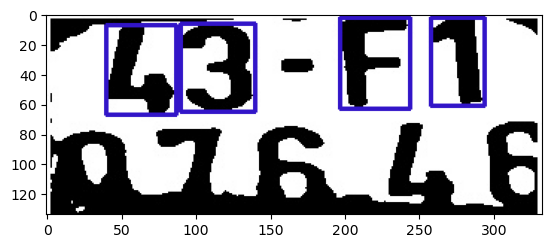

1/1 [==============================] - 0s 19ms/step


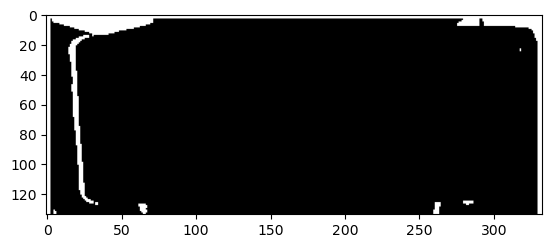

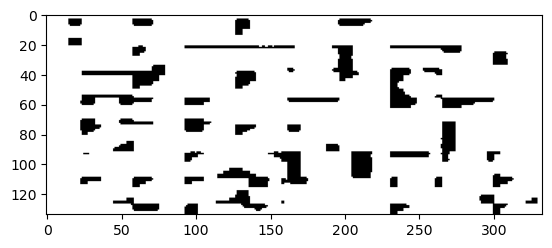

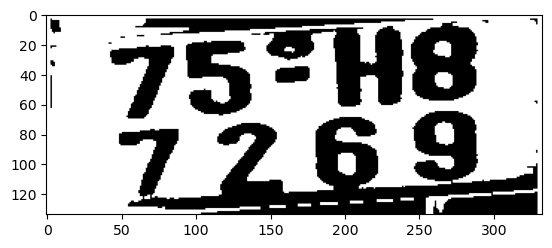

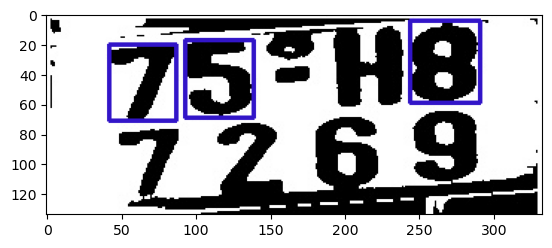

1/1 [==============================] - 0s 19ms/step


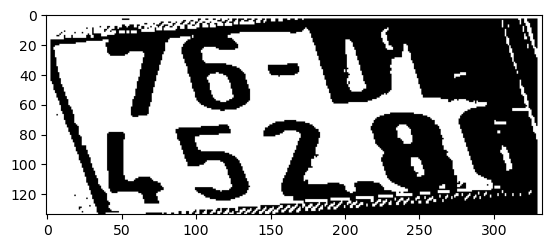

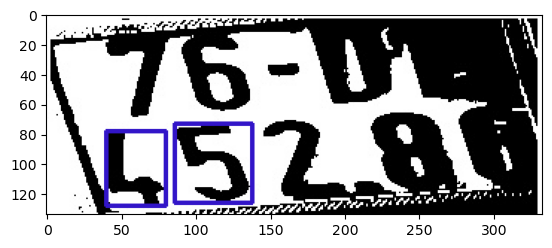

1/1 [==============================] - 0s 24ms/step


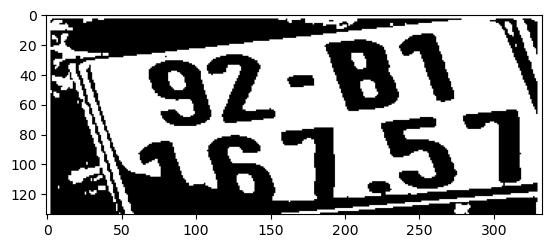

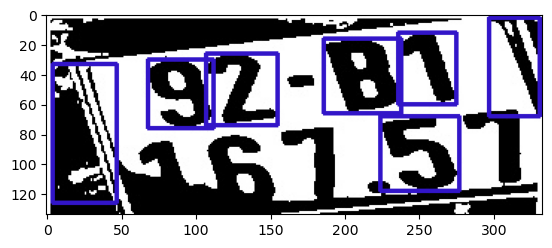

1/1 [==============================] - 0s 32ms/step


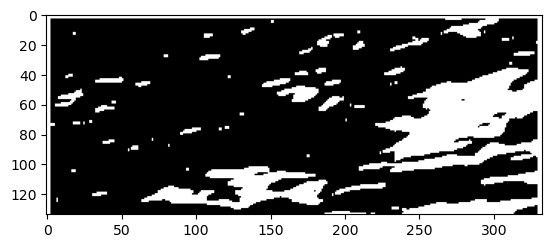

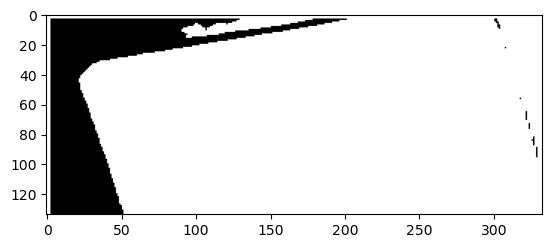

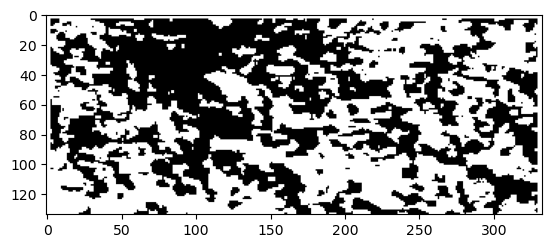

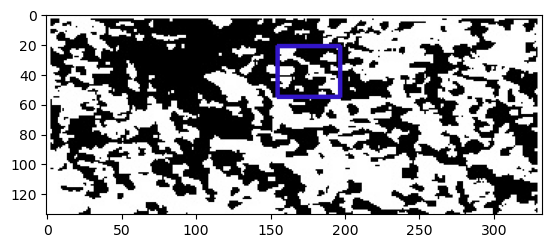

1/1 [==============================] - 0s 19ms/step


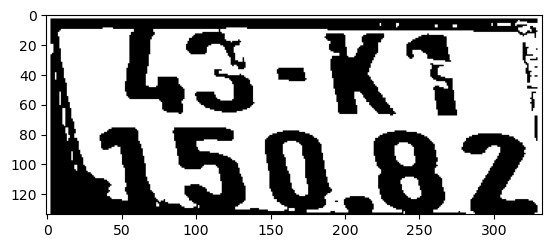

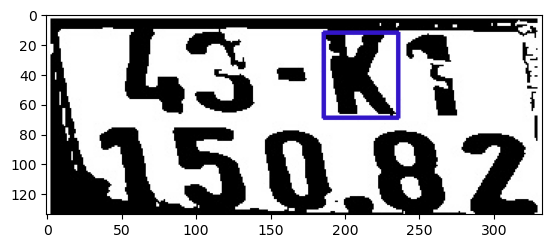

1/1 [==============================] - 0s 29ms/step


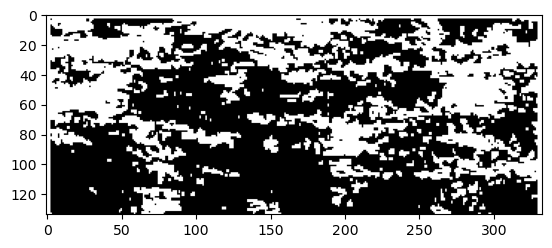

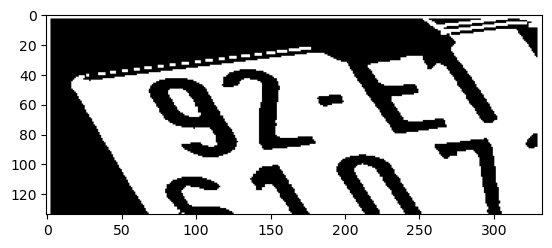

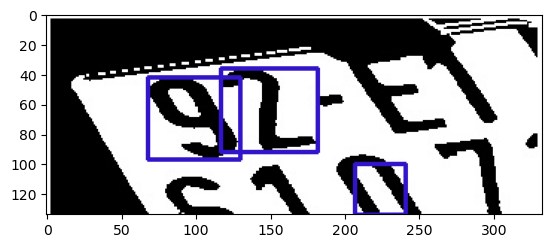

1/1 [==============================] - 0s 14ms/step


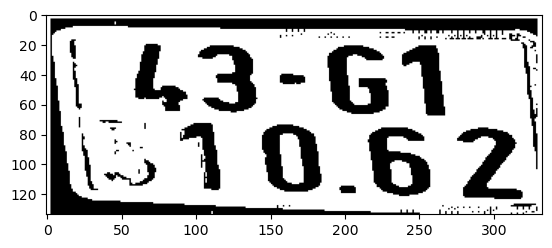

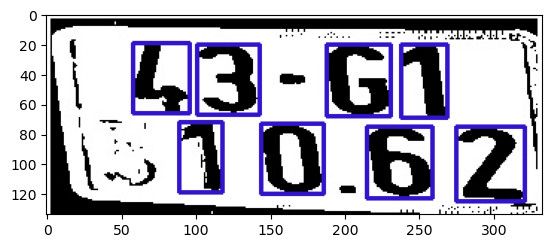

1/1 [==============================] - 0s 15ms/step


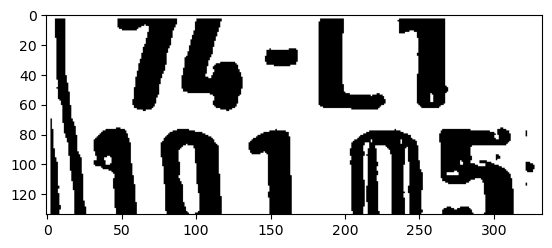

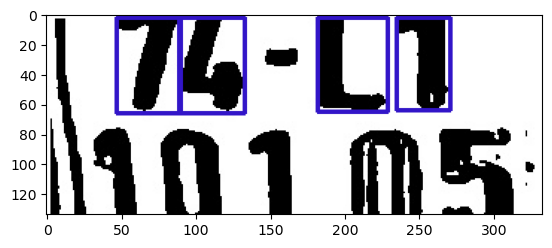

1/1 [==============================] - 0s 15ms/step


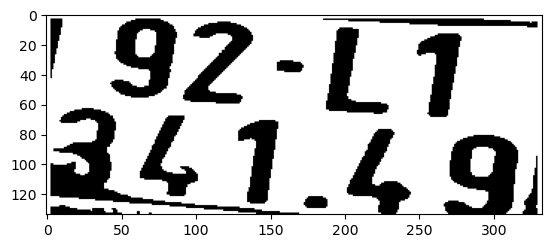

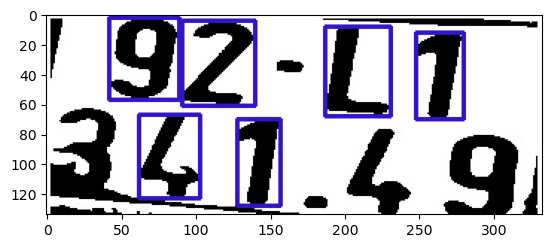

1/1 [==============================] - 0s 15ms/step


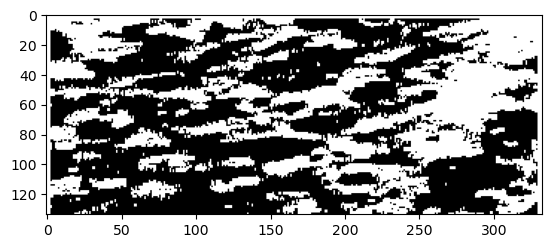

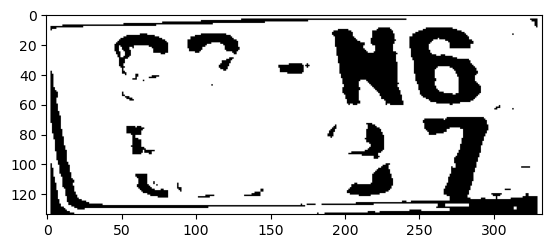

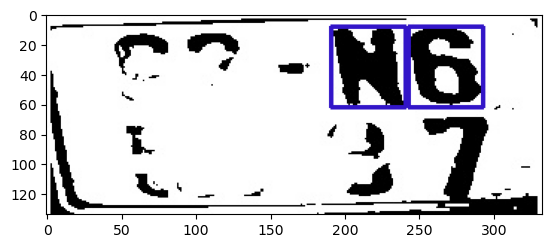

1/1 [==============================] - 0s 32ms/step


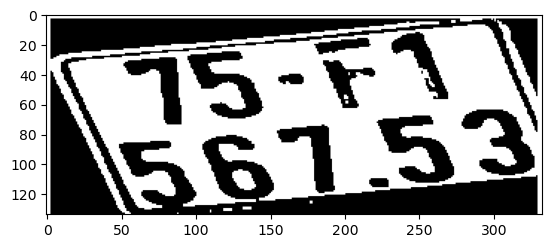

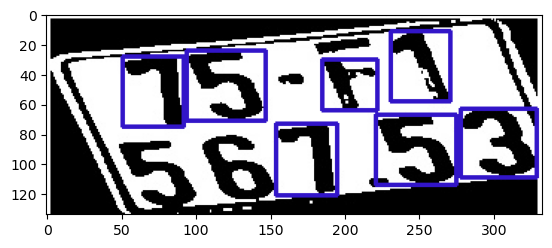

1/1 [==============================] - 0s 16ms/step


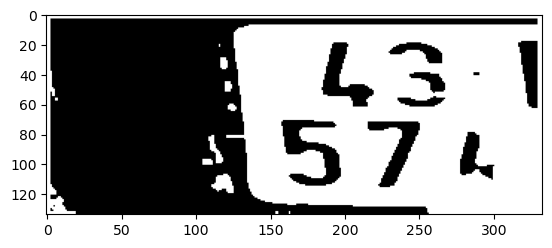

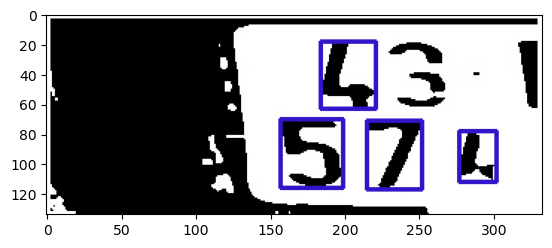

1/1 [==============================] - 0s 16ms/step


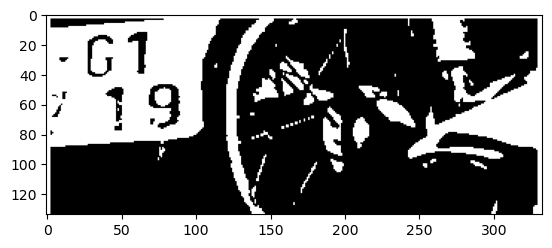

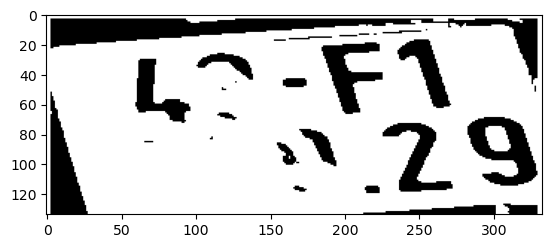

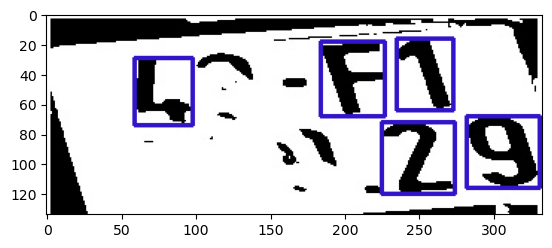

1/1 [==============================] - 0s 18ms/step


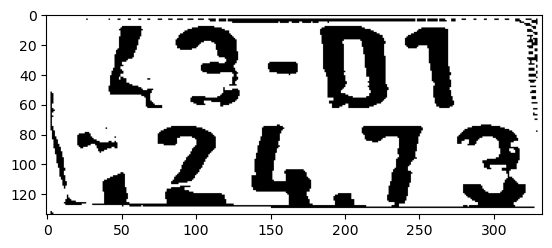

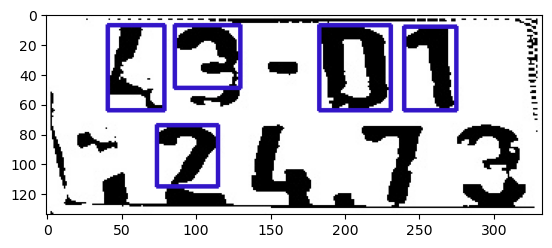

1/1 [==============================] - 0s 17ms/step


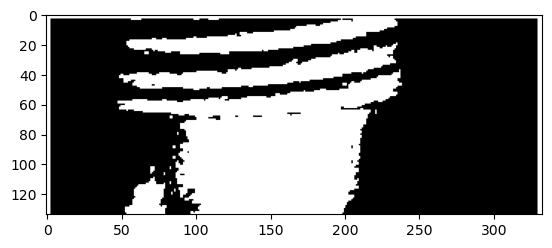

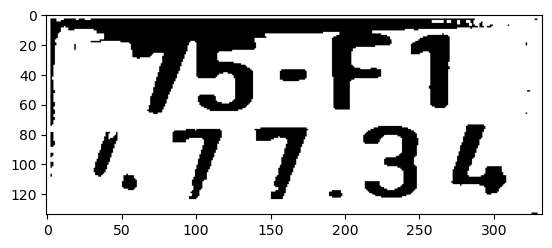

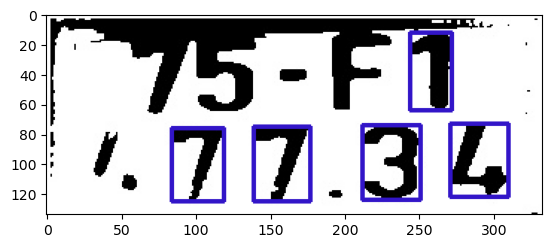

1/1 [==============================] - 0s 20ms/step


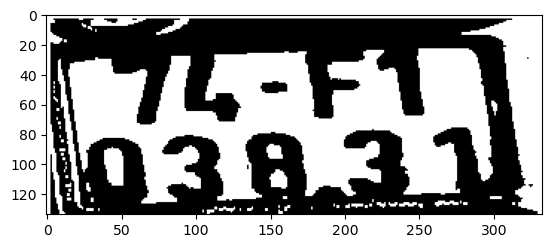

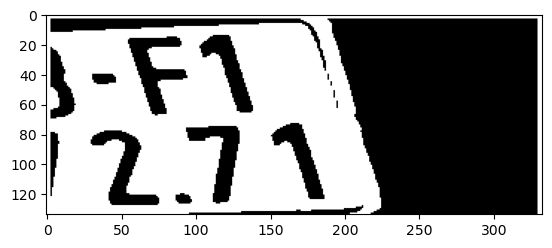

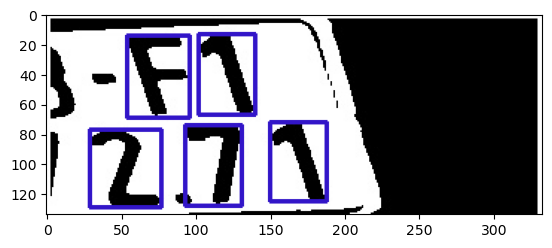

1/1 [==============================] - 0s 18ms/step


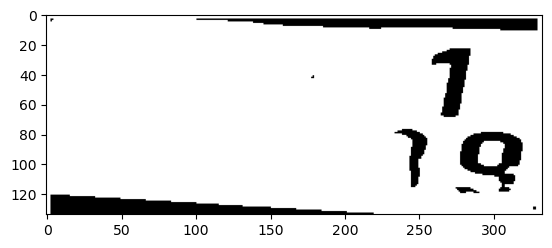

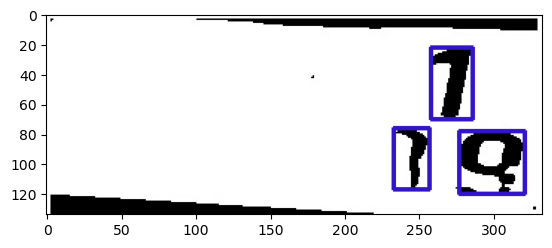

1/1 [==============================] - 0s 18ms/step


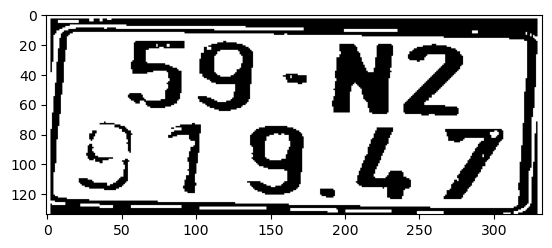

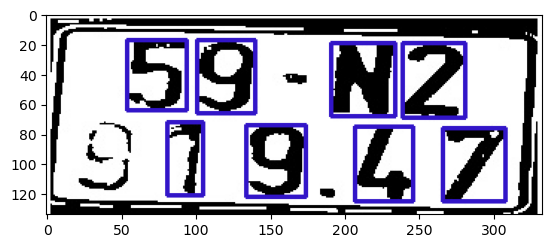

1/1 [==============================] - 0s 34ms/step


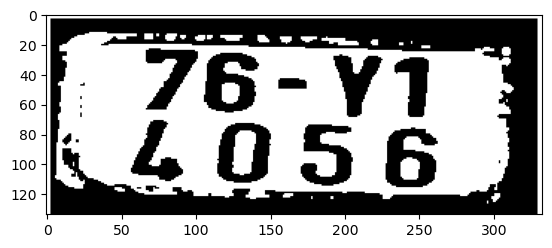

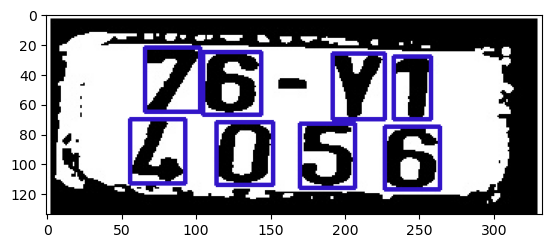

1/1 [==============================] - 0s 30ms/step


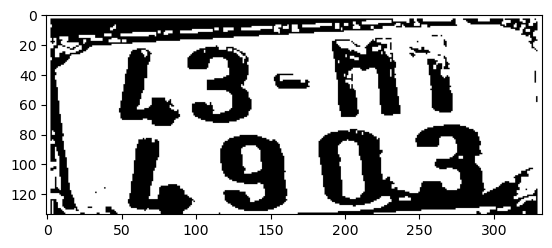

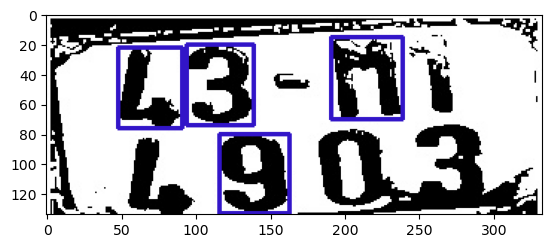

1/1 [==============================] - 0s 4ms/step


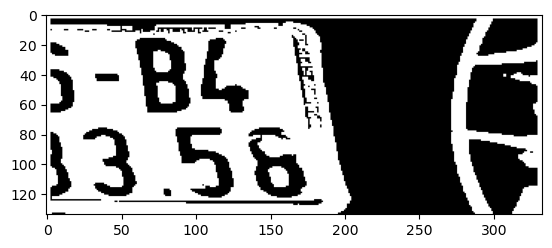

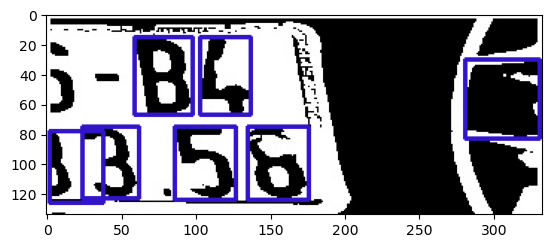

1/1 [==============================] - 0s 5ms/step


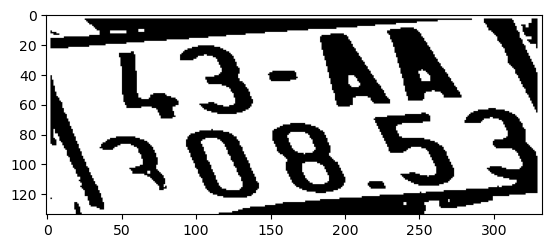

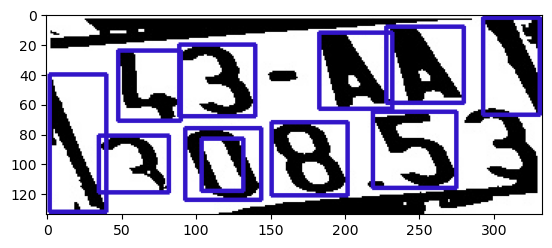

1/1 [==============================] - 0s 5ms/step


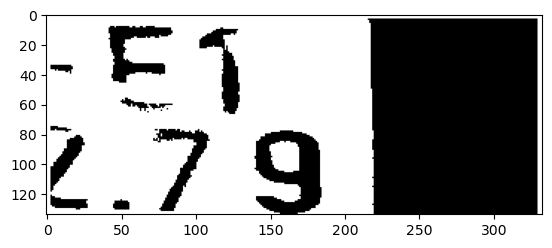

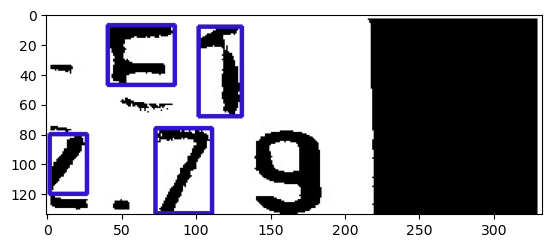

1/1 [==============================] - 0s 17ms/step


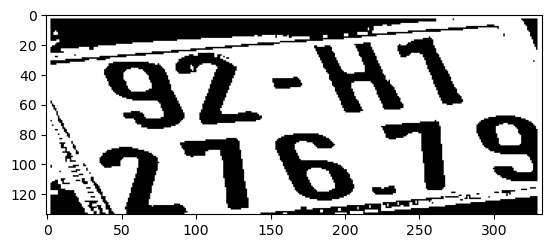

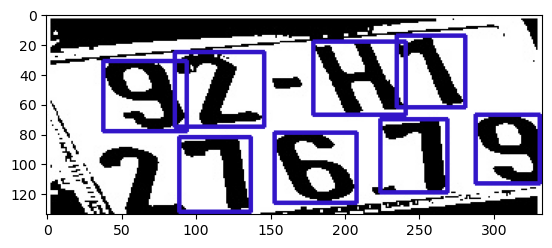

1/1 [==============================] - 0s 16ms/step


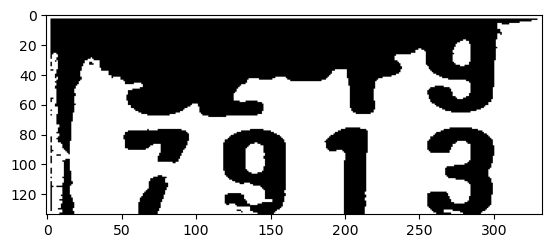

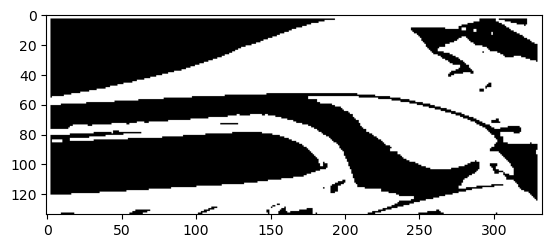

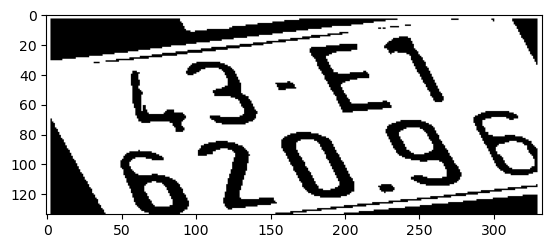

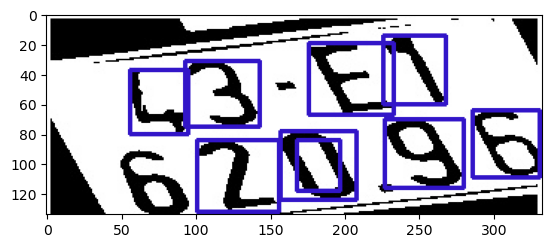

1/1 [==============================] - 0s 17ms/step


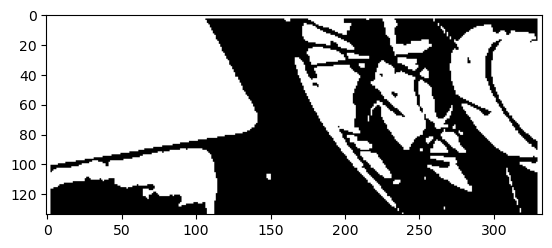

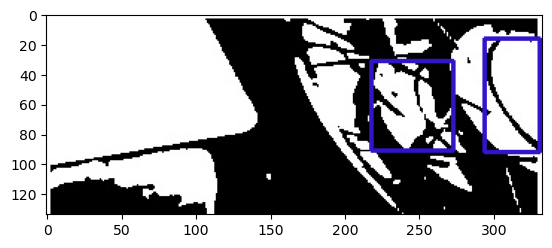

1/1 [==============================] - 0s 17ms/step


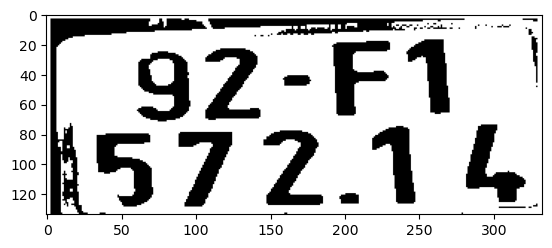

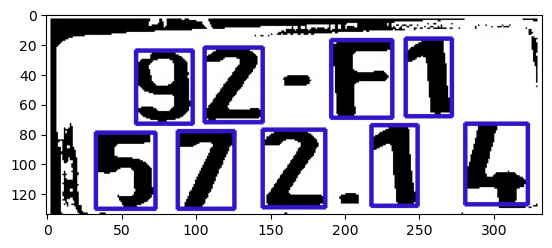

1/1 [==============================] - 0s 19ms/step


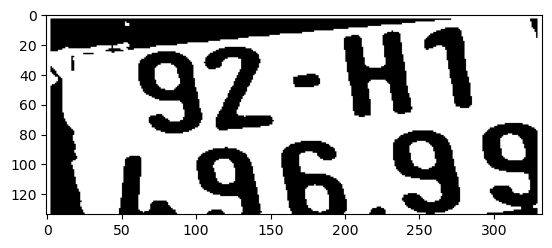

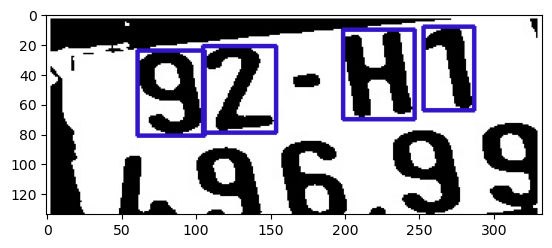

1/1 [==============================] - 0s 16ms/step


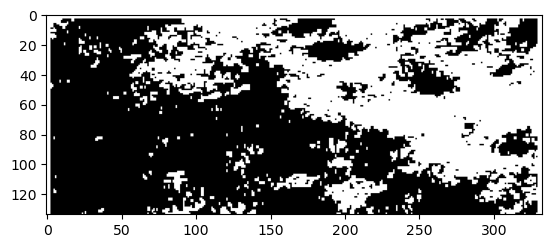

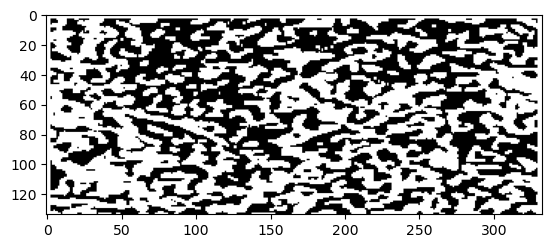

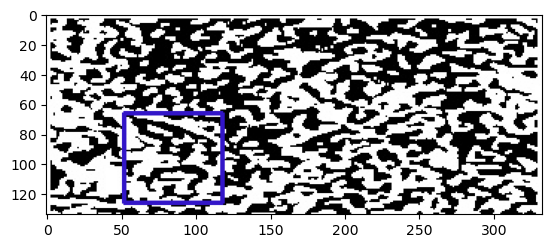

1/1 [==============================] - 0s 9ms/step


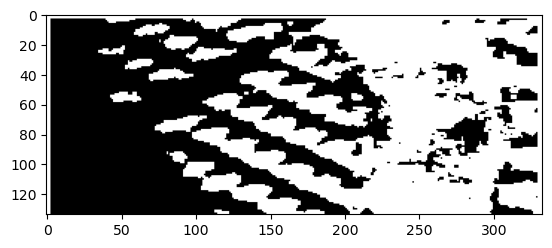

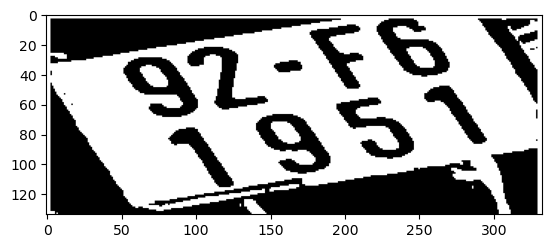

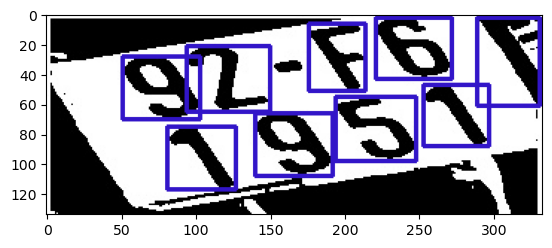

1/1 [==============================] - 0s 19ms/step


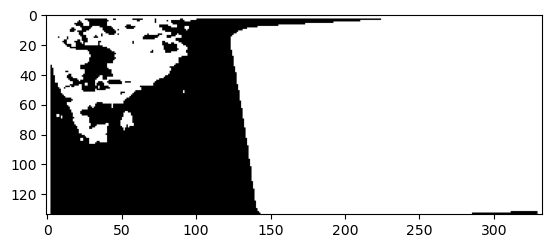

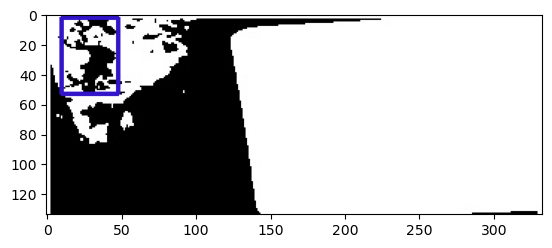

1/1 [==============================] - 0s 22ms/step


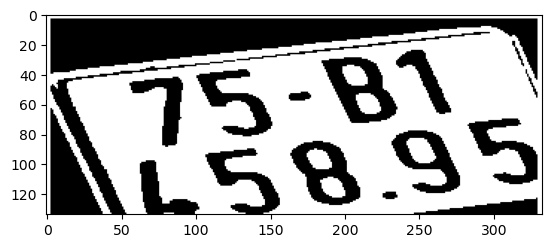

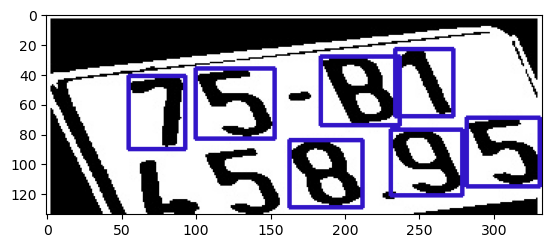

1/1 [==============================] - 0s 7ms/step


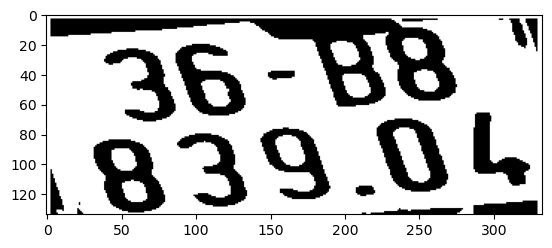

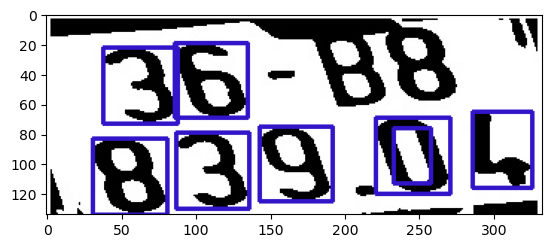

1/1 [==============================] - 0s 19ms/step


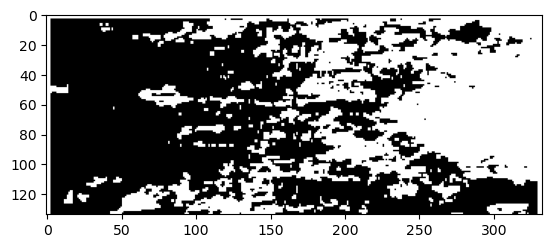

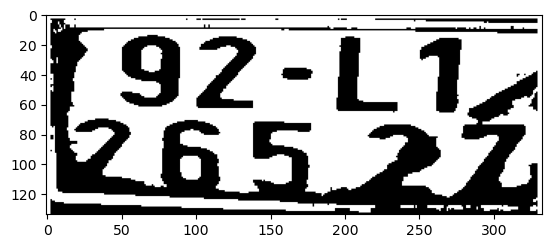

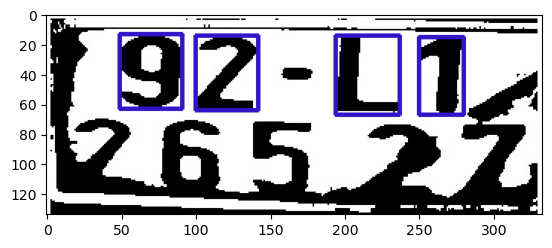

1/1 [==============================] - 0s 18ms/step


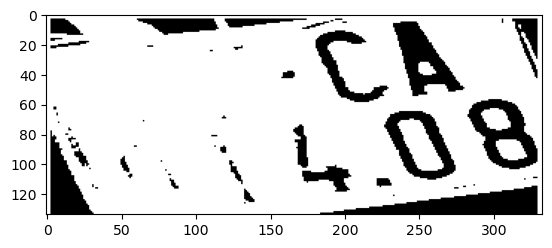

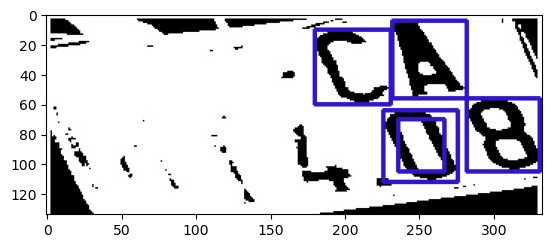

1/1 [==============================] - 0s 15ms/step


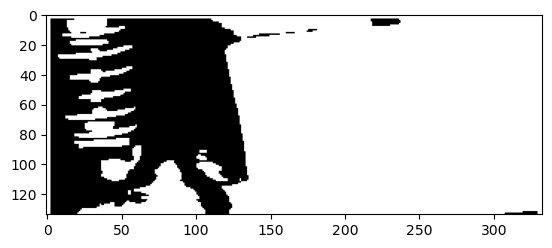

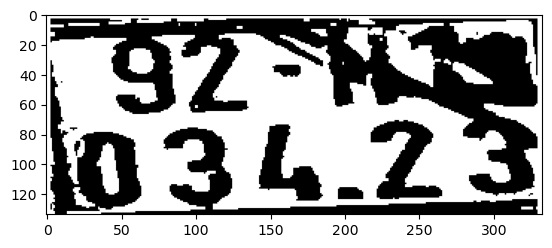

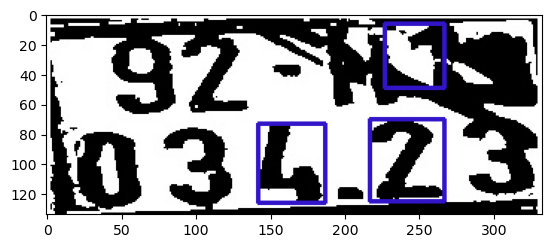

1/1 [==============================] - 0s 4ms/step


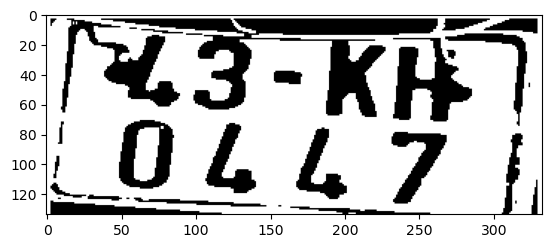

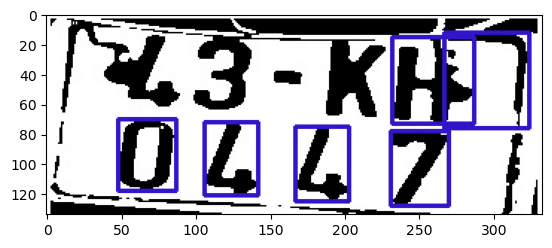

1/1 [==============================] - 0s 15ms/step


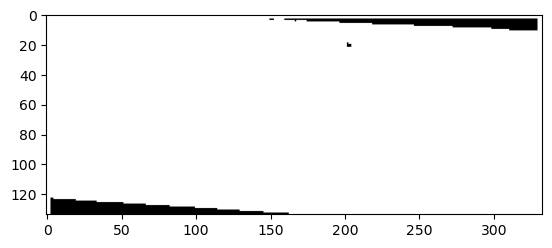

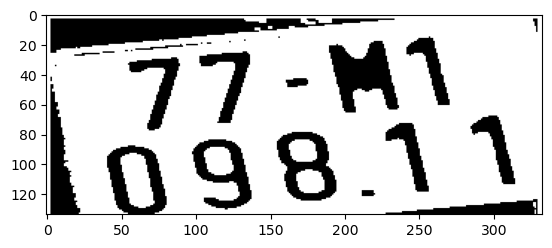

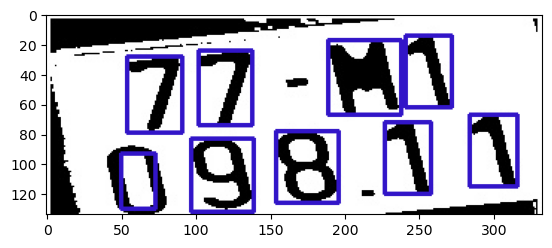

1/1 [==============================] - 0s 18ms/step


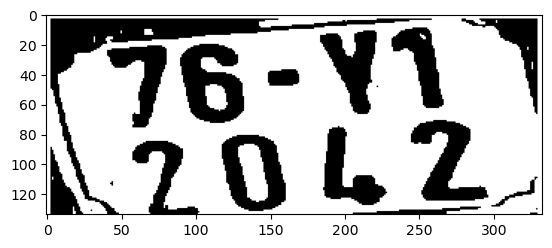

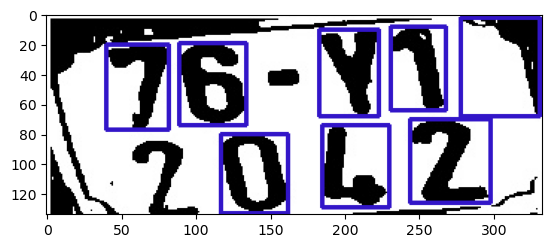

1/1 [==============================] - 0s 7ms/step


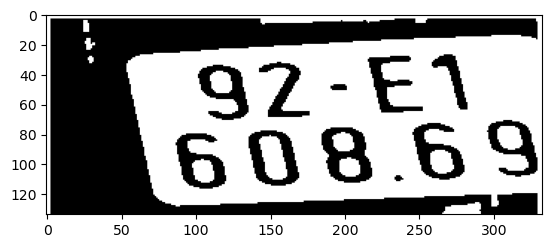

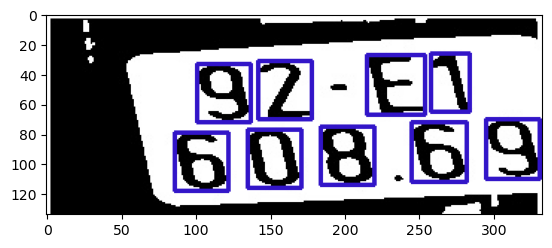

1/1 [==============================] - 0s 13ms/step


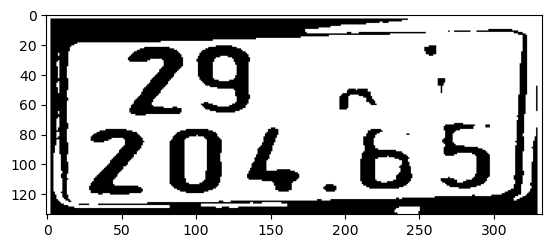

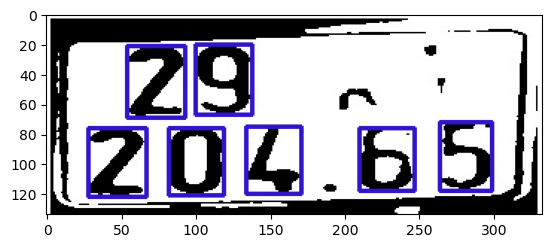

1/1 [==============================] - 0s 11ms/step


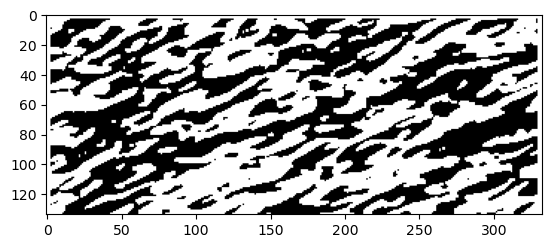

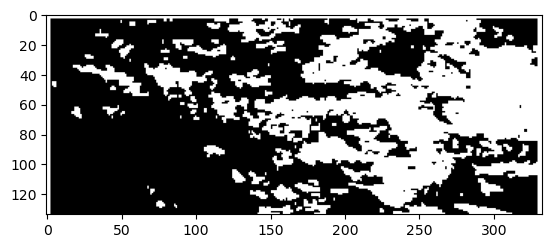

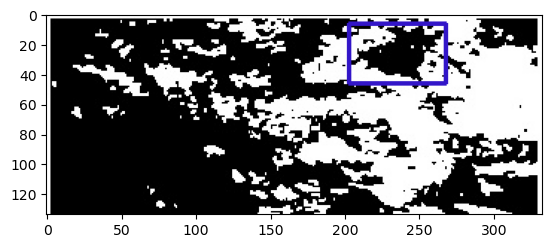

1/1 [==============================] - 0s 18ms/step


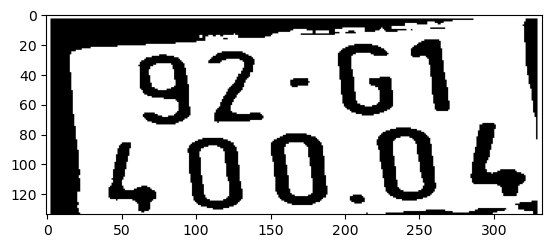

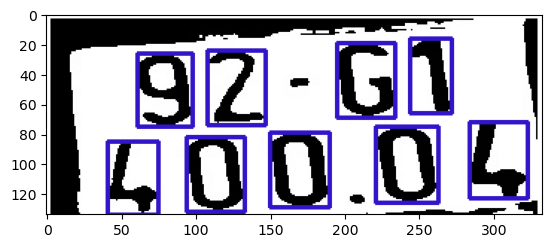

1/1 [==============================] - 0s 18ms/step


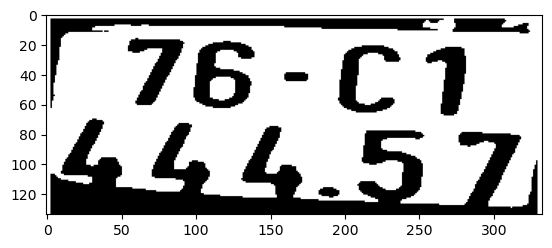

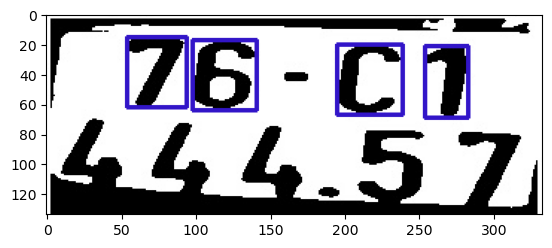

1/1 [==============================] - 0s 6ms/step


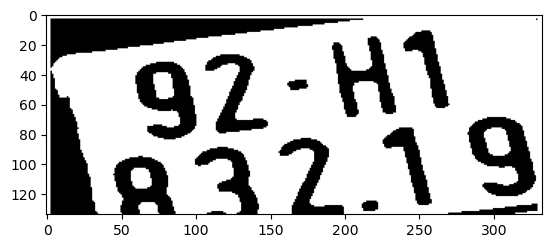

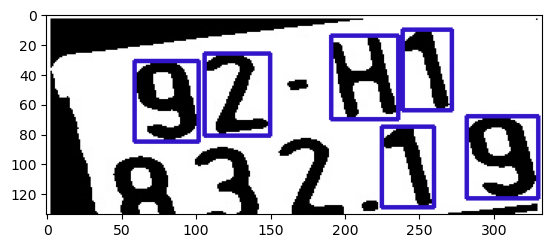

1/1 [==============================] - 0s 16ms/step


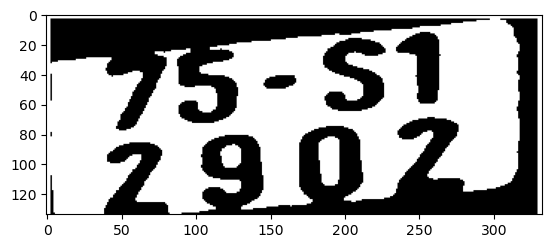

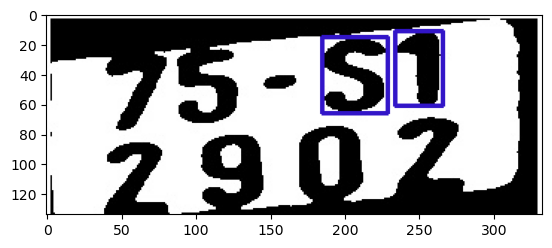

1/1 [==============================] - 0s 19ms/step


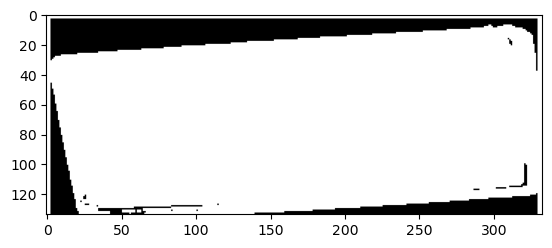

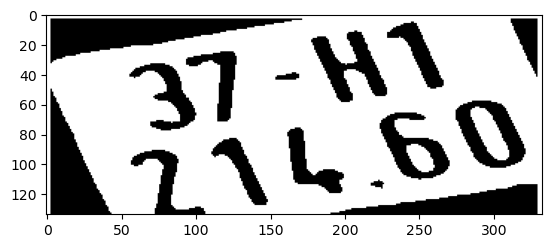

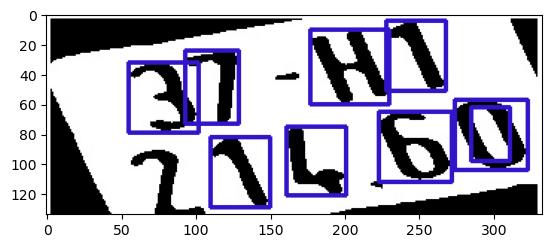

1/1 [==============================] - 0s 19ms/step


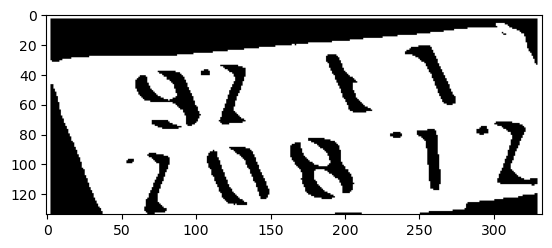

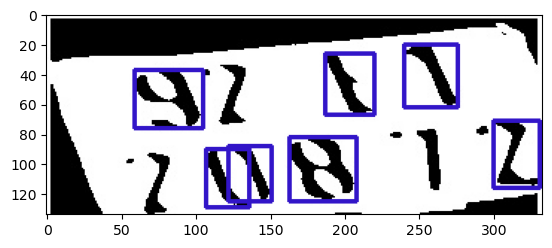

1/1 [==============================] - 0s 18ms/step


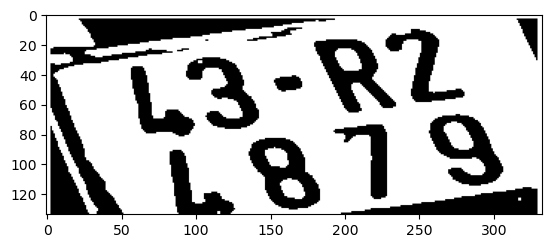

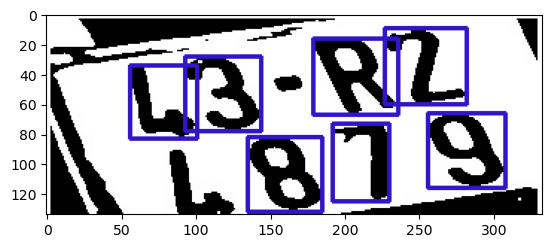

1/1 [==============================] - 0s 18ms/step


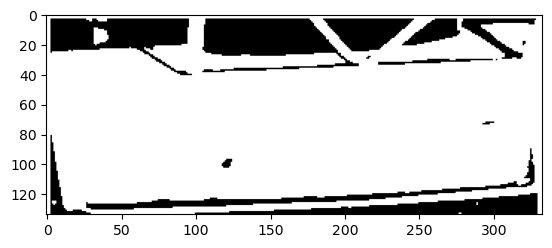

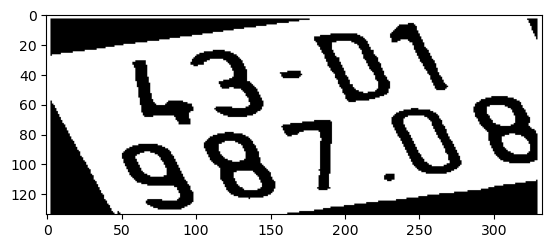

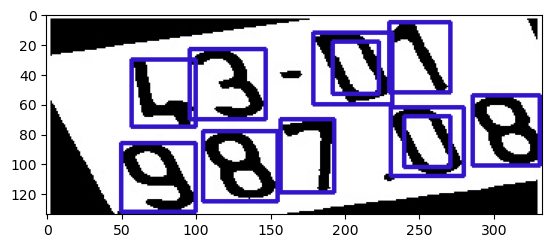

1/1 [==============================] - 0s 17ms/step


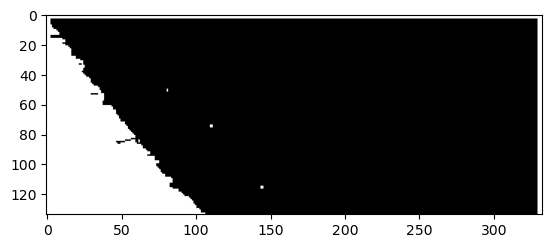

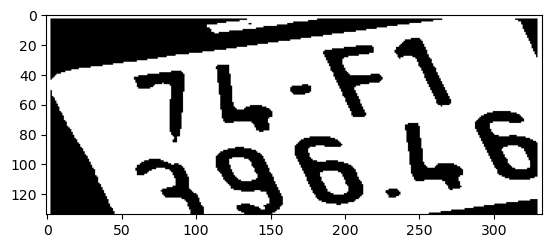

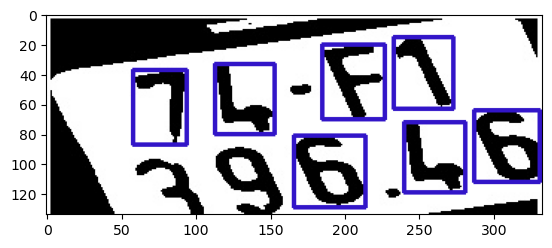

1/1 [==============================] - 0s 18ms/step


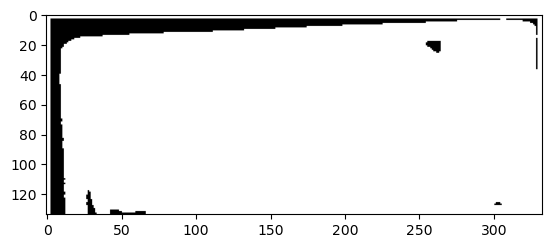

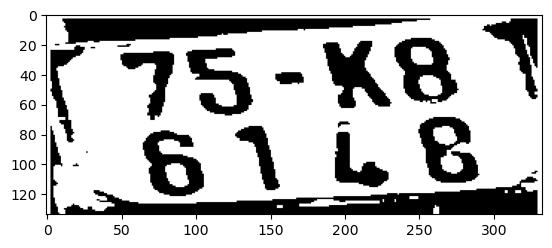

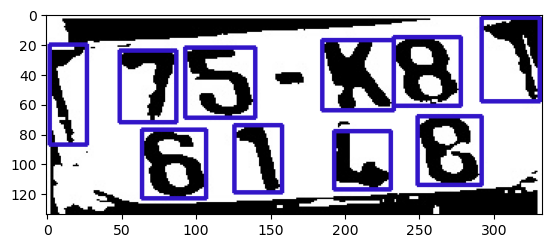

1/1 [==============================] - 0s 20ms/step


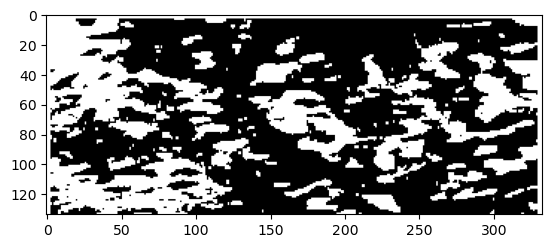

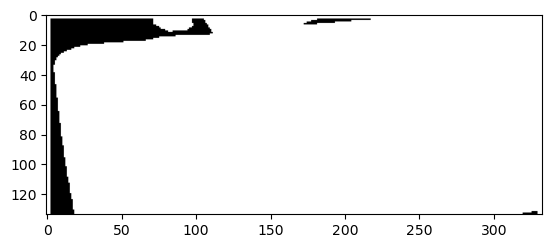

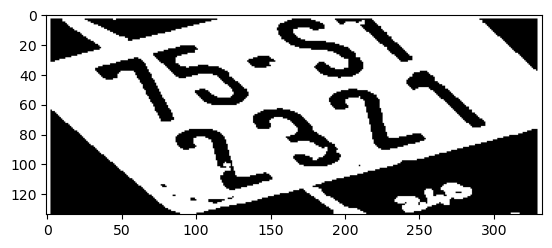

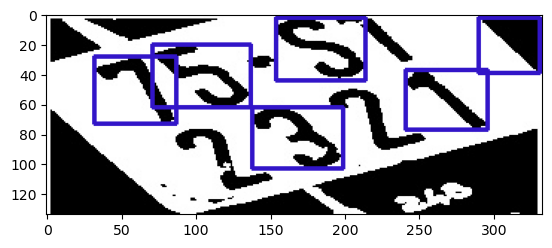

1/1 [==============================] - 0s 10ms/step


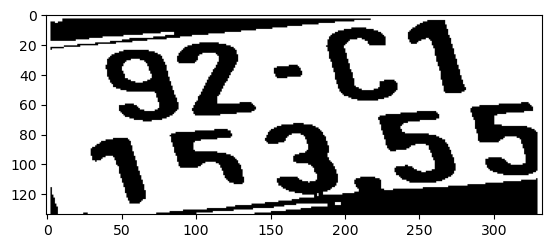

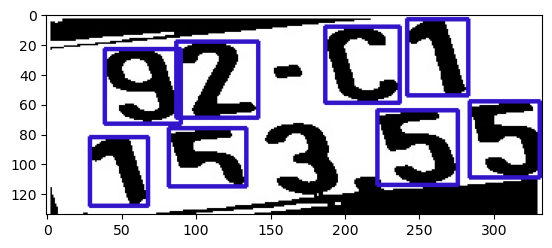

1/1 [==============================] - 0s 18ms/step


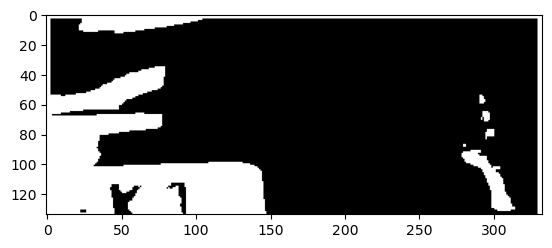

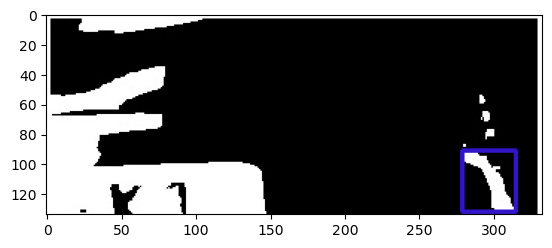

1/1 [==============================] - 0s 15ms/step


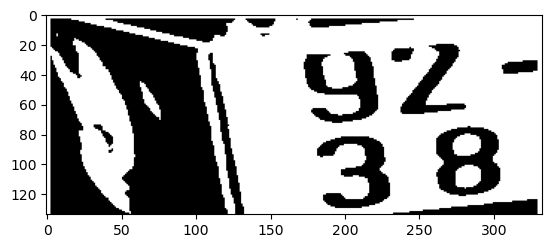

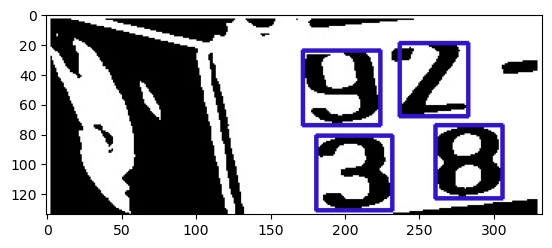

1/1 [==============================] - 0s 19ms/step


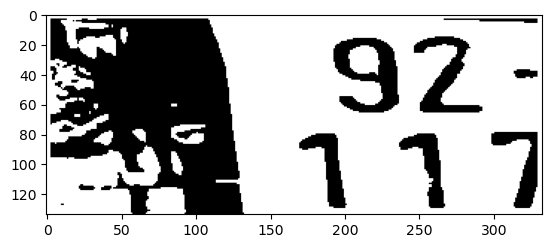

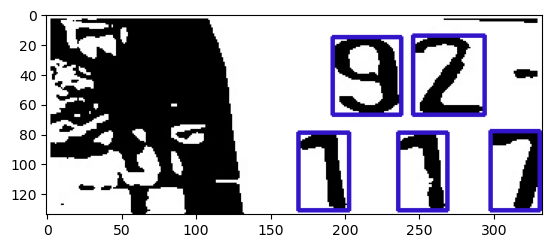

1/1 [==============================] - 0s 16ms/step


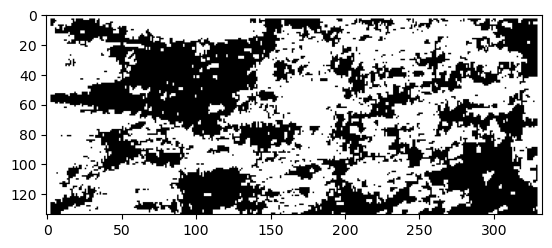

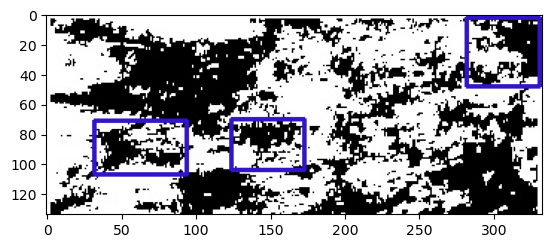

1/1 [==============================] - 0s 18ms/step


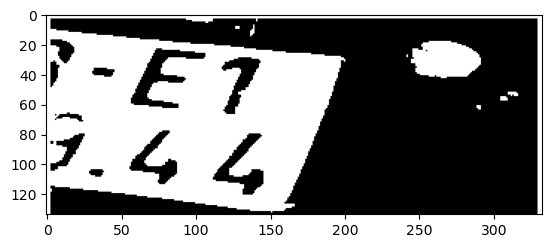

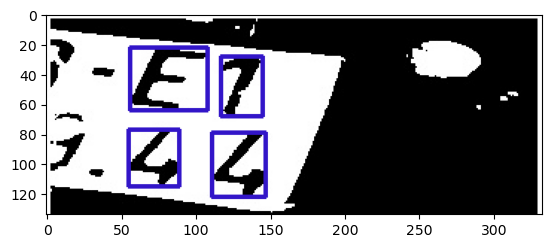

1/1 [==============================] - 0s 16ms/step


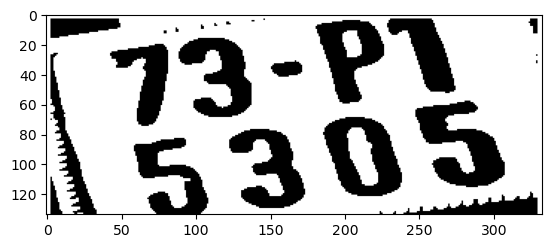

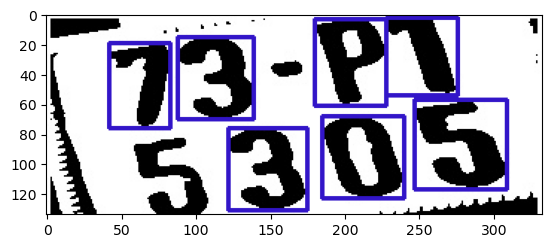

1/1 [==============================] - 0s 16ms/step


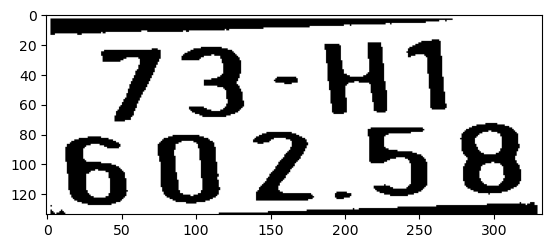

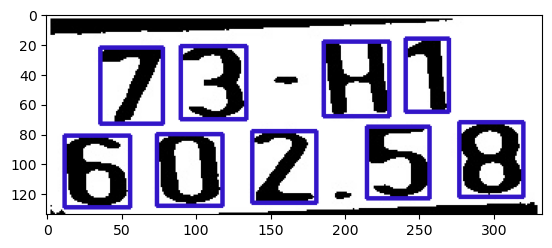

1/1 [==============================] - 0s 18ms/step


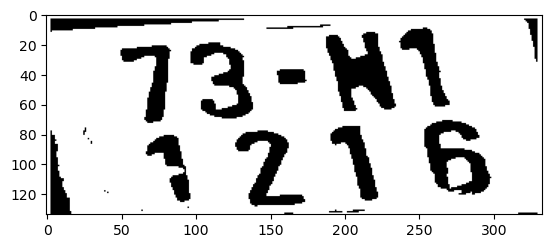

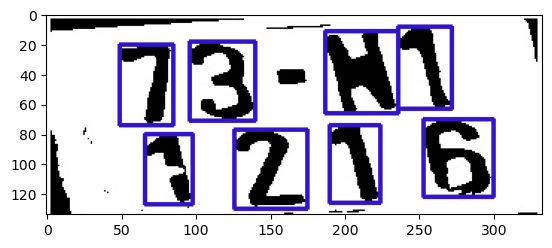

1/1 [==============================] - 0s 18ms/step


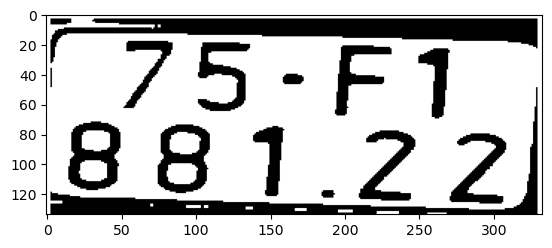

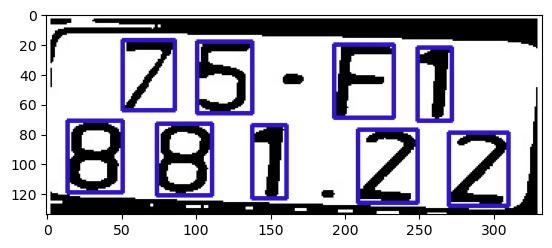

1/1 [==============================] - 0s 18ms/step


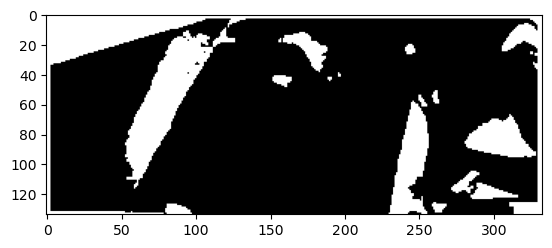

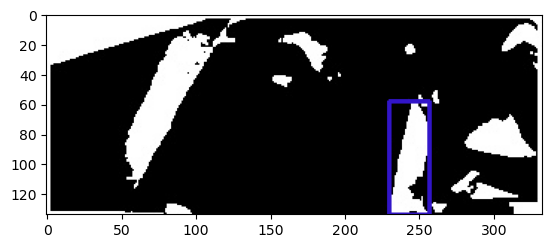

1/1 [==============================] - 0s 4ms/step


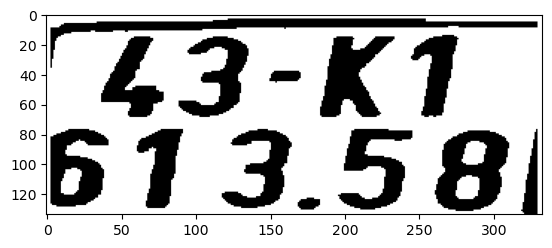

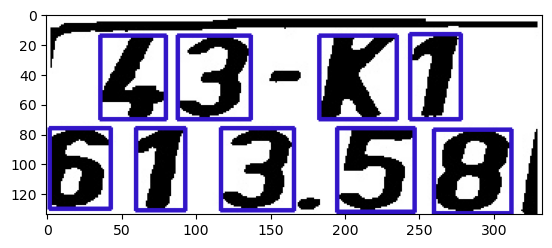

1/1 [==============================] - 0s 5ms/step


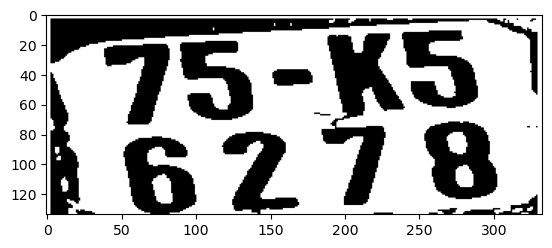

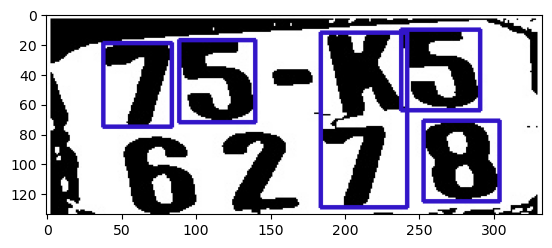

1/1 [==============================] - 0s 7ms/step


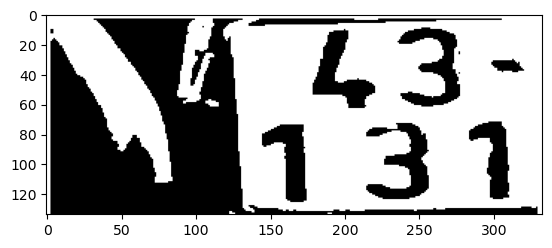

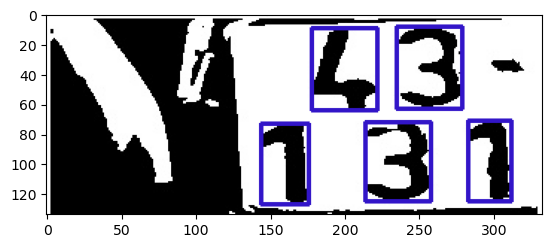

1/1 [==============================] - 0s 19ms/step


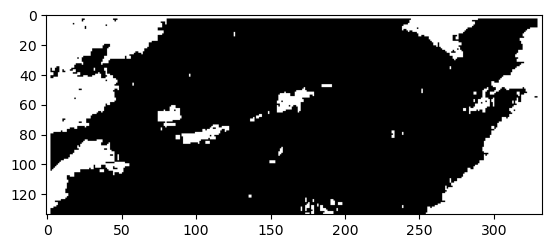

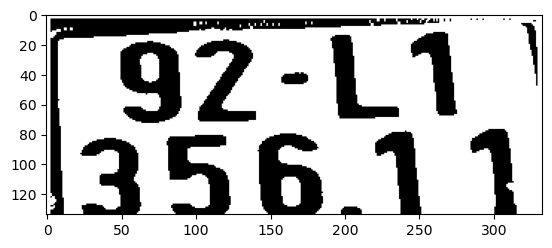

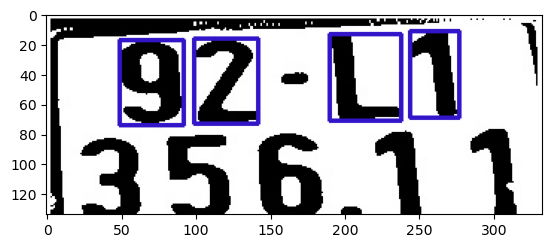

1/1 [==============================] - 0s 16ms/step


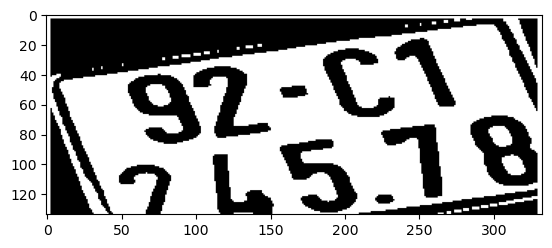

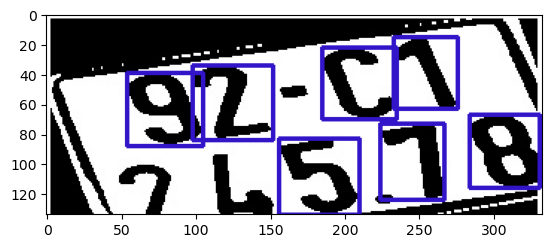

1/1 [==============================] - 0s 6ms/step


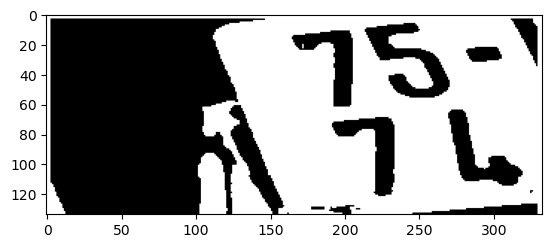

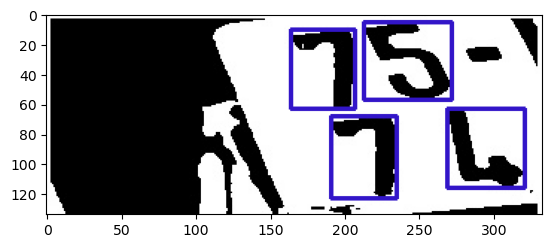

1/1 [==============================] - 0s 17ms/step


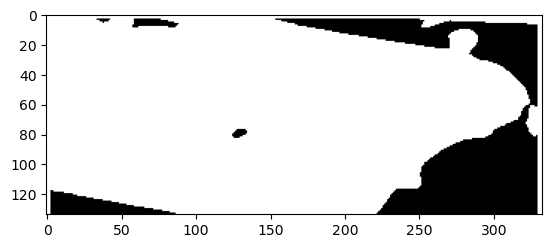

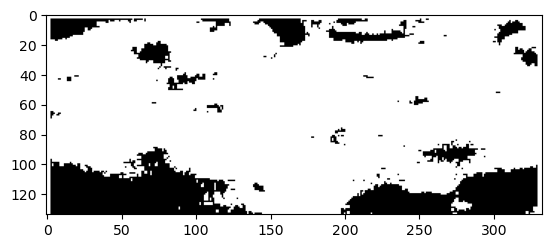

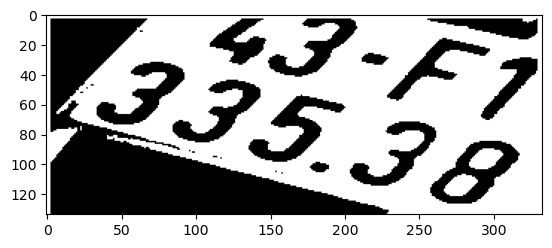

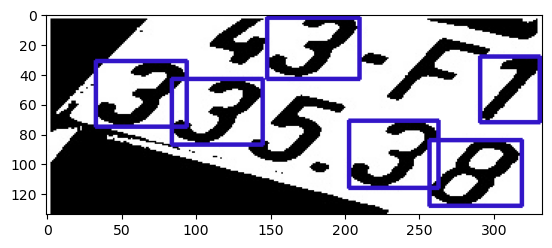

1/1 [==============================] - 0s 17ms/step


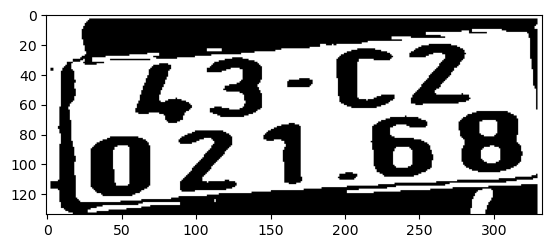

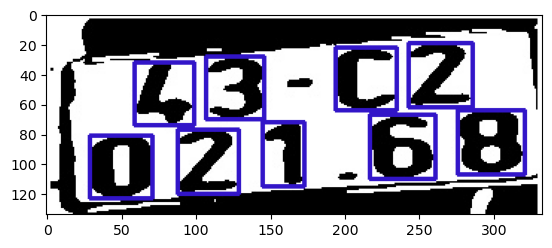

1/1 [==============================] - 0s 20ms/step


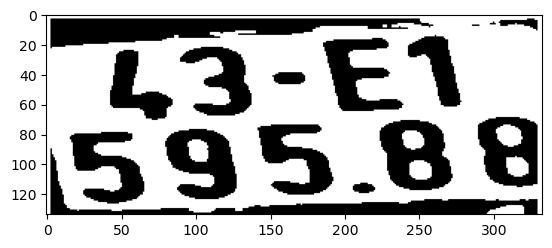

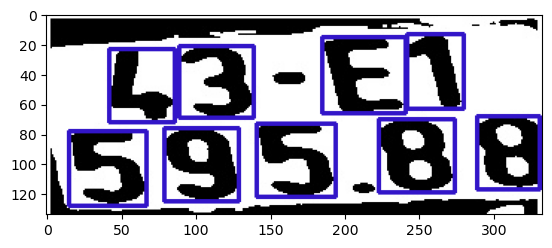

1/1 [==============================] - 0s 6ms/step


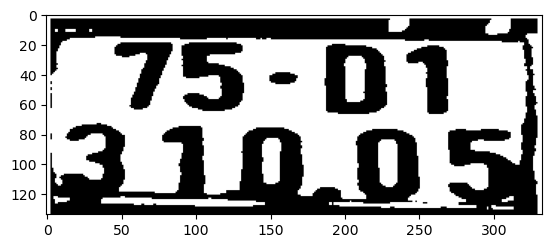

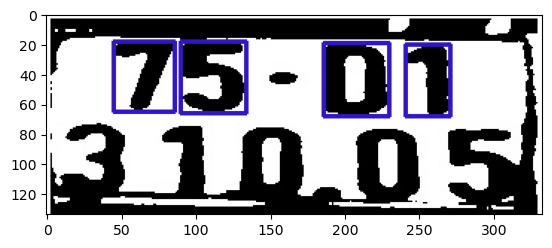

1/1 [==============================] - 0s 15ms/step


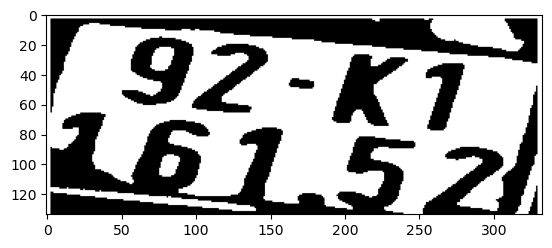

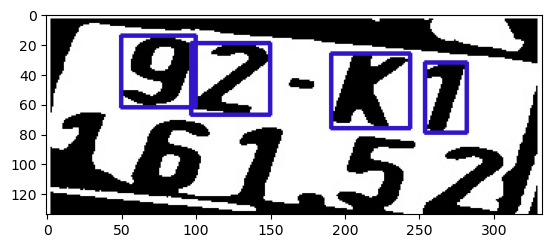

1/1 [==============================] - 0s 10ms/step


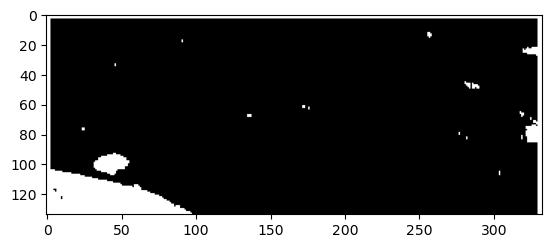

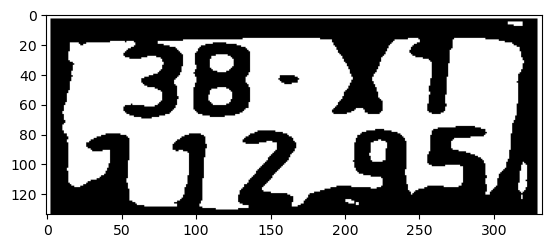

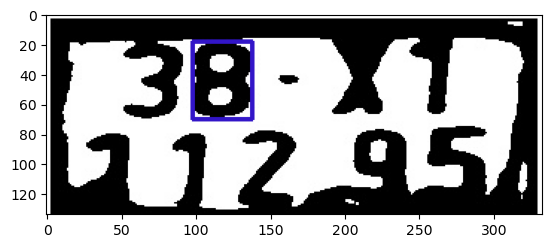

1/1 [==============================] - 0s 17ms/step


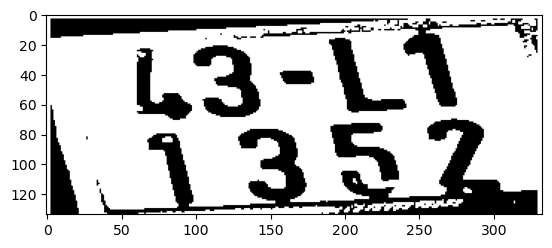

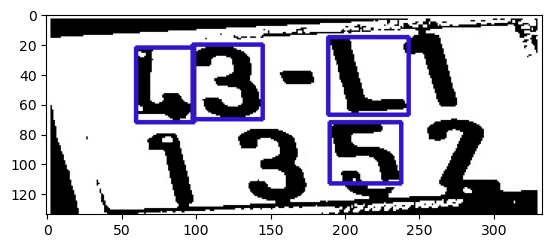

1/1 [==============================] - 0s 8ms/step


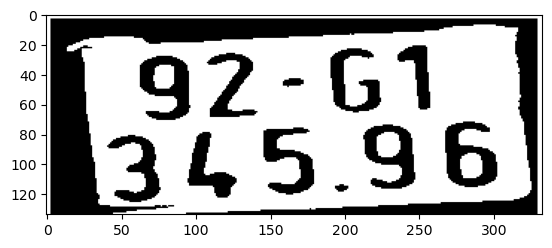

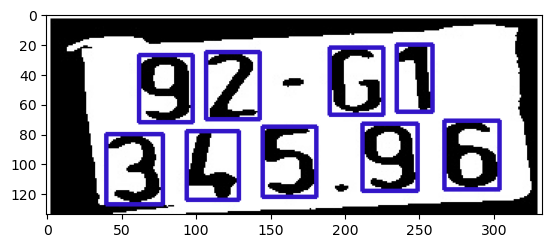

1/1 [==============================] - 0s 16ms/step


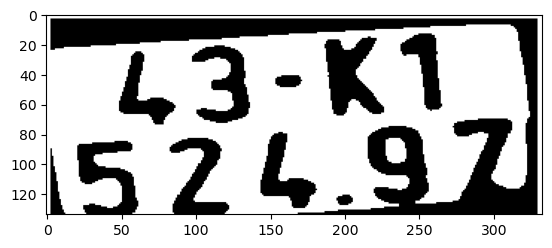

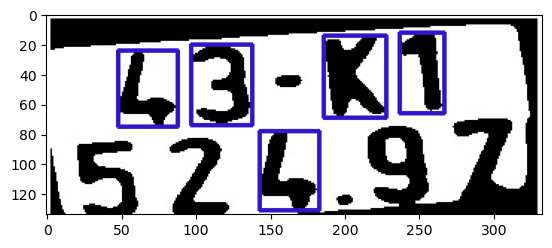

1/1 [==============================] - 0s 22ms/step


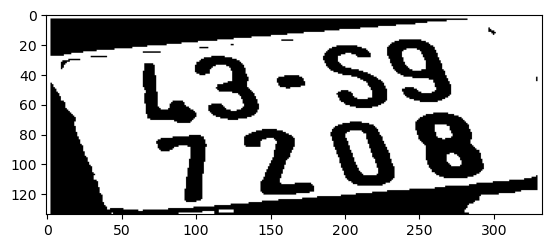

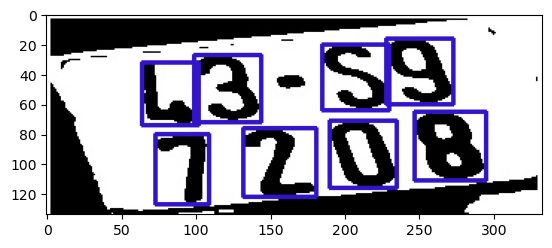

1/1 [==============================] - 0s 19ms/step


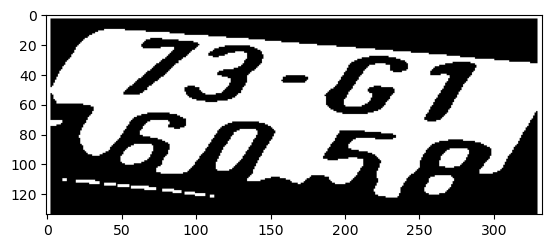

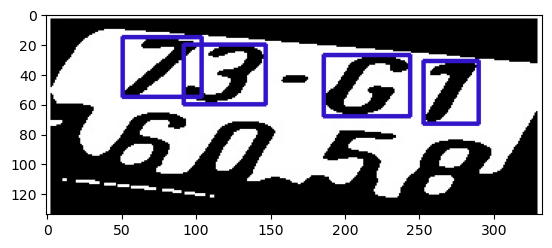

1/1 [==============================] - 0s 17ms/step


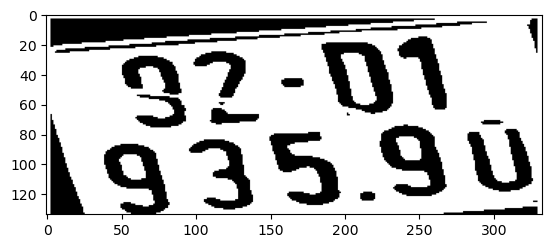

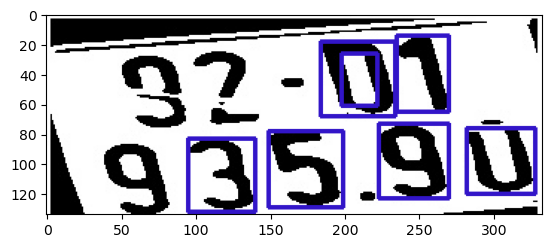

1/1 [==============================] - 0s 9ms/step


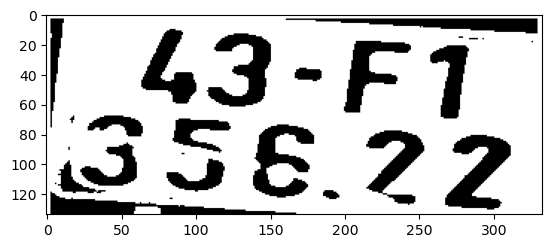

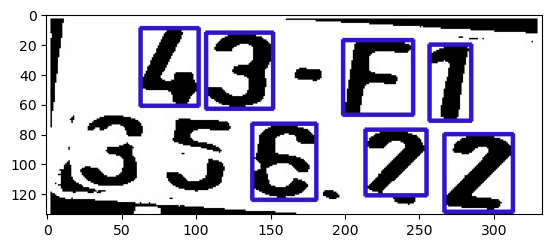

1/1 [==============================] - 0s 12ms/step


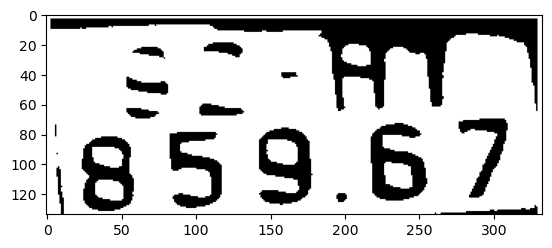

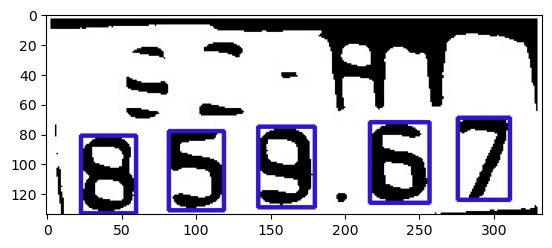

1/1 [==============================] - 0s 19ms/step


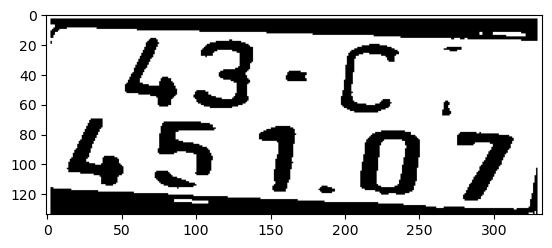

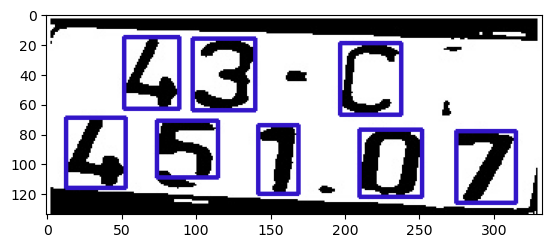

1/1 [==============================] - 0s 9ms/step


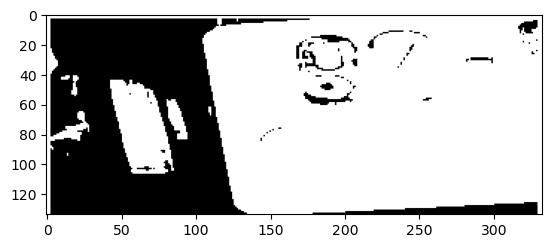

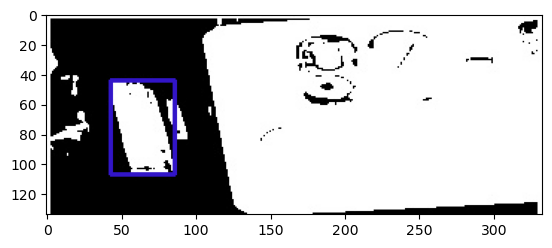

1/1 [==============================] - 0s 16ms/step


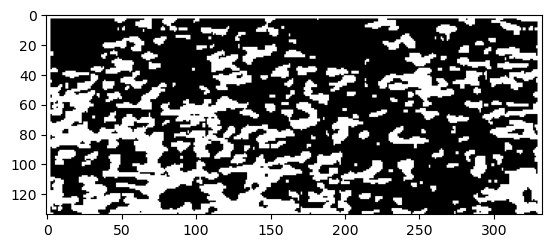

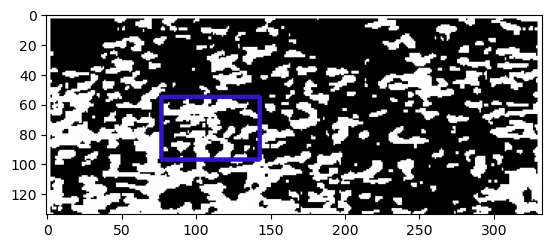

1/1 [==============================] - 0s 9ms/step


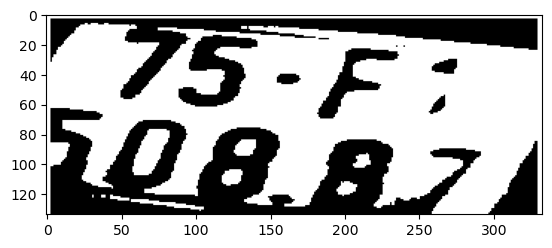

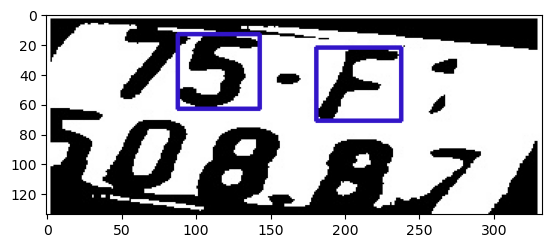

1/1 [==============================] - 0s 20ms/step


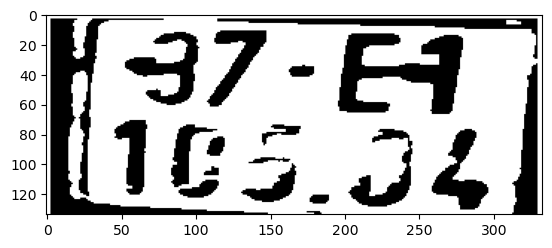

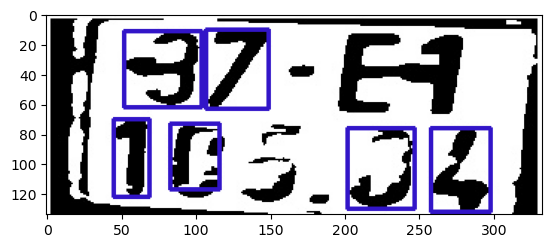

1/1 [==============================] - 0s 9ms/step


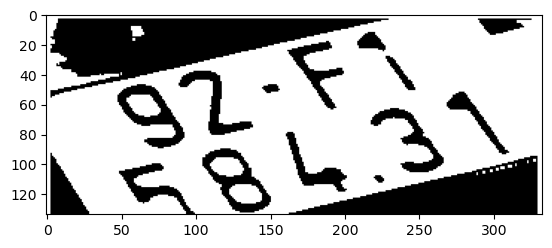

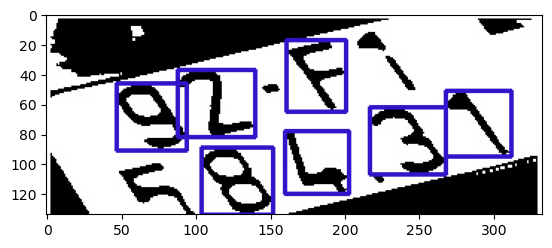

1/1 [==============================] - 0s 19ms/step


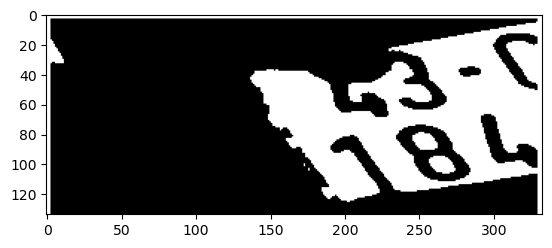

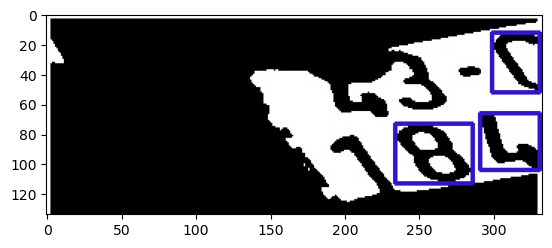

1/1 [==============================] - 0s 21ms/step


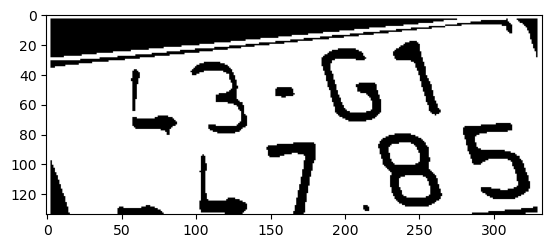

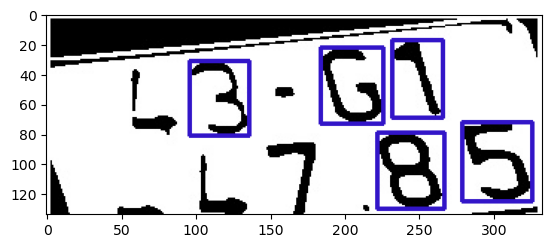

1/1 [==============================] - 0s 16ms/step


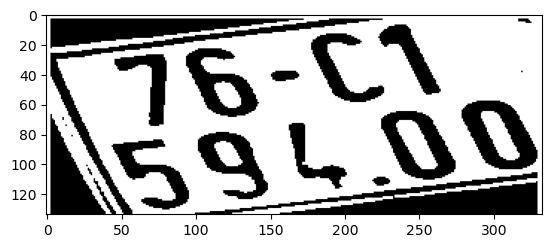

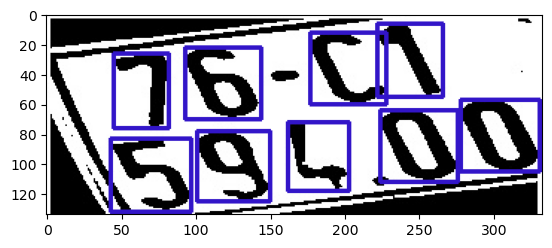

1/1 [==============================] - 0s 11ms/step


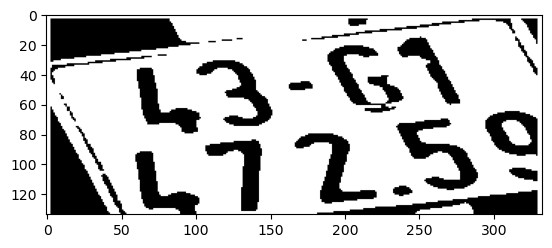

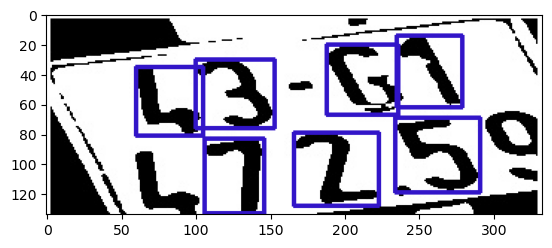

1/1 [==============================] - 0s 17ms/step


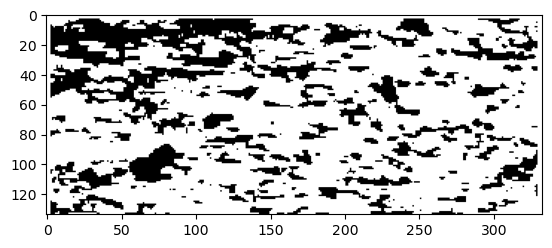

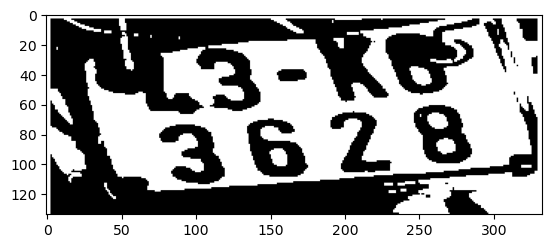

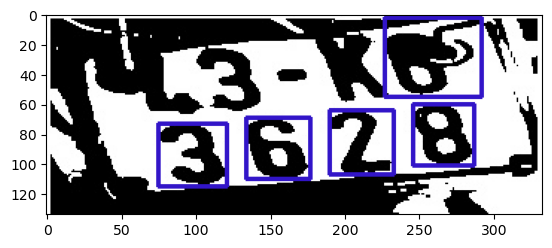

1/1 [==============================] - 0s 12ms/step


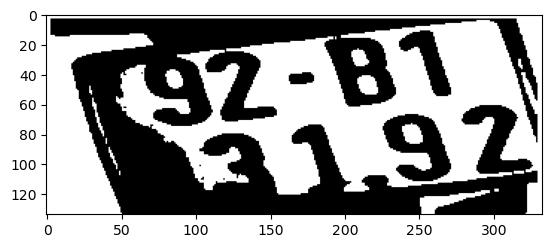

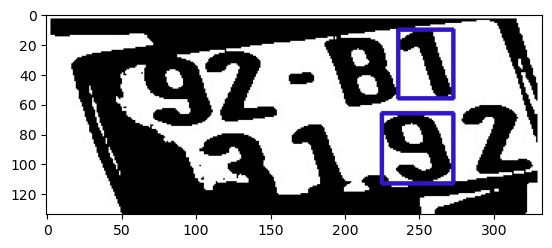

1/1 [==============================] - 0s 19ms/step


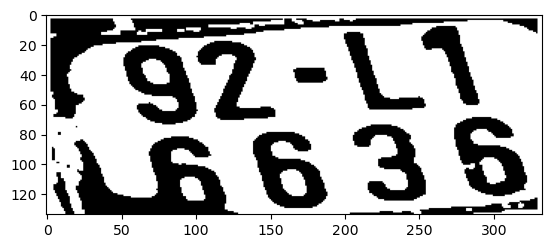

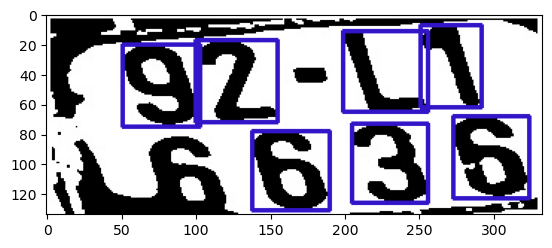

1/1 [==============================] - 0s 19ms/step


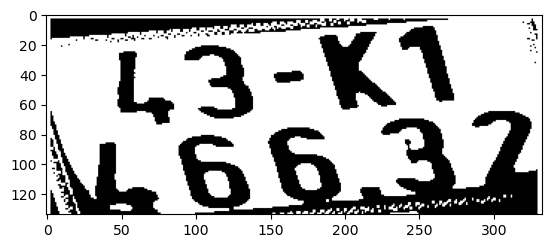

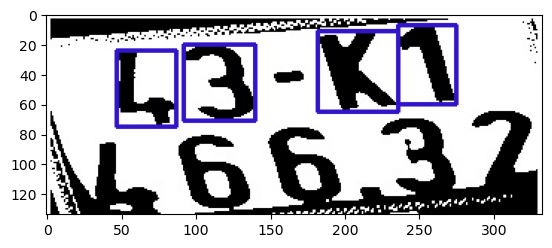

1/1 [==============================] - 0s 6ms/step


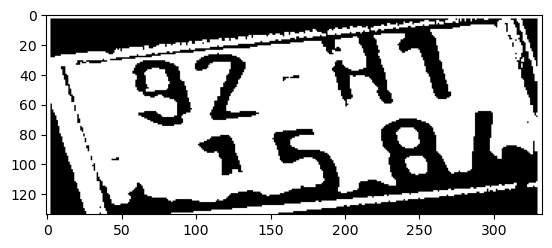

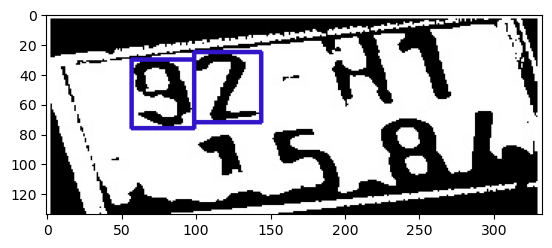

1/1 [==============================] - 0s 21ms/step


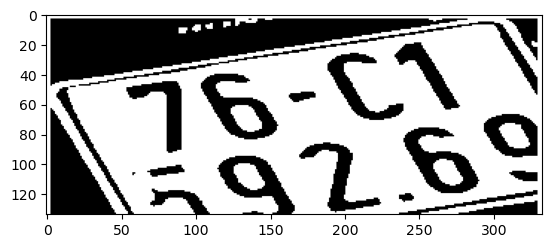

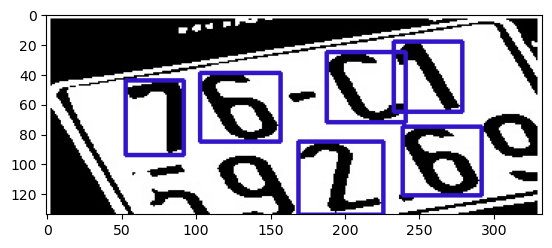

1/1 [==============================] - 0s 15ms/step


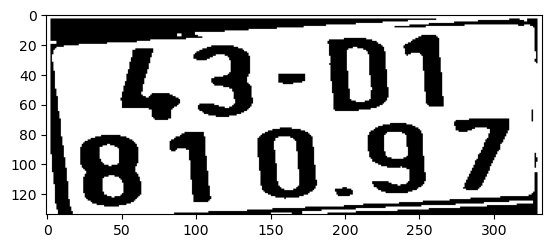

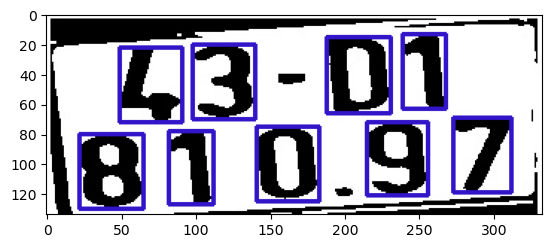

1/1 [==============================] - 0s 18ms/step


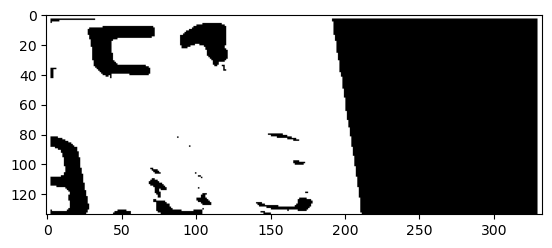

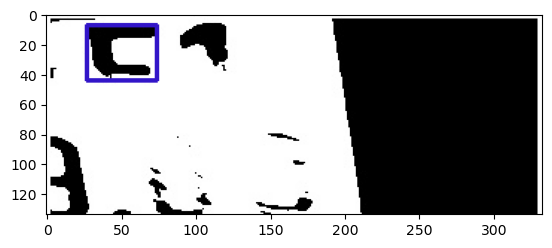

1/1 [==============================] - 0s 9ms/step


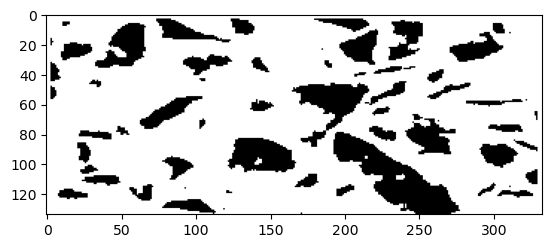

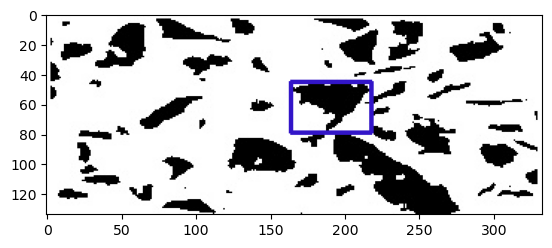

1/1 [==============================] - 0s 10ms/step


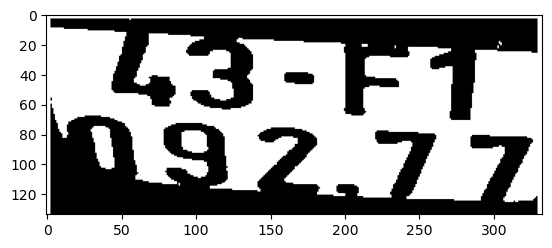

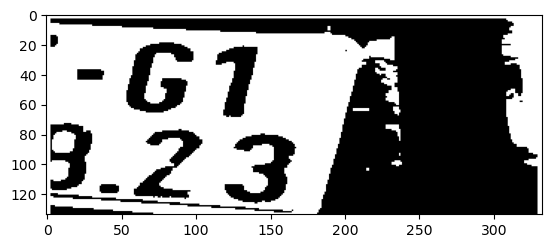

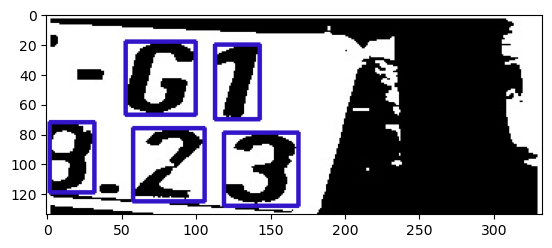

1/1 [==============================] - 0s 20ms/step


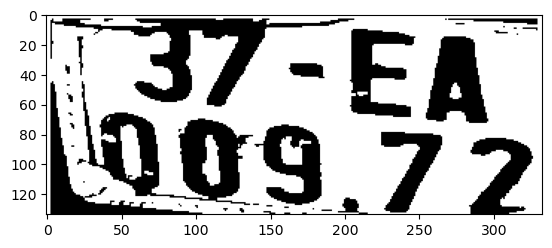

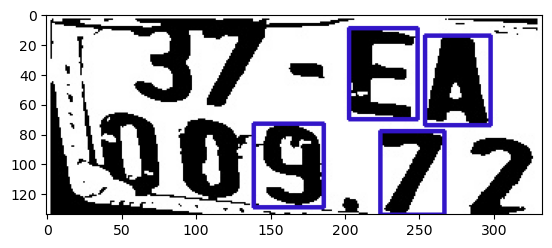

1/1 [==============================] - 0s 19ms/step


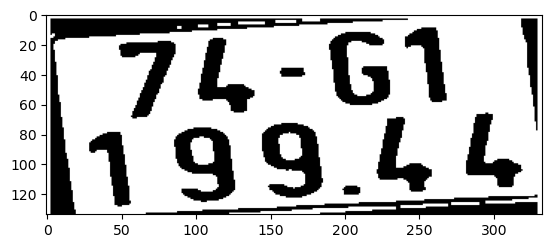

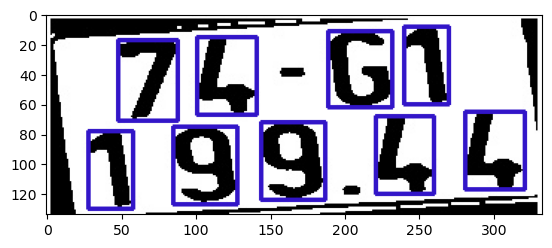

1/1 [==============================] - 0s 6ms/step


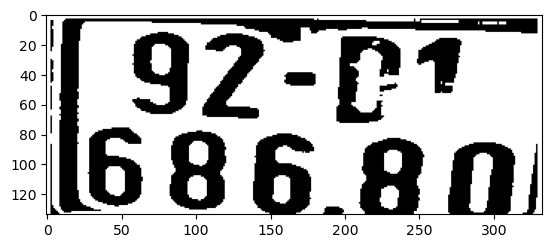

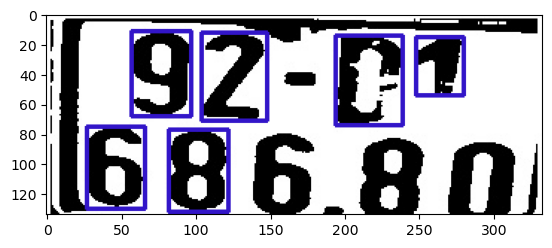

1/1 [==============================] - 0s 5ms/step


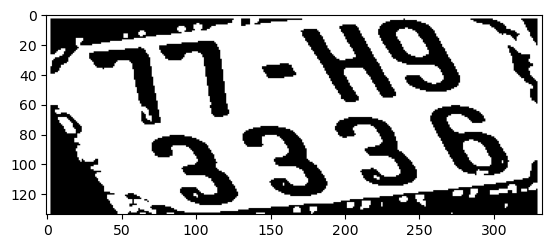

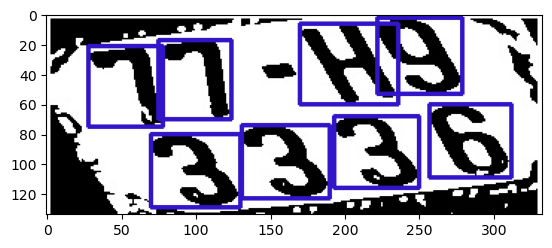

1/1 [==============================] - 0s 18ms/step


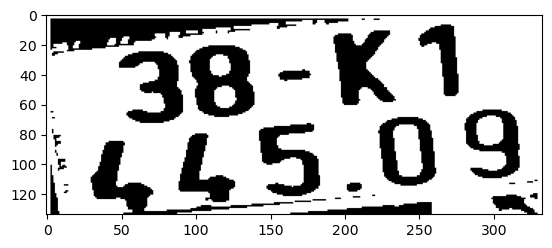

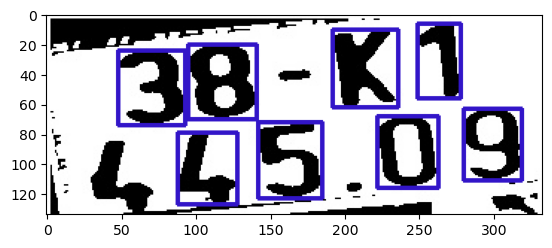

1/1 [==============================] - 0s 19ms/step


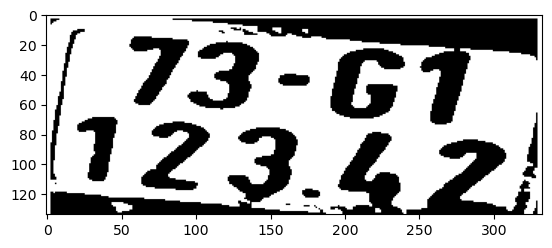

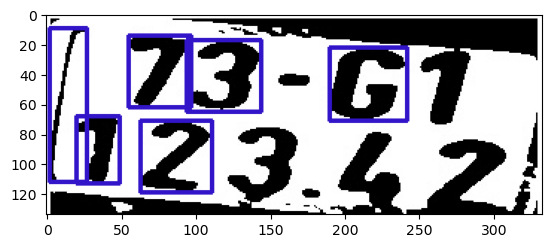

1/1 [==============================] - 0s 17ms/step


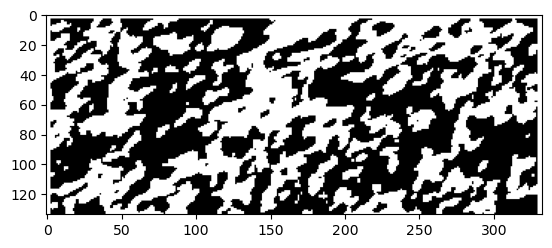

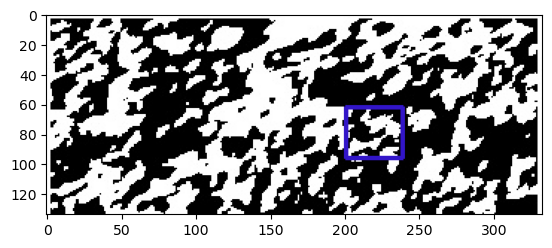

1/1 [==============================] - 0s 16ms/step


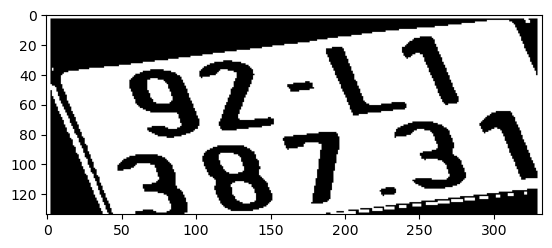

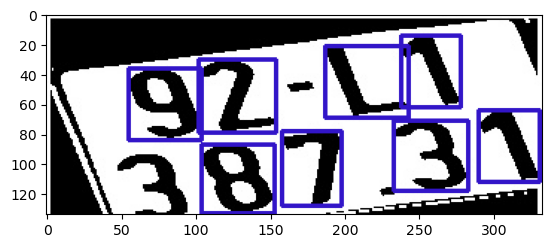

1/1 [==============================] - 0s 16ms/step


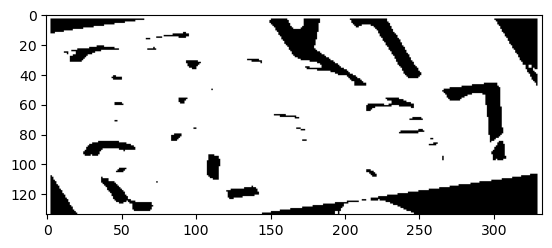

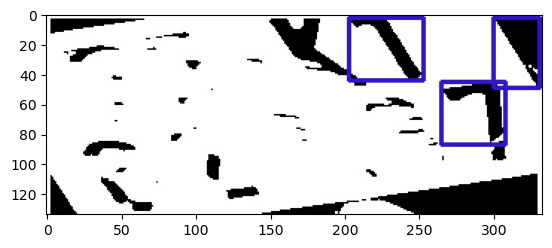

1/1 [==============================] - 0s 12ms/step


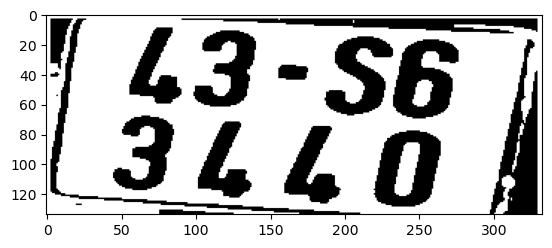

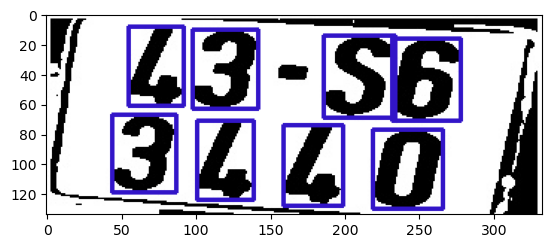

1/1 [==============================] - 0s 18ms/step


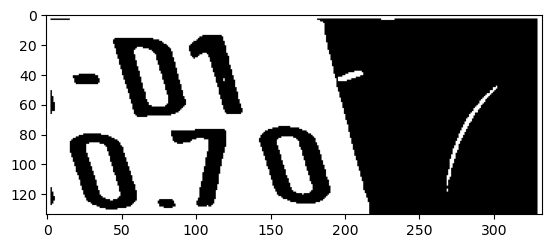

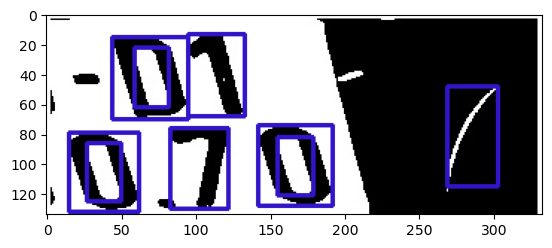

1/1 [==============================] - 0s 17ms/step


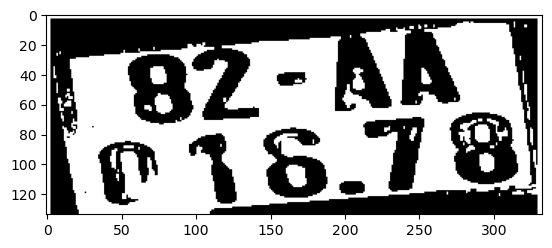

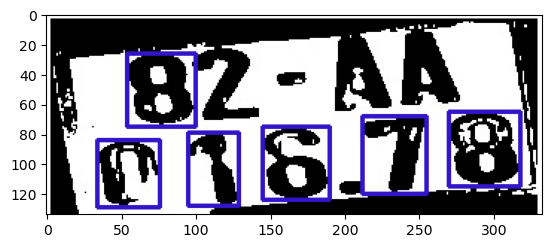

1/1 [==============================] - 0s 18ms/step


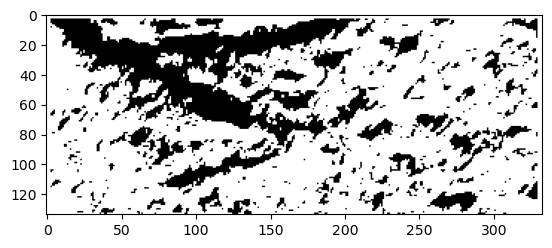

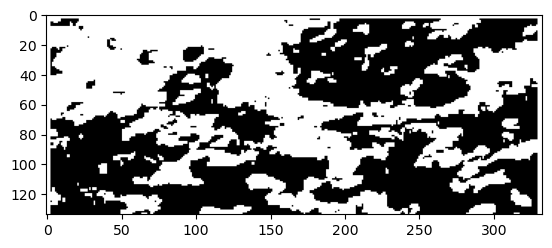

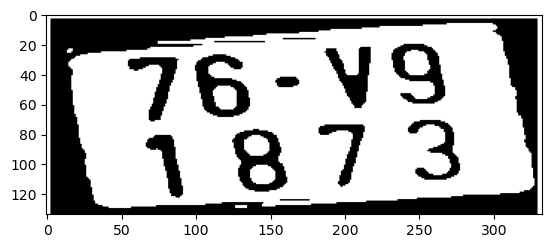

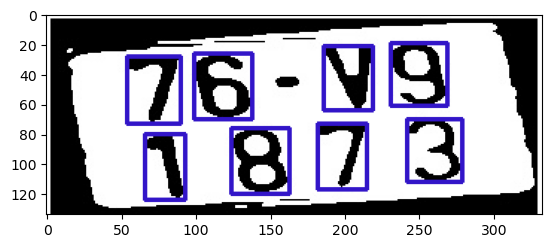

1/1 [==============================] - 0s 12ms/step


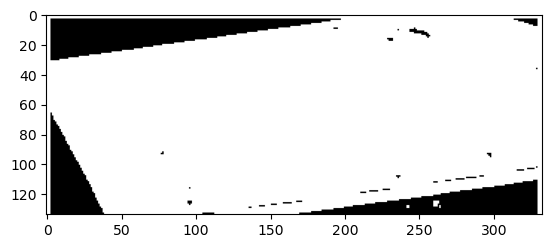

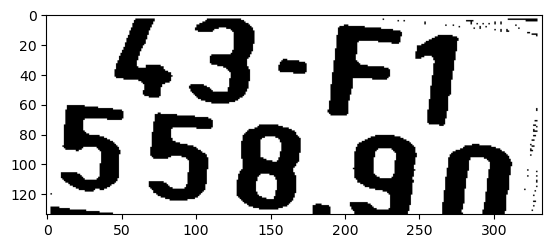

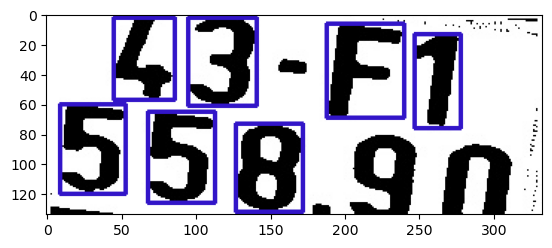

1/1 [==============================] - 0s 11ms/step


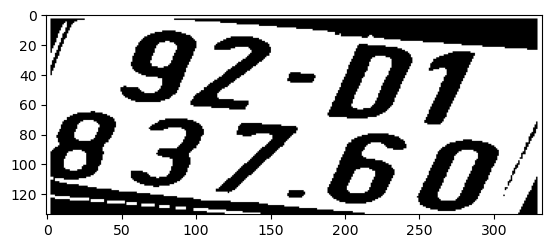

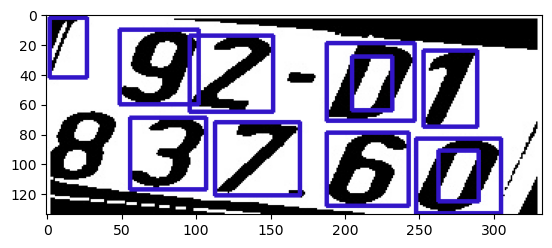

1/1 [==============================] - 0s 11ms/step


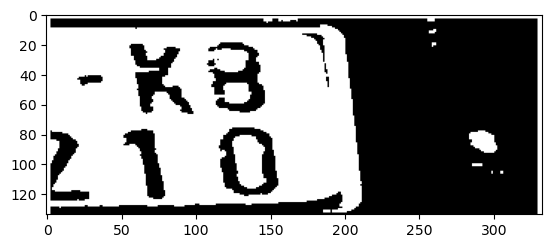

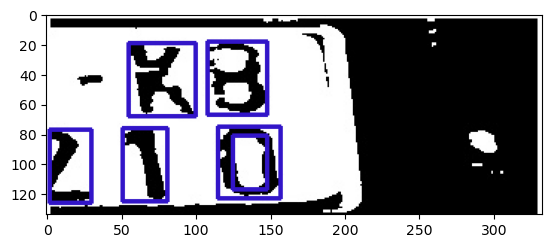

1/1 [==============================] - 0s 18ms/step


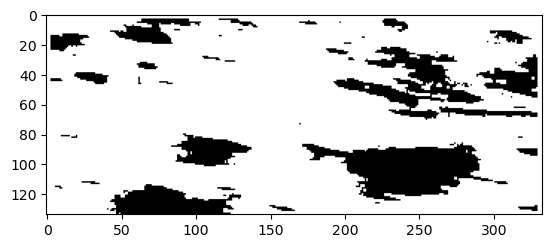

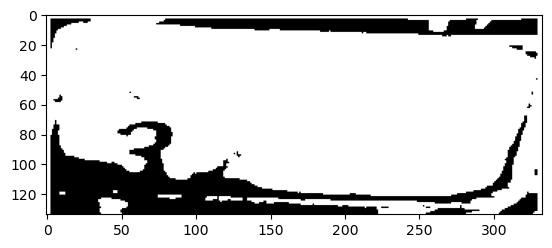

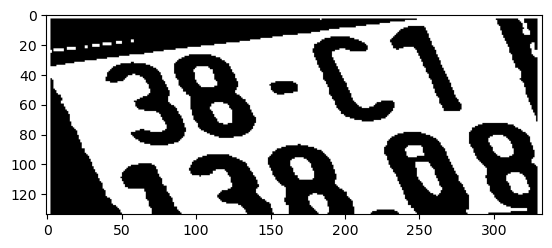

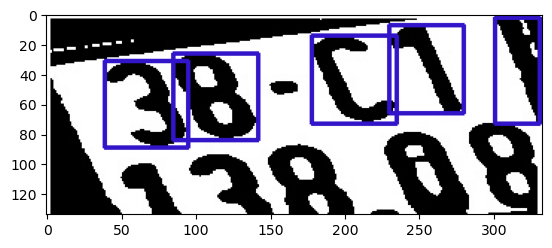

1/1 [==============================] - 0s 12ms/step


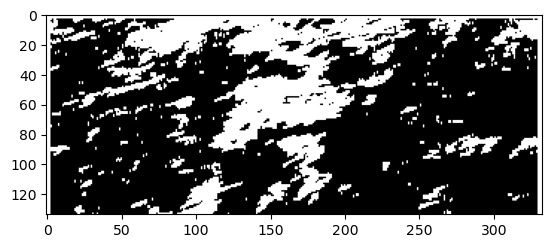

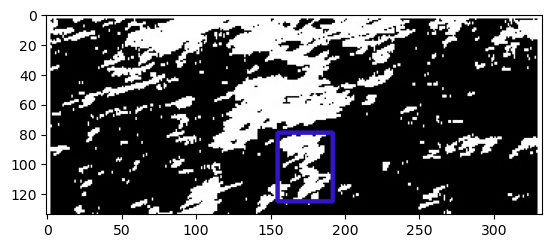

1/1 [==============================] - 0s 8ms/step


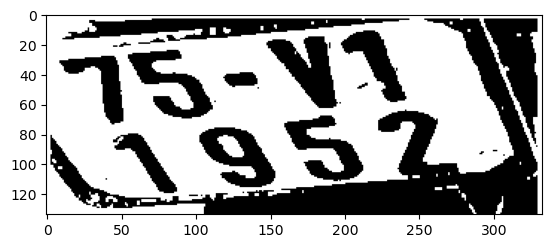

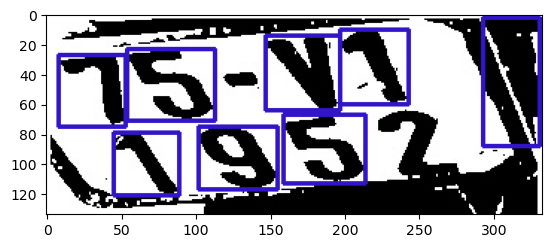

1/1 [==============================] - 0s 8ms/step


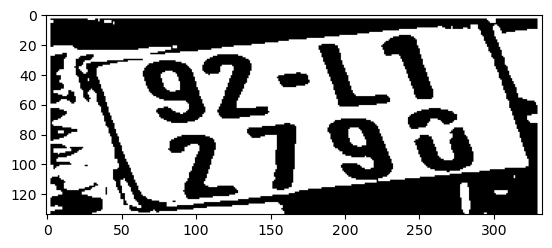

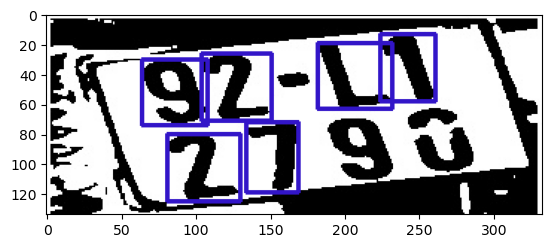

1/1 [==============================] - 0s 19ms/step


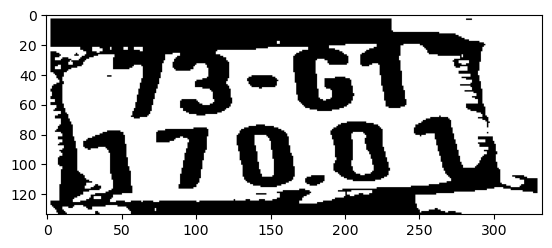

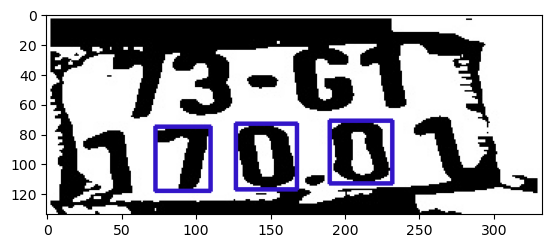

1/1 [==============================] - 0s 18ms/step


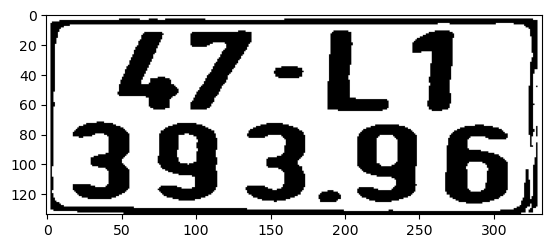

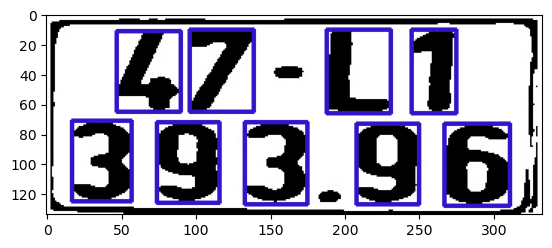

1/1 [==============================] - 0s 18ms/step
47L139396


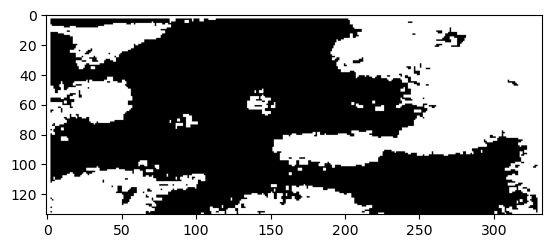

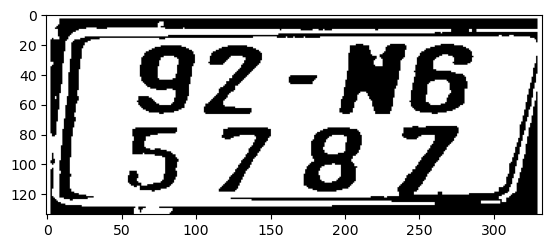

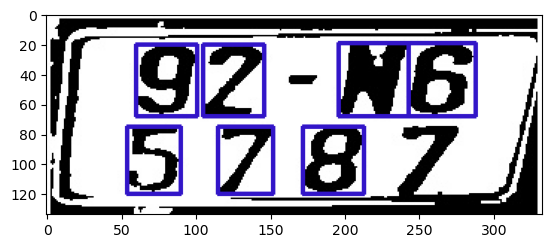

1/1 [==============================] - 0s 12ms/step


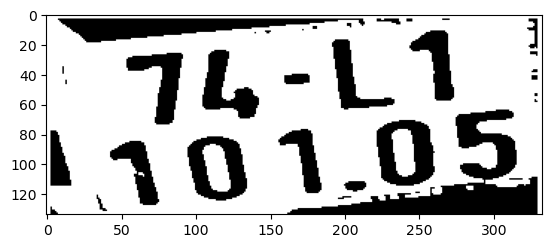

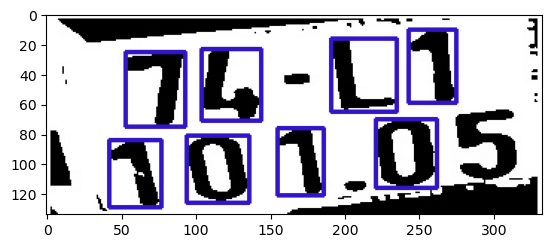

1/1 [==============================] - 0s 8ms/step


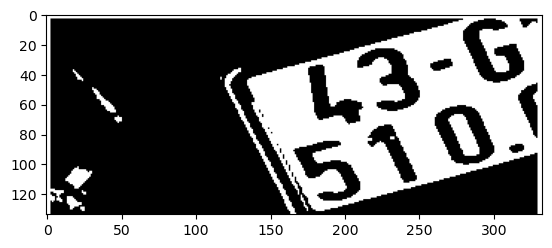

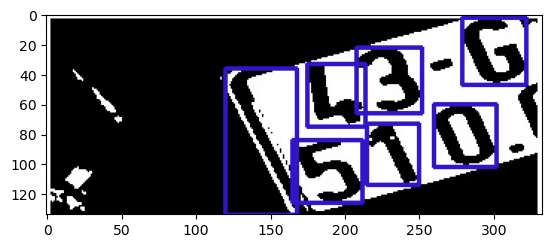

1/1 [==============================] - 0s 7ms/step


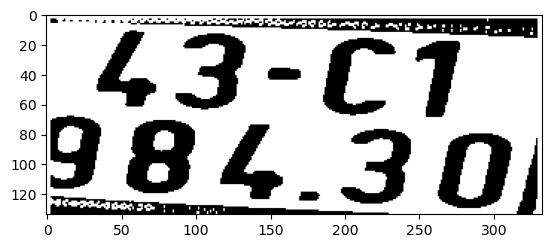

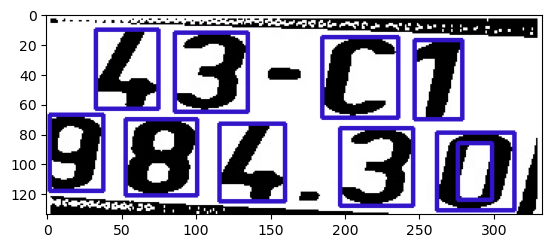

1/1 [==============================] - 0s 19ms/step


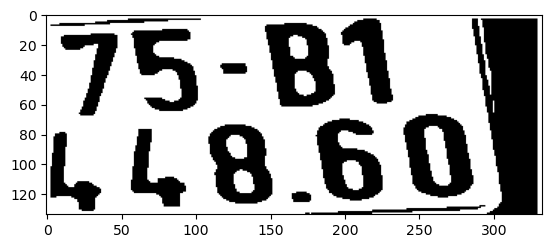

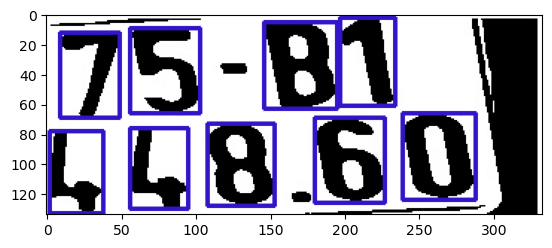

1/1 [==============================] - 0s 9ms/step


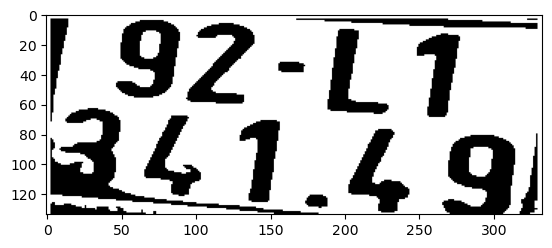

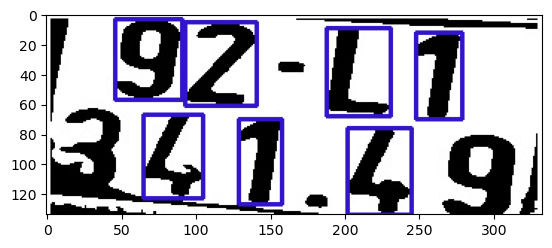

1/1 [==============================] - 0s 23ms/step


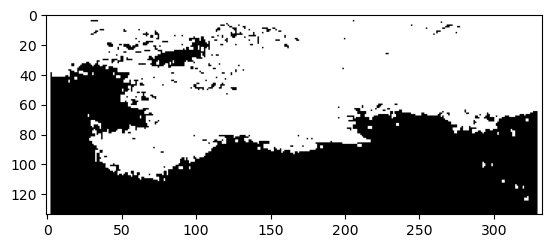

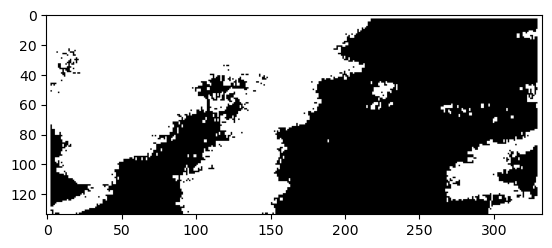

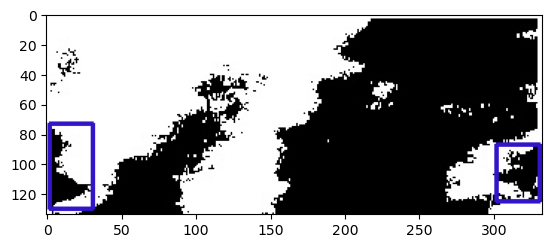

1/1 [==============================] - 0s 7ms/step


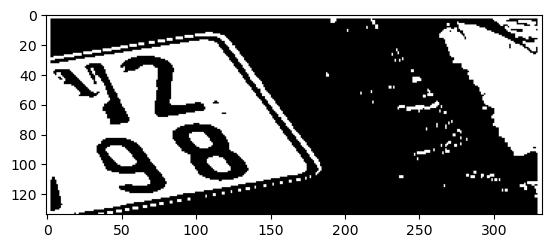

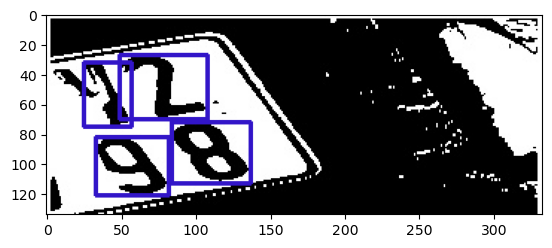

1/1 [==============================] - 0s 19ms/step


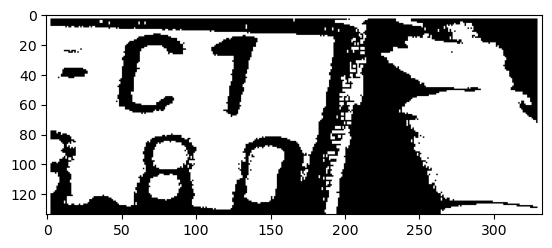

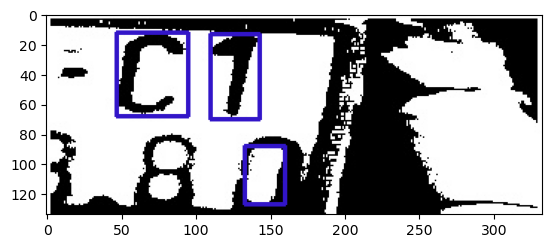

1/1 [==============================] - 0s 15ms/step


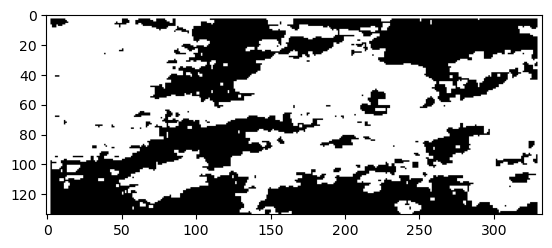

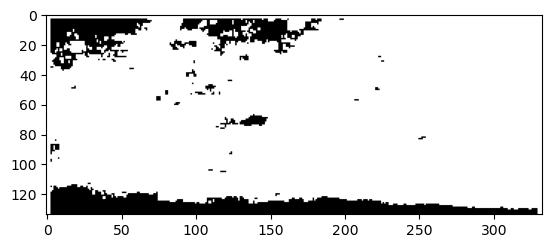

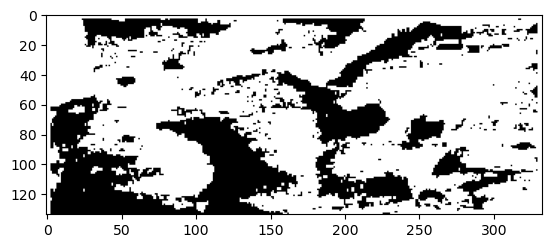

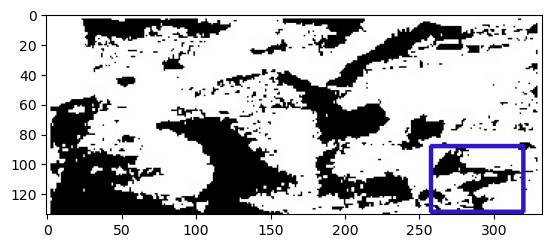

1/1 [==============================] - 0s 9ms/step


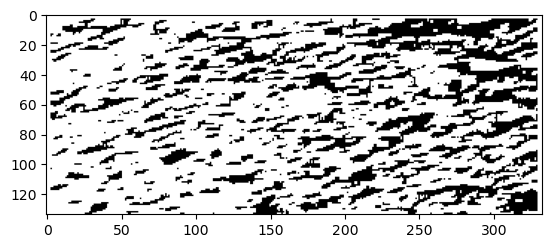

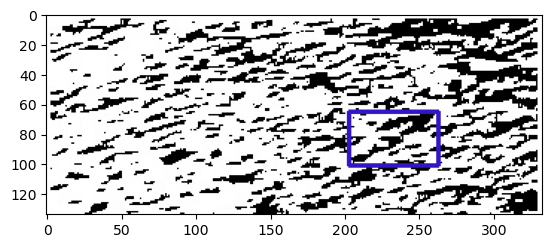

1/1 [==============================] - 0s 30ms/step


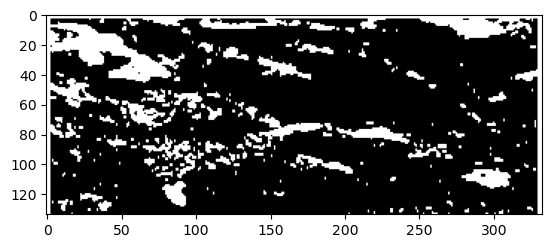

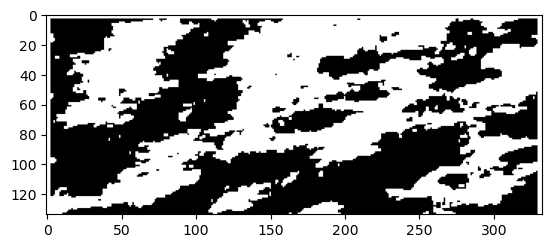

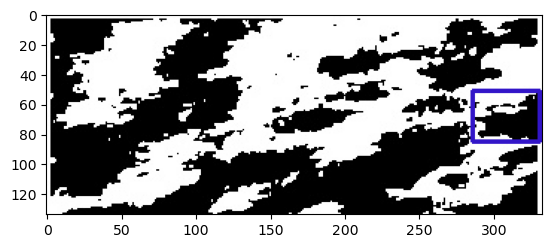

1/1 [==============================] - 0s 17ms/step


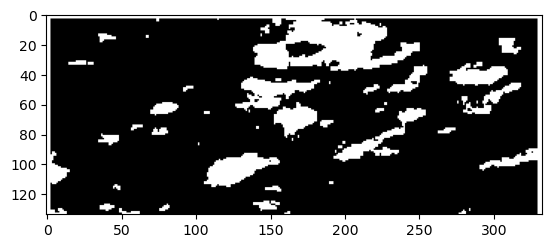

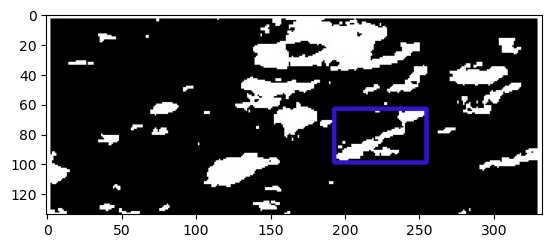

1/1 [==============================] - 0s 9ms/step


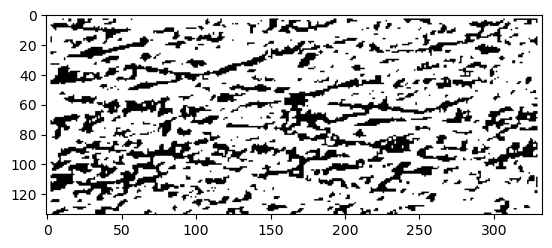

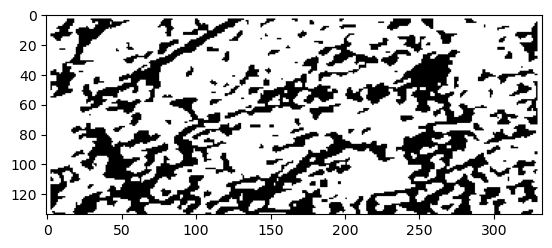

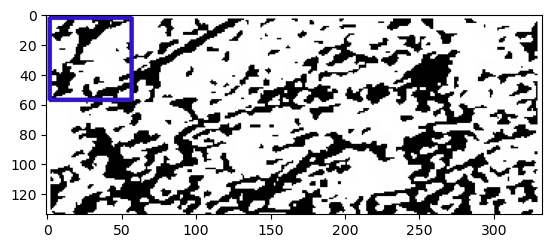

1/1 [==============================] - 0s 16ms/step


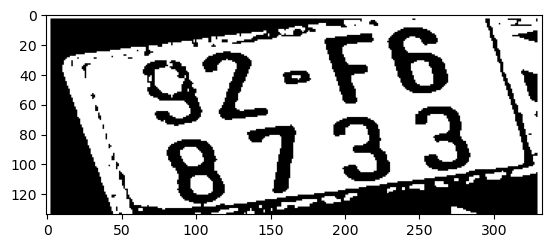

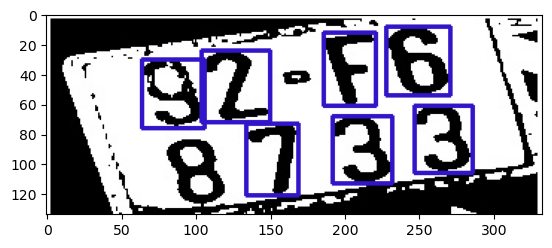

1/1 [==============================] - 0s 18ms/step


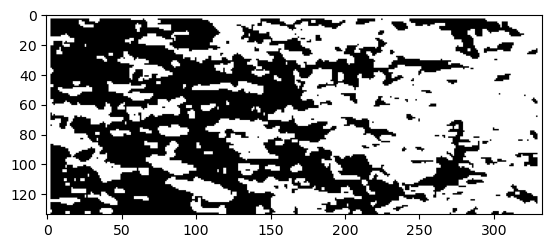

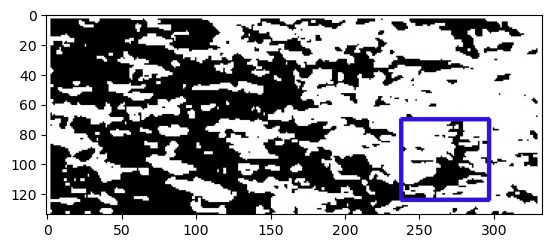

1/1 [==============================] - 0s 10ms/step


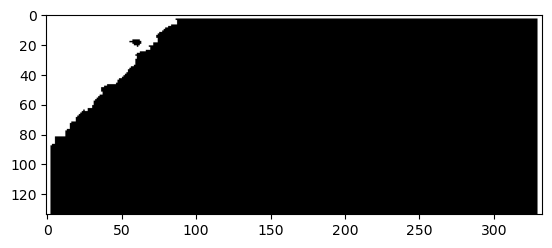

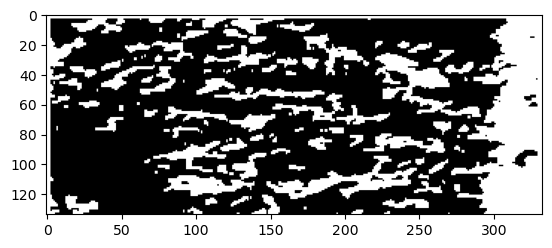

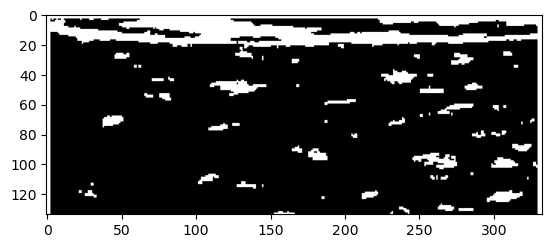

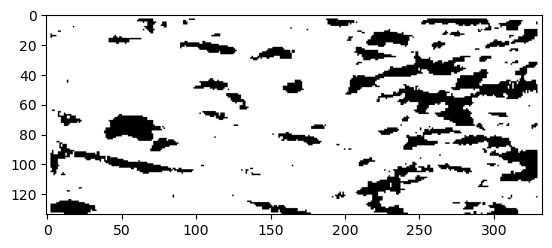

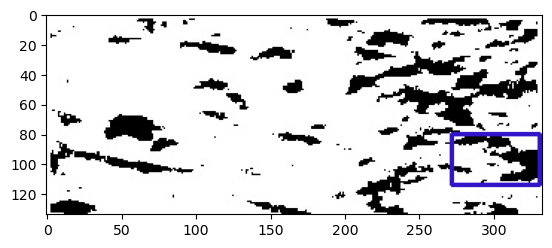

1/1 [==============================] - 0s 15ms/step


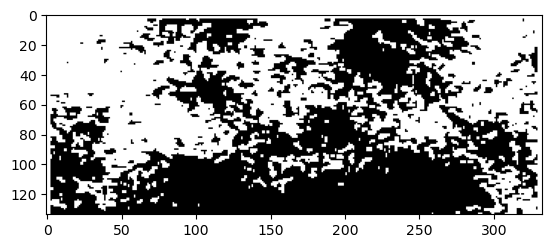

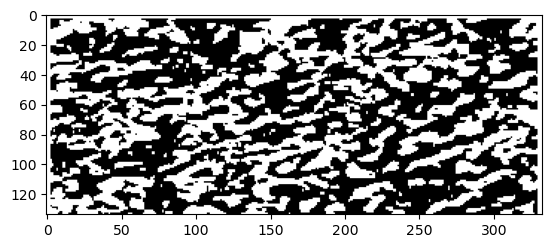

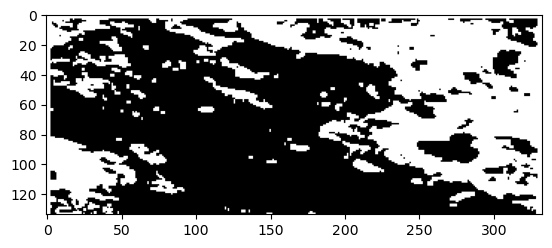

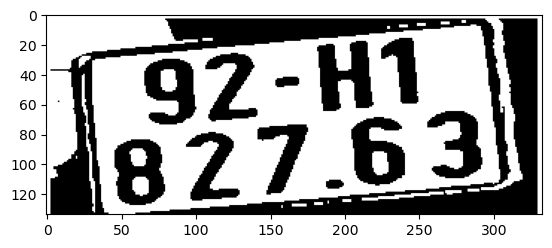

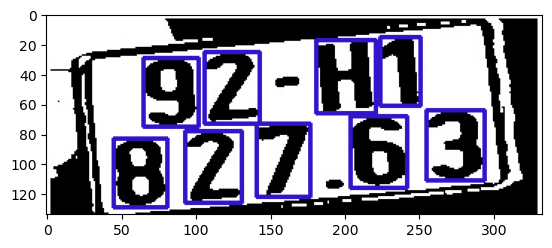

1/1 [==============================] - 0s 5ms/step


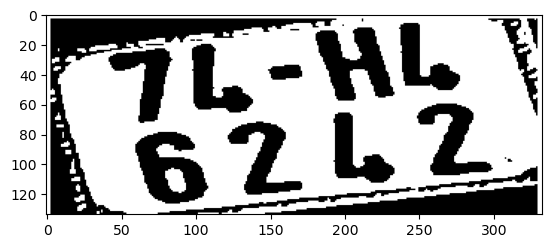

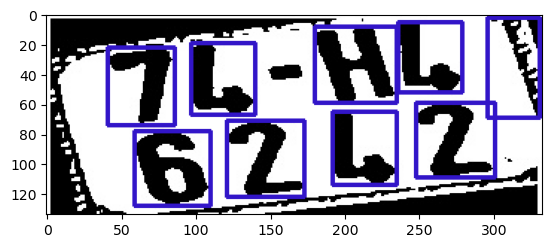

1/1 [==============================] - 0s 19ms/step


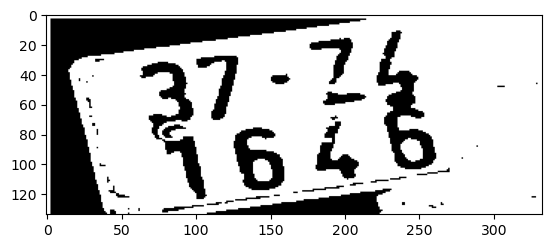

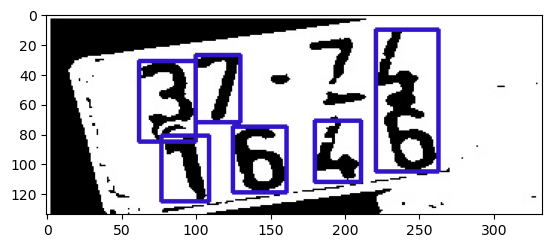

1/1 [==============================] - 0s 20ms/step


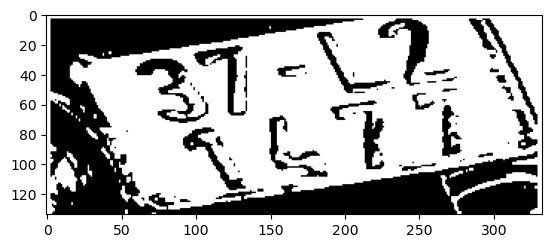

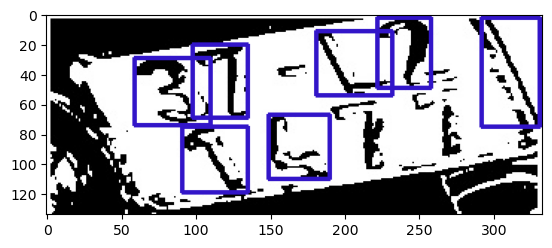

1/1 [==============================] - 0s 5ms/step


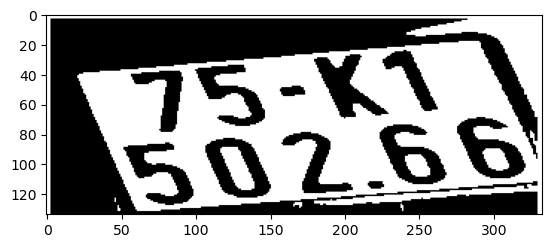

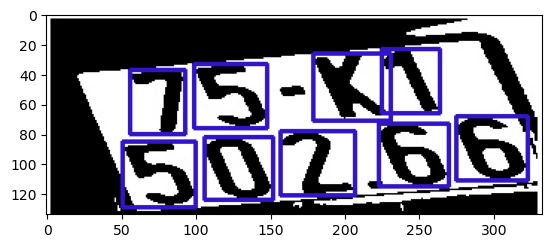

1/1 [==============================] - 0s 19ms/step


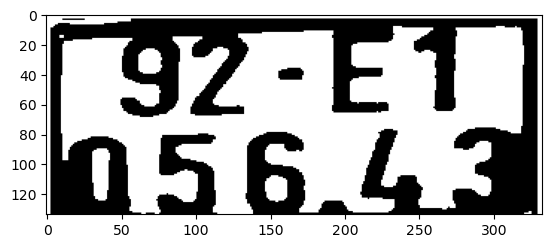

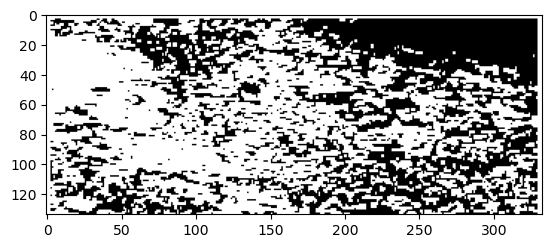

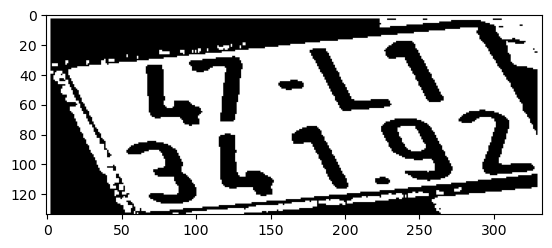

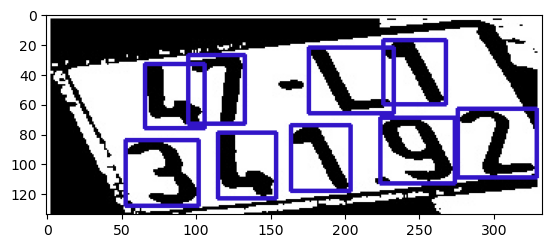

1/1 [==============================] - 0s 5ms/step


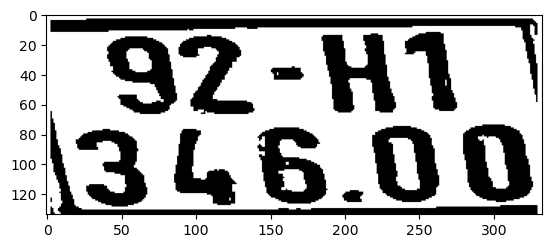

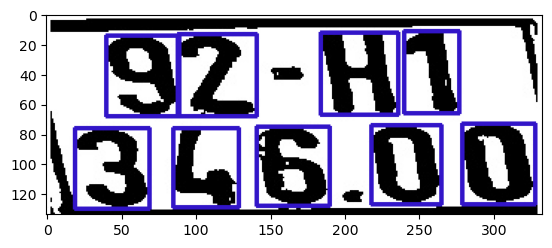

1/1 [==============================] - 0s 8ms/step


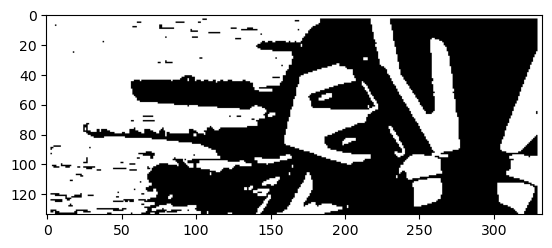

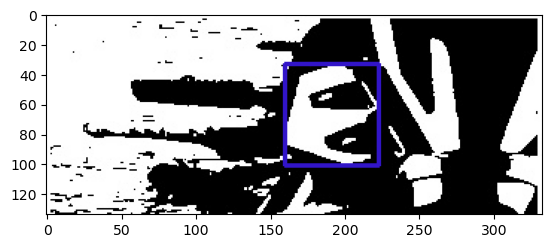

1/1 [==============================] - 0s 10ms/step


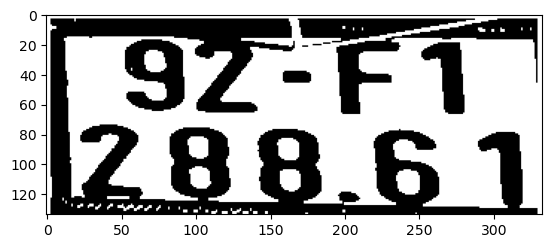

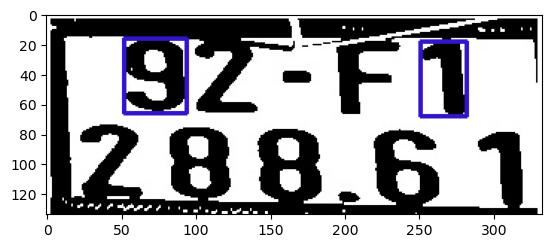

1/1 [==============================] - 0s 16ms/step


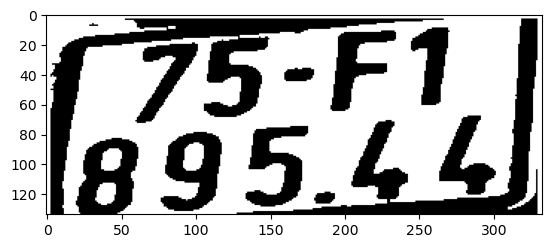

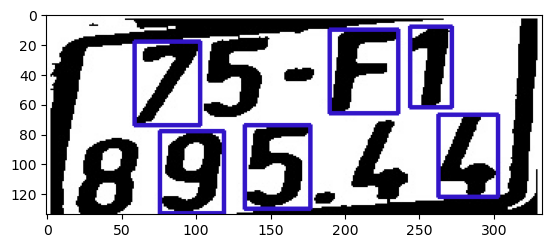

1/1 [==============================] - 0s 16ms/step


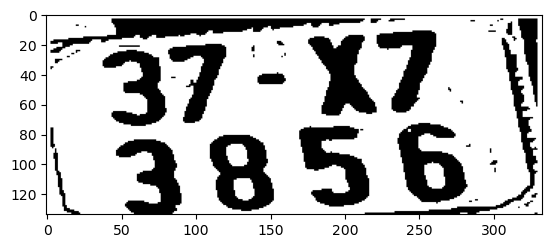

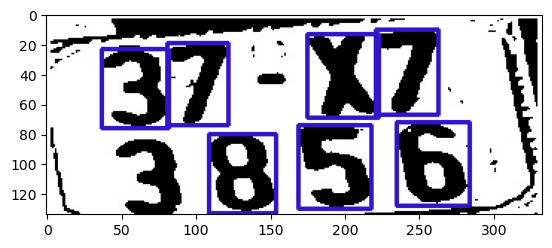

1/1 [==============================] - 0s 5ms/step


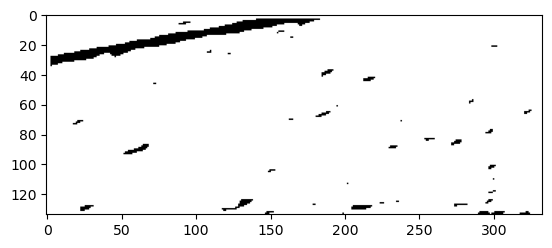

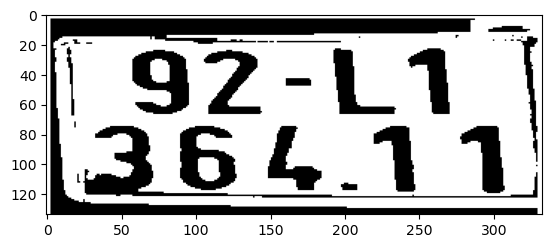

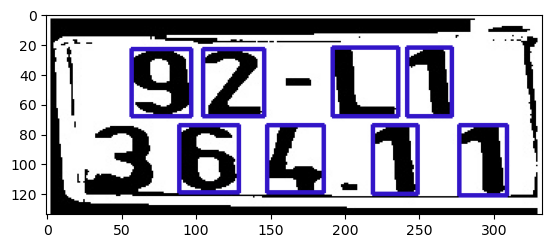

1/1 [==============================] - 0s 19ms/step


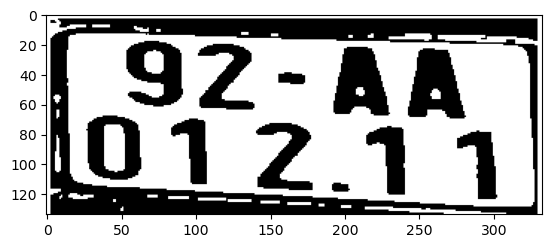

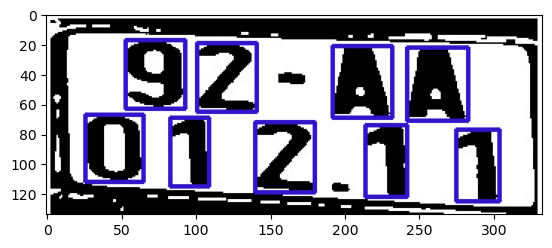

1/1 [==============================] - 0s 19ms/step


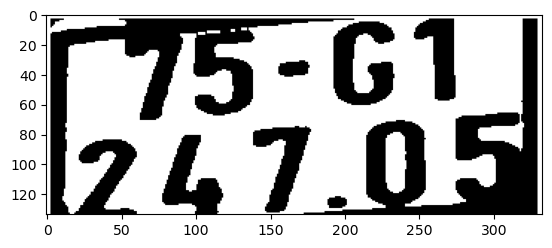

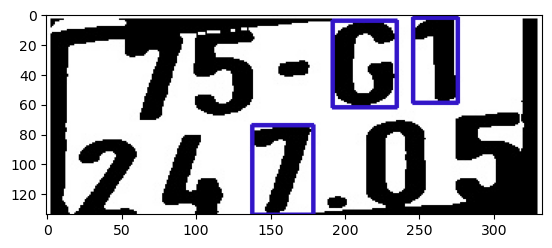

1/1 [==============================] - 0s 18ms/step


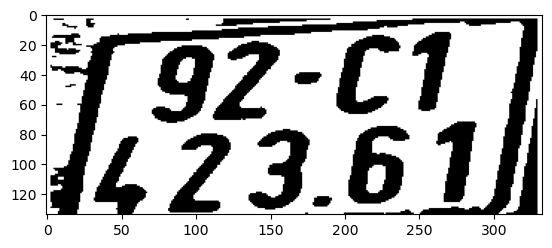

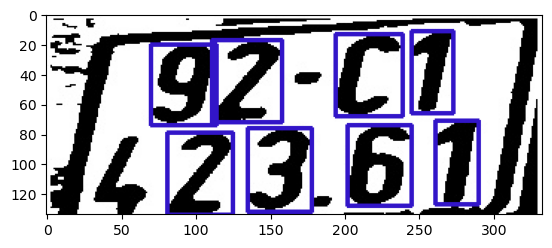

1/1 [==============================] - 0s 7ms/step


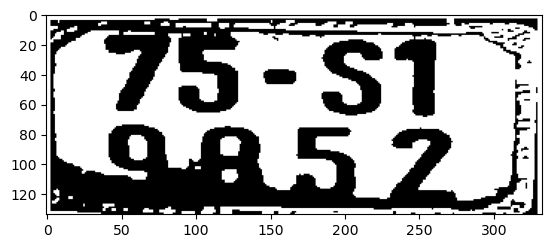

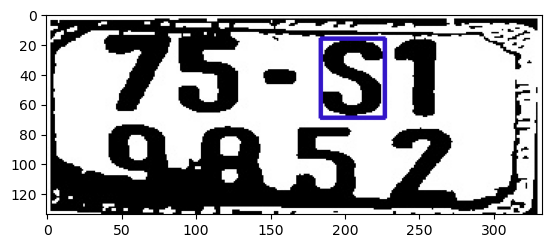

1/1 [==============================] - 0s 19ms/step


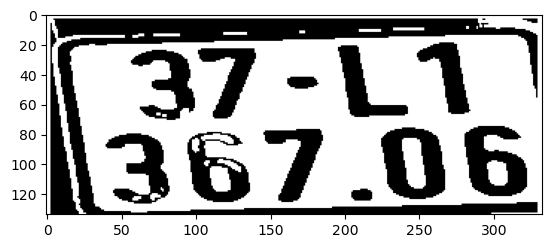

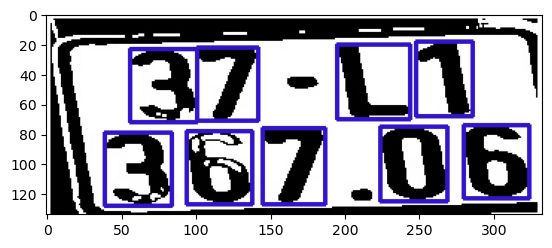

1/1 [==============================] - 0s 20ms/step
37L136706


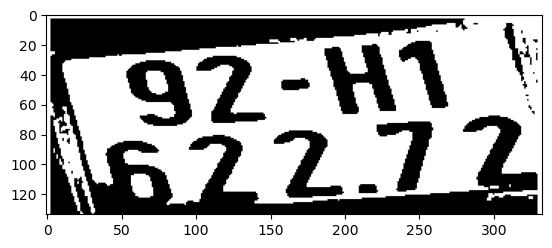

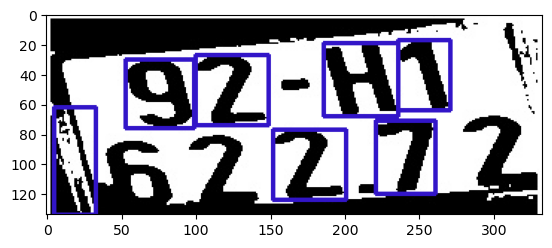

1/1 [==============================] - 0s 6ms/step


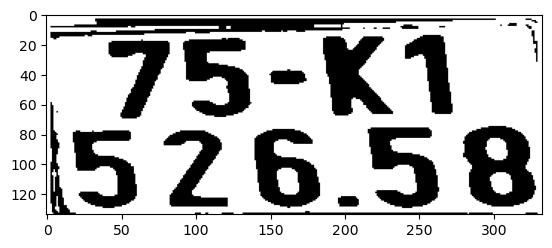

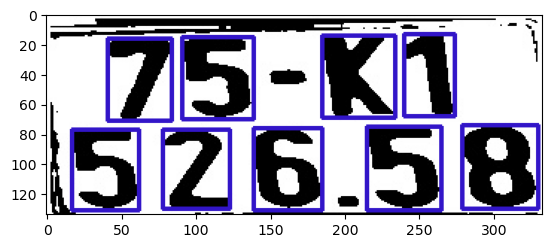

1/1 [==============================] - 0s 19ms/step


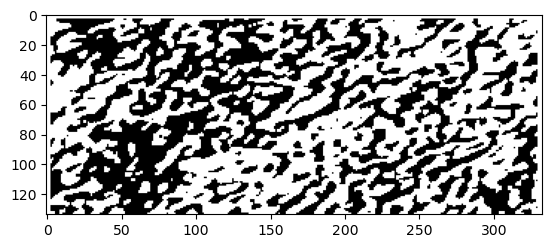

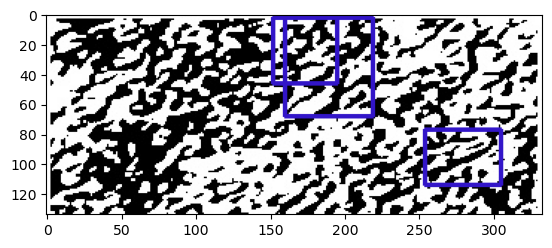

1/1 [==============================] - 0s 12ms/step


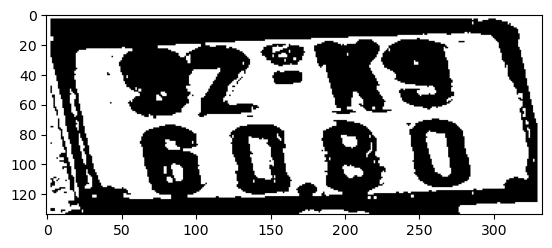

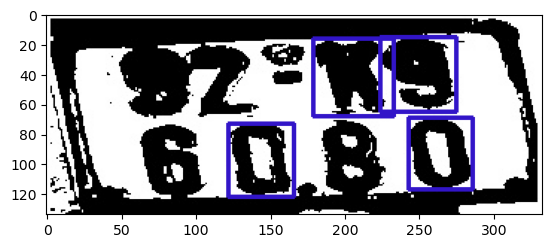

1/1 [==============================] - 0s 19ms/step


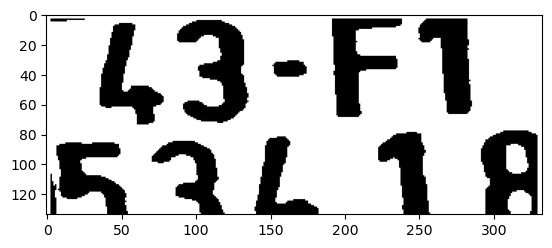

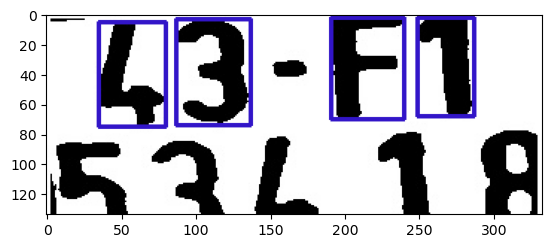

1/1 [==============================] - 0s 26ms/step


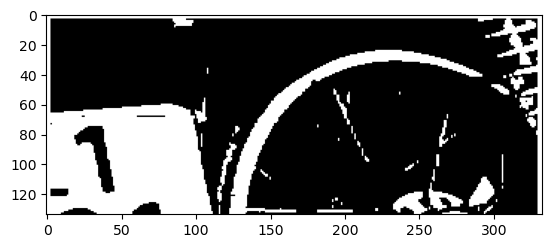

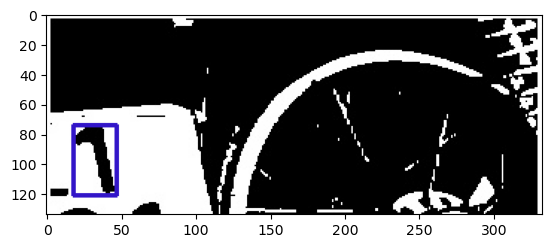

1/1 [==============================] - 0s 20ms/step


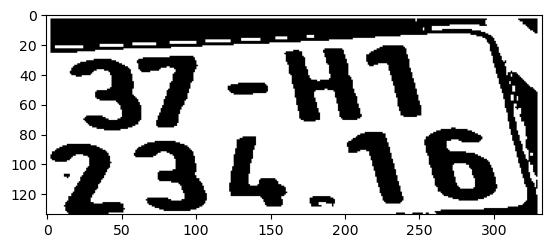

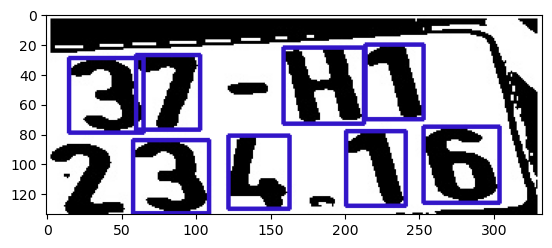

1/1 [==============================] - 0s 29ms/step


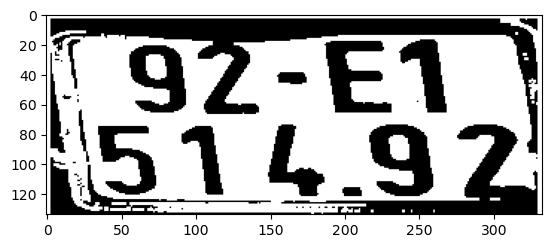

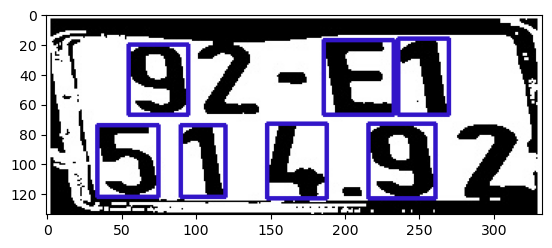

1/1 [==============================] - 0s 20ms/step


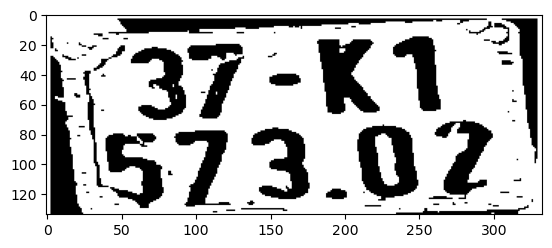

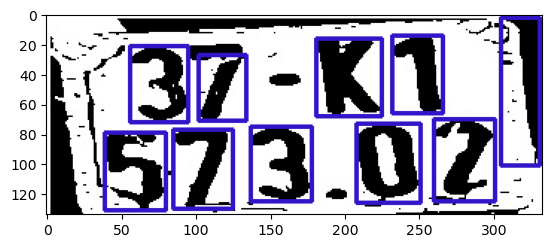

1/1 [==============================] - 0s 19ms/step


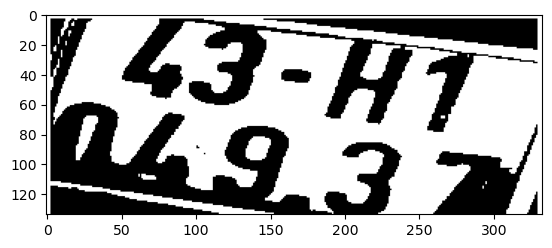

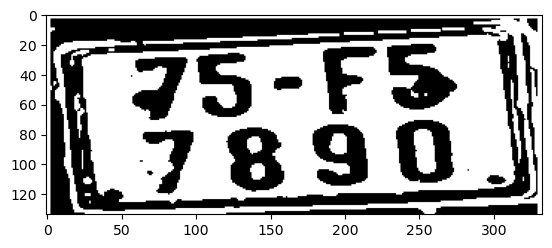

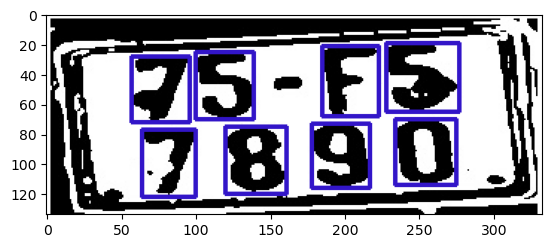

1/1 [==============================] - 0s 11ms/step


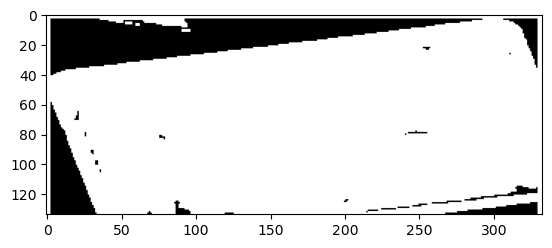

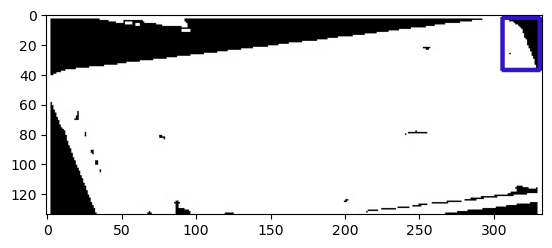

1/1 [==============================] - 0s 14ms/step


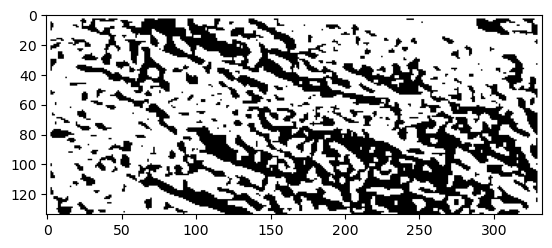

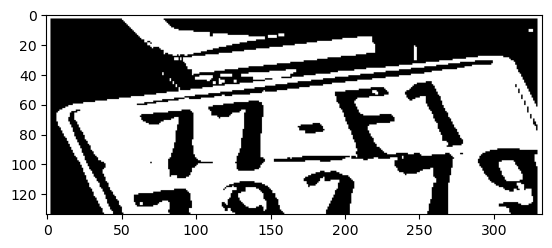

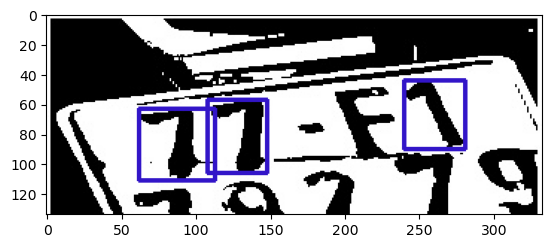

1/1 [==============================] - 0s 21ms/step


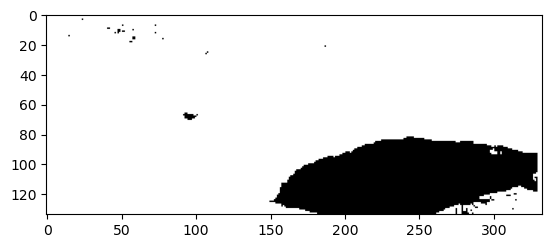

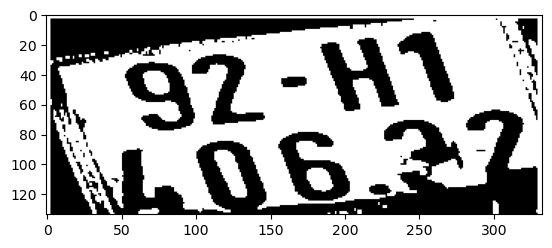

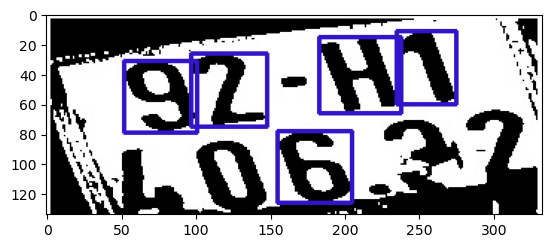

1/1 [==============================] - 0s 15ms/step


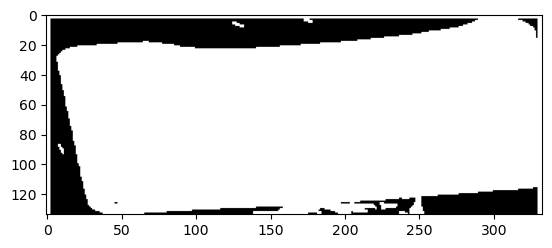

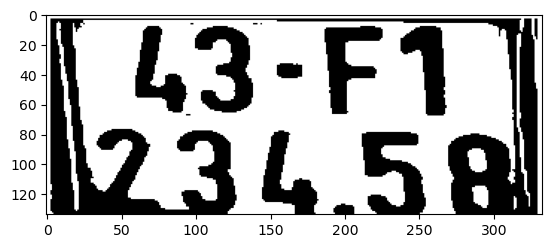

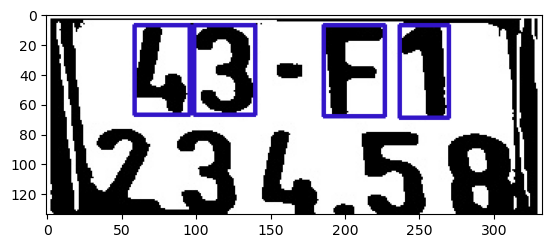

1/1 [==============================] - 0s 18ms/step


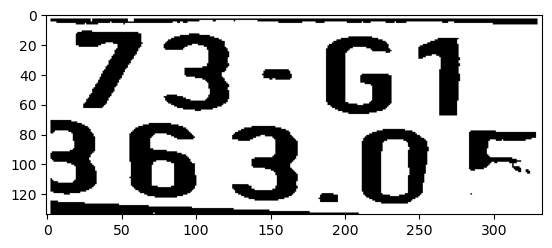

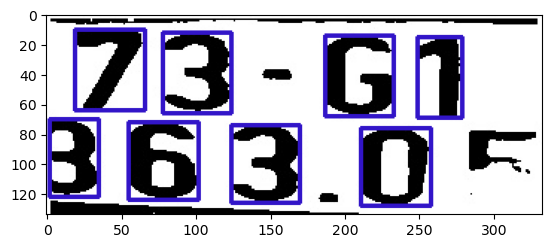

1/1 [==============================] - 0s 15ms/step


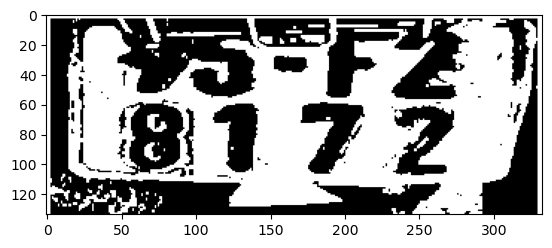

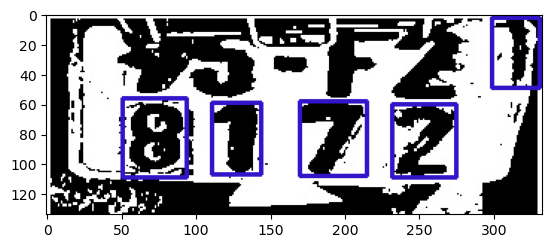

1/1 [==============================] - 0s 18ms/step


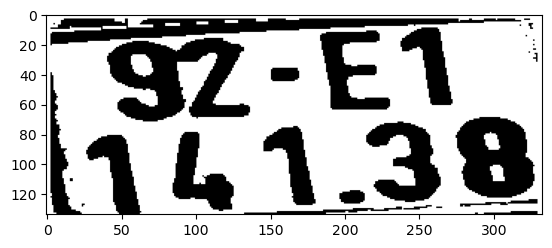

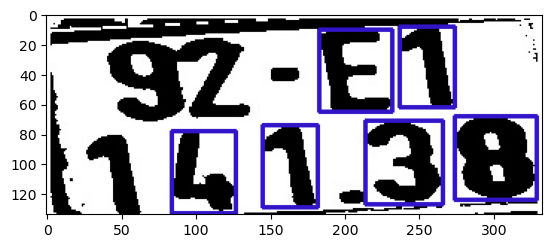

1/1 [==============================] - 0s 7ms/step


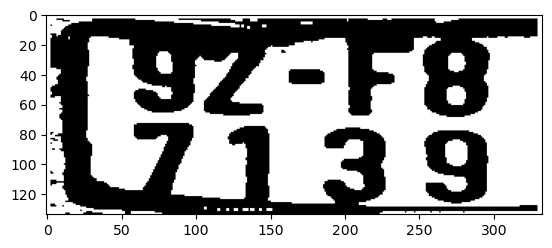

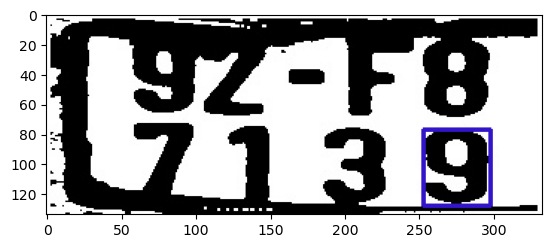

1/1 [==============================] - 0s 5ms/step


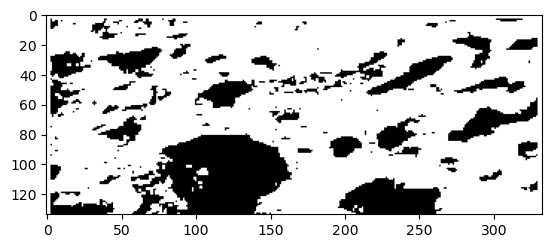

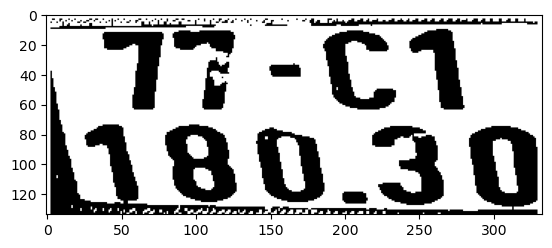

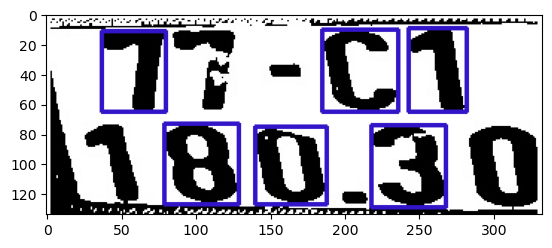

1/1 [==============================] - 0s 18ms/step


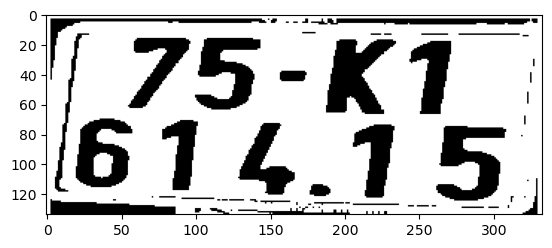

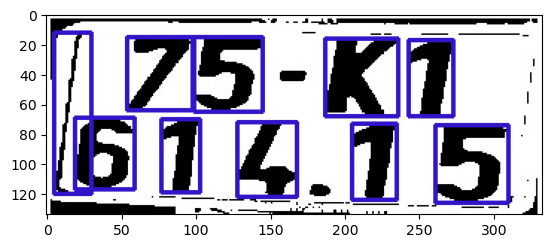

1/1 [==============================] - 0s 10ms/step


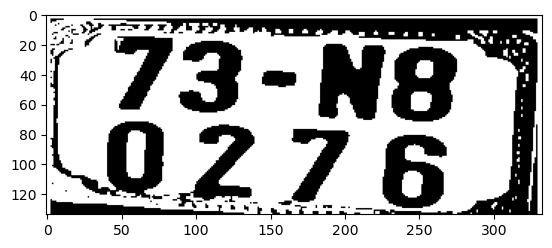

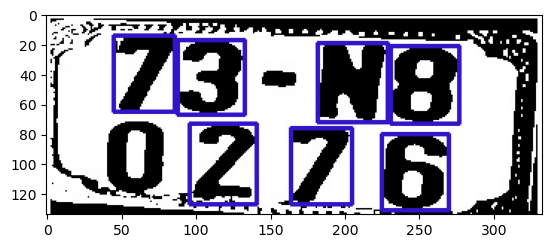

1/1 [==============================] - 0s 15ms/step


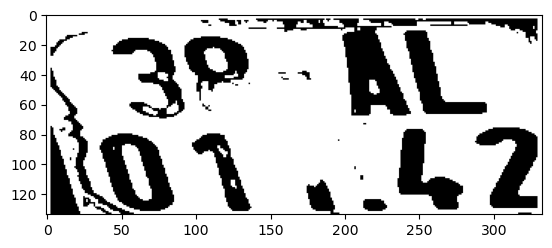

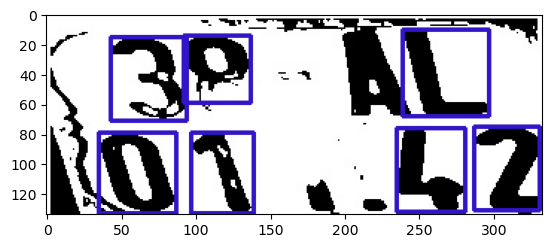

1/1 [==============================] - 0s 18ms/step


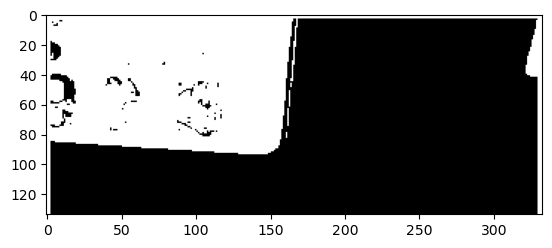

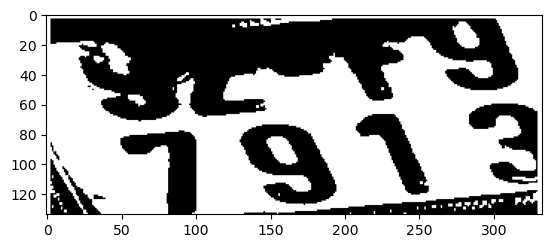

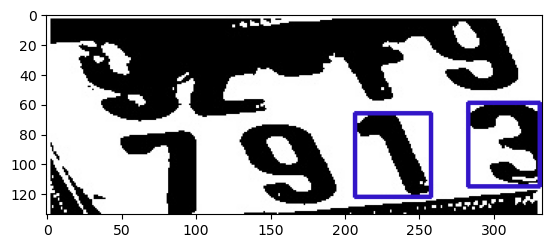

1/1 [==============================] - 0s 6ms/step


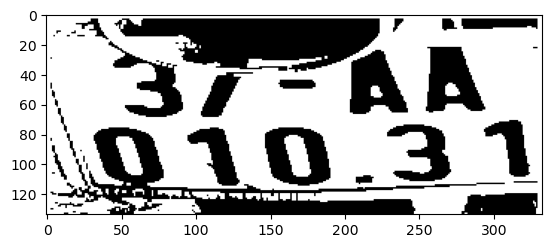

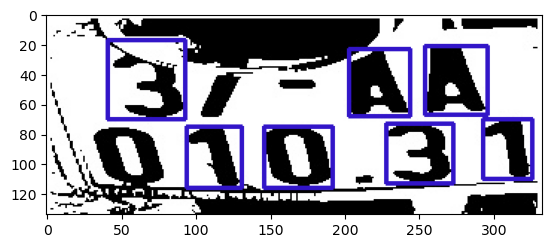

1/1 [==============================] - 0s 9ms/step


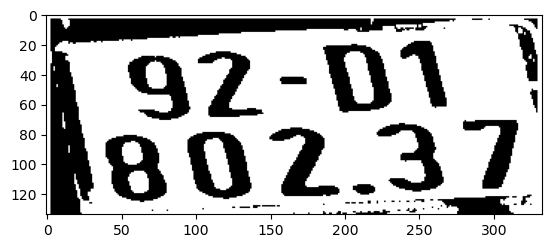

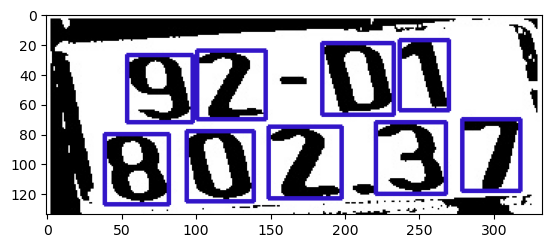

1/1 [==============================] - 0s 19ms/step


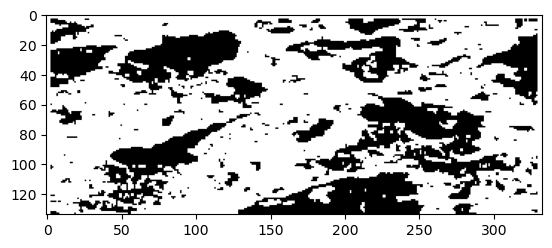

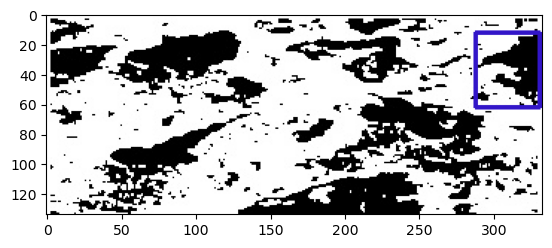

1/1 [==============================] - 0s 8ms/step


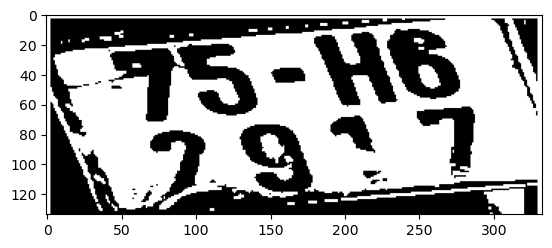

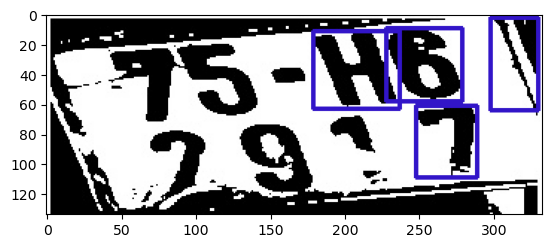

1/1 [==============================] - 0s 20ms/step


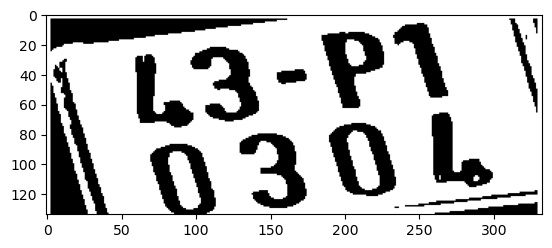

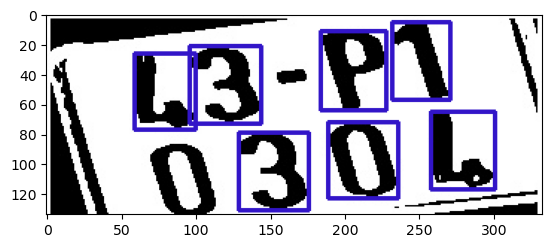

1/1 [==============================] - 0s 21ms/step


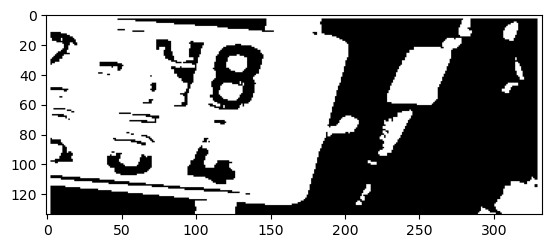

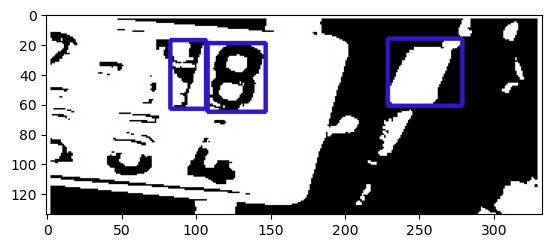

1/1 [==============================] - 0s 24ms/step


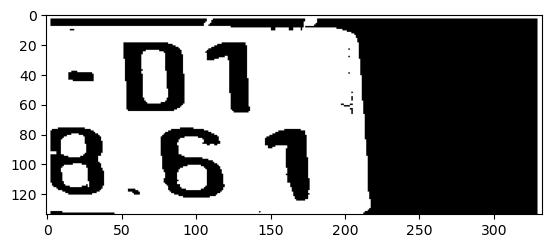

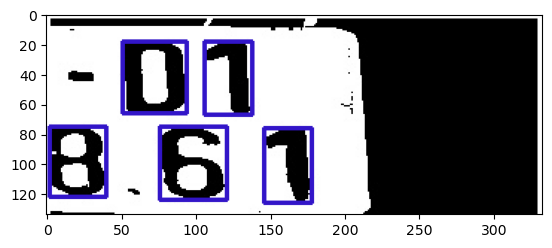

1/1 [==============================] - 0s 10ms/step


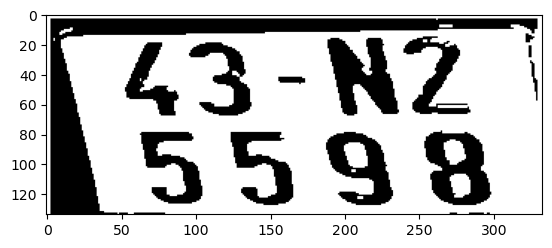

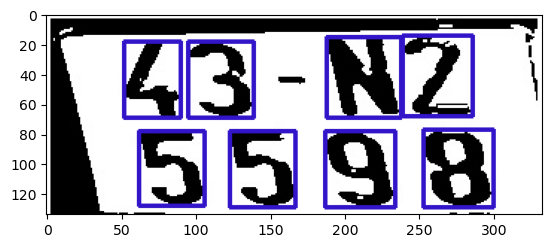

1/1 [==============================] - 0s 20ms/step


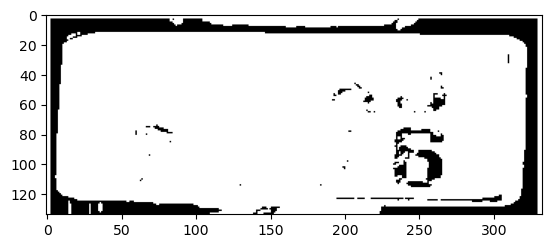

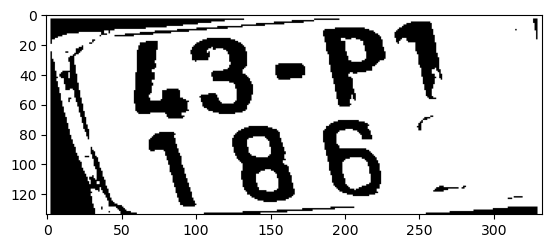

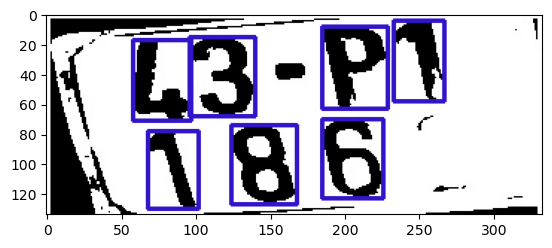

1/1 [==============================] - 0s 7ms/step


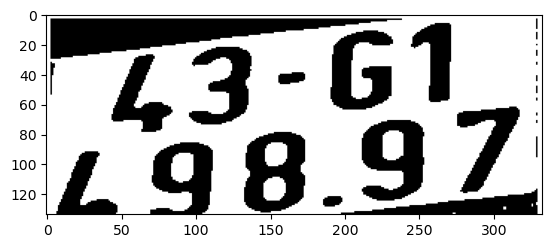

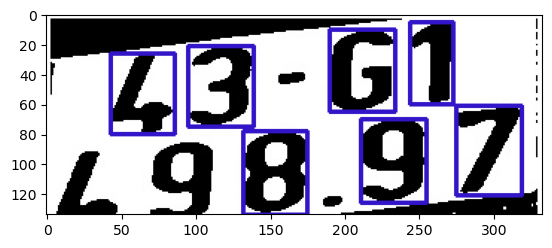

1/1 [==============================] - 0s 31ms/step


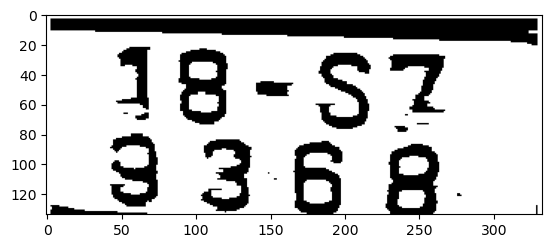

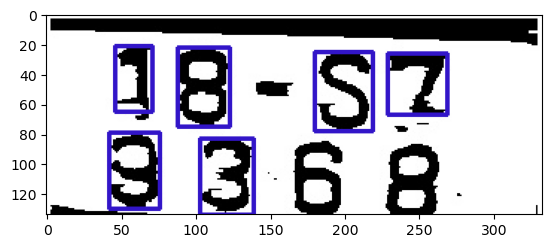

1/1 [==============================] - 0s 15ms/step


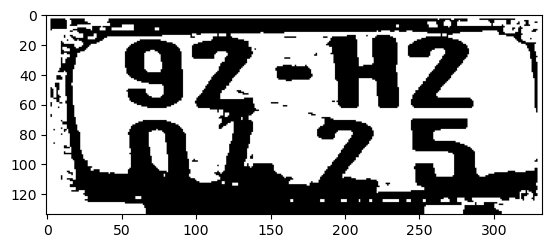

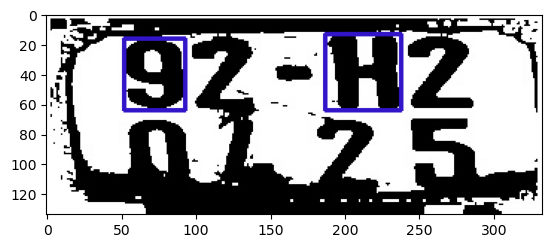

1/1 [==============================] - 0s 19ms/step


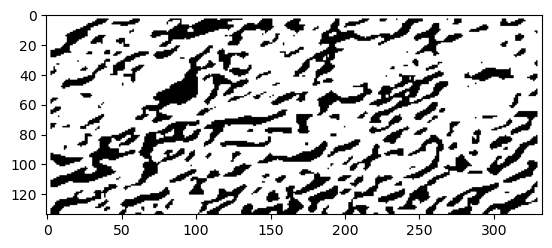

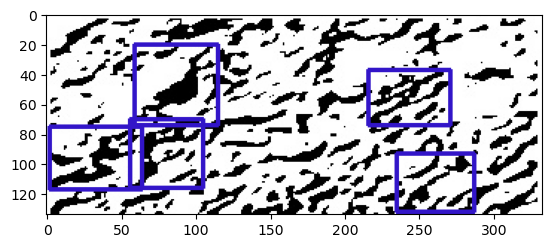

1/1 [==============================] - 0s 12ms/step


In [8]:
results = []
for image,label_file in zip(image_lists,label_lists):
    image_link = './plate/' + image
    predict = Plate_Number_Detect(image_link)
    with open('./text/' + label_file, 'r') as file:
        label = file.read()
    if predict == label:
        print(predict)
        results.append(1)
    else:
        results.append(0)

In [9]:
with open('./text/license_plate_1.txt', 'r') as file:
    label = file.read()

In [11]:
from statistics import mean

mean_value = mean(results)
print("Accuracy:", mean_value*100)

Accuracy: 1.627906976744186
